### CA1 – Data Visualisation Techniques HDip
#### Author: Cristhian Macedo - 2024104
[GitHub Repository](https://github.com/CCT-Dublin/data-visualisation-techniques-ca1-CristhianMacedo2024104)

# 1. Introduction

This project aims to complete the first Assessment Task for the module Data Visualisation Techniques from the course Higher Diploma in Science in Data Analytics for Business by CCT College Dublin, this is a document to describe the project itself whose name is “CristhianMacedo_DVizHDip_CA1.ipynb”. This Data Visualisation Techniques project uses the programming language Python, the environment of Anaconda Navigator with Jupyter Notebook, with CRISP-DM methodology as project management.

Note: 

For some reason, the Plotly graphs preview is not being displayed after uploading to the GitHub repository, so it would be advisable to download the document and open it, if this problem occurs, thank you.

Scenario:

You have been retained by a retail company to analyse a dataset based on video games. This analysis will
help determine the sales strategy for the company in their upcoming **Winter season**.

Each answer MUST have a separate and different visualization that can be easily understood, visually
represents the answer, and all data wrangling, analysis, and visualizations must be generated using python.
The companies CTO also requires you to rationalize all the decisions that you have made in your Jupyter
Notebook report.

This rationalization MUST include your visualization design decisions, how you have engineered the data,
feature selection and any other information that you deem relevant.

# 2. Data Understanding

This first stage will cover some approaches to understanding the database, first importing the libraries such as pandas to manipulate the data, loading the database and setting in a Data Frame variable called "`df`", inspecting the data frame to get the head, shape, info, describe, is null, and so on, to understand the size of the data frame, to get information as how many features and observations there exist, also whether have or not missing values and so on, getting an overview for the next steps, also reading the Data Dictionary to be more familiar with the values.

## 2.1 Importing Libraries

Starting to import some libraries such as "`pandas`" to start the project and "`warnings`" to suppress the warnings using a filter of warnings "`warnings.filterwarnings("ignore")`", other libraries will be added at the body of the notebook once needed it with a description.

In [1]:
import pandas as pd

import warnings
warnings.filterwarnings("ignore")

## 2.2 Loading Data 

Creating a Data Frame named "`df`" after loading the data set "`vgsales.csv`" using the command "`.read_csv()`".

In [2]:
df = pd.read_csv("vgsales.csv")

### 2.3 Inspecting the Data Set

Getting the "`Head`" of the data frame using the command "`.head()`" and understanding how the first 5 observations were presented as default and the features.

In [3]:
df.head()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
0,Wii Sports,Wii,2006.0,Sports,Nintendo,41.36,28.96,3.77,8.45,82.53,76.0,51.0,8,322.0,Nintendo,E
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,NaN,NaN,NaN,NaN,NaN,NaN
2,Mario Kart Wii,Wii,2008.0,Racing,Nintendo,15.68,12.76,3.79,3.29,35.52,82.0,73.0,8.3,709.0,Nintendo,E
3,Wii Sports Resort,Wii,2009.0,Sports,Nintendo,15.61,10.93,3.28,2.95,32.77,80.0,73.0,8,192.0,Nintendo,E
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,NaN,NaN,NaN,NaN,NaN,NaN


Getting the "`Shape`" of the data frame using the command "`.shape`", presenting the size of **16719 observations (Rows)** and **16 features (Columns)**.

In [4]:
df.shape

(16719, 16)

Getting the "`Info`" of the data frame using the command "`.info()`", this concise summary shows some interesting information about the data frame such as there are **16719 entries**, **0 to 16718 observations** in this data frame, *Data columns (total 16 columns)*, # showing the index of the features, Column's name, Non-Null Count in this case, it is already possible to notice some features missing values also the feature Year is showing as numeric and not as integer or Object, Dtype describing the type of each feature and an overview of dtypes: float64(9), object(7) and memory usage of this data frame, in this case: 2.0+ MB.

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16719 entries, 0 to 16718
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Name             16717 non-null  object 
 1   Platform         16719 non-null  object 
 2   Year_of_Release  16450 non-null  float64
 3   Genre            16717 non-null  object 
 4   Publisher        16665 non-null  object 
 5   NA_Sales         16719 non-null  float64
 6   EU_Sales         16719 non-null  float64
 7   JP_Sales         16719 non-null  float64
 8   Other_Sales      16719 non-null  float64
 9   Global_Sales     16719 non-null  float64
 10  Critic_Score     8137 non-null   float64
 11  Critic_Count     8137 non-null   float64
 12  User_Score       10015 non-null  object 
 13  User_Count       7590 non-null   float64
 14  Developer        10096 non-null  object 
 15  Rating           9950 non-null   object 
dtypes: float64(9), object(7)
memory usage: 2.0+ MB


Getting a "`Describe`" of the data frame using the command "`.describe()`", shows a table describing statistics information about each numerical feature, in this case having 9 float64, whose features are: Year_of_Release, NA_Sales, EU_Sales, JP_Sales, Other_Sales, Global_Sales, Critic_Score, Critic_Count and User_Count.
This statistical information involves the `count, mean, standard deviation, min, Q1 25%, Q2 50%, Q3 75% and max` for each numerical feature.

In [6]:
df.describe()

,Year_of_Release,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Count
count,16450.000000,16719.000000,16719.000000,16719.000000,16719.000000,16719.000000,8137.000000,8137.000000,7590.000000
mean,2006.487356,0.263330,0.145025,0.077602,0.047332,0.533543,68.967679,26.360821,162.229908
std,5.878995,0.813514,0.503283,0.308818,0.186710,1.547935,13.938165,18.980495,561.282326
min,1980.000000,0.000000,0.000000,0.000000,0.000000,0.010000,13.000000,3.000000,4.000000
25%,2003.000000,0.000000,0.000000,0.000000,0.000000,0.060000,60.000000,12.000000,10.000000
50%,2007.000000,0.080000,0.020000,0.000000,0.010000,0.170000,71.000000,21.000000,24.000000
75%,2010.000000,0.240000,0.110000,0.040000,0.030000,0.470000,79.000000,36.000000,81.000000
max,2020.000000,41.360000,28.960000,10.220000,10.570000,82.530000,98.000000,113.000000,10665.000000


Getting the "`Null information`" of the data frame using the command "`.isnull().sum()`", checking the missing values in the data frame, there exist some features missing values, they are: 

**Name** missing 2 values, **Year_of_Release** missing 269 values, **Genre** missing 2 values, **Publisher** missing 54 values, **Critic_Score** missing 8582 values, **Critic_Count** missing 8582 values, **User_Score** missing 6704 values, **User_Count** missing 9129 values, **Developer** missing 6623 values and **Rating** missing 6769 values.

Next using the command "`.mean() * 100.round(4)`" getting the mean values and multiplying by 100, it is possible to get the percentage of each feature missing values, which is stored in a variable to use as a filter and show just the columns missing values, they are **Name** with 0.01%, **Year_of_Releas**e with 1.61%, **Genre** with 0.01%, **Publisher** with 0.32%, **Critic_Score** with 51.33%, **Critic_Count** with 51.33%, **User_Score** with 40.10%, **User_Count** with 54.60%, **Developer** with 39.61 and **Rating** with 40.49% missing values. 

In [7]:
df.isnull().sum()[df.isnull().sum() > 0]

Name                  2
Year_of_Release     269
Genre                 2
Publisher            54
Critic_Score       8582
Critic_Count       8582
User_Score         6704
User_Count         9129
Developer          6623
Rating             6769
dtype: int64

In [8]:
percent_na = df.isnull().mean().round(4) * 100
percent_na[percent_na > 0]

Name                0.01
Year_of_Release     1.61
Genre               0.01
Publisher           0.32
Critic_Score       51.33
Critic_Count       51.33
User_Score         40.10
User_Count         54.60
Developer          39.61
Rating             40.49
dtype: float64

Utilized a matrix graphic imported from "`missingno`" library to see in the graphic how the missing values are distributed along the feature, first using `pip install` to install the "`missingno`" dependences, next importing it as "`msno`" and next plotting it, with **16719** observations in total.

In [9]:
# pip install missingno

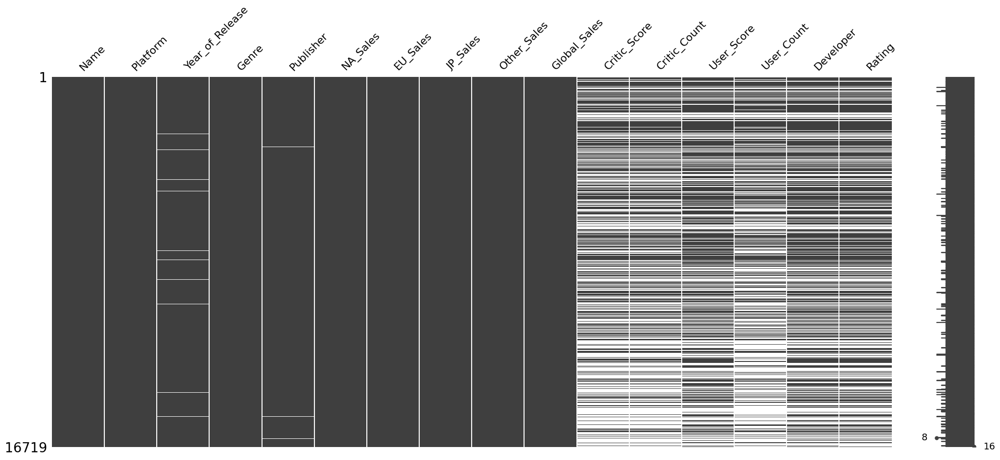

In [10]:
import missingno as msno

ax = msno.matrix(df)

Getting "`Duplicates`" of the data frame using the command "`.duplicated()`", shows whether the data set exists observations duplicated, in this case, there are no duplicated observations to be handled.

In [11]:
df[df.duplicated()].shape

(0, 16)

Checking the data type of each feature using the command "`.dtypes`" and comparing it with the Data Dictionary, as already commented before, some features are in different Data Types.

In [12]:
df.dtypes

Name                object
Platform            object
Year_of_Release    float64
Genre               object
Publisher           object
NA_Sales           float64
EU_Sales           float64
JP_Sales           float64
Other_Sales        float64
Global_Sales       float64
Critic_Score       float64
Critic_Count       float64
User_Score          object
User_Count         float64
Developer           object
Rating              object
dtype: object

**Data Type**

`Object - Text`
- Name: Data Dictionary: Text | dtypes: object, ok
- Platform: Data Dictionary: Text | dtypes: object, ok
- Genre: Data Dictionary: Text | dtypes: object, ok
- Publisher: Data Dictionary: Text | dtypes: object, ok
- Developer: Data Dictionary: Text | dtypes: object, ok
- Rating: Data Dictionary: Text | dtypes: object, ok
  
`Integer - int64`
- Year_of_Release: Data Dictionary: Integer | dtypes: float64, * 
- Critic_Score: Data Dictionary: Integer | dtypes: float64, * 
- Critic_Count: Data Dictionary: Integer | dtypes: float64, * 
- User_Count: Data Dictionary: Integer | dtypes: float64, *
  
`Float - float64`
- NA_Sales: Data Dictionary: Float | dtypes: float64, ok
- EU_Sales: Data Dictionary: Float | dtypes: float64, ok 
- JP_Sales: Data Dictionary: Float | dtypes: float64, ok
- Other_Sales: Data Dictionary: Float | dtypes: float64, ok
- Global_Sales: Data Dictionary: Float | dtypes: float64, ok
- User_Score: Data Dictionary: Float | dtypes: float64, ok

Checks: The features Year_of_Release, Critic_Score, Critic_Count and User_Count are in `float64` type and need to be converted to `int64` after handling Missing Values.

## 2.4 Finding Unique Values

Getting all column names of the data frame using the command "`.columns`" to quickly list all the features and be easy to use next. After that, using the command "`.unique()`", to understand how the values are in each feature, in this case:

- **Features ok/partially ok:** Name, Platform, Genre, Publisher, NA_Sales, EU_Sales, JP_Sales, Other_Sales and Global_Sales.  
- **Features with some observations:** Name, Year_of_Release, Genre, Publisher, Critic_Score, Critic_Count, User_Score, User_Count, Developer and Rating.

As checked before the feature with some observations has missing values, described as "`nan`" value, also the value "`tbd`" in the **User_Score** feature and "`Unknown`" in the **Publisher** feature was found;

In [13]:
df.columns

Index(['Name', 'Platform', 'Year_of_Release', 'Genre', 'Publisher', 'NA_Sales',
       'EU_Sales', 'JP_Sales', 'Other_Sales', 'Global_Sales', 'Critic_Score',
       'Critic_Count', 'User_Score', 'User_Count', 'Developer', 'Rating'],
      dtype='object')

In [14]:
df["Rating"].unique()

array(['E', nan, 'M', 'T', 'E10+', 'K-A', 'AO', 'EC', 'RP'], dtype=object)

## 2.5 Overview 

In [15]:
# pip install ydata-profiling

In [16]:
# pip install ipywidgets

In [17]:
# from ydata_profiling import ProfileReport

# ProfileReport(df, title = "Overview of the Data Frame")

# 3. Exploratory Data Analysis

## 3.1 Checking Data Distribution

Before any updates, it was checked the data distribution of each feature, first getting the names of all categorical features and numerical features next, with an example learned on "analyticsvidhya.com" website of how to "separate Numerical and categorical variables for easy analysis" (Mahadevan, 2022).

Importing the library "`numpy`" in "`3.1 topic`", to use the method number at this time.

In [18]:
import numpy as np

In [19]:
categorical_cols = df.select_dtypes(include = ['object']).columns
numerical_cols = df.select_dtypes(include = np.number).columns.tolist()

print("Categorical Variables:\n", categorical_cols, "\n\n Numerical Variables:\n", numerical_cols)

Categorical Variables:
 Index(['Name', 'Platform', 'Genre', 'Publisher', 'User_Score', 'Developer',
       'Rating'],
      dtype='object') 

 Numerical Variables:
 ['Year_of_Release', 'NA_Sales', 'EU_Sales', 'JP_Sales', 'Other_Sales', 'Global_Sales', 'Critic_Score', 'Critic_Count', 'User_Count']


- **Categorical Features:** 'Name', 'Platform', 'Genre', 'Publisher', 'User_Score', 'Developer' and 'Rating'.
- **Numerical Features:** 'Year_of_Release', 'NA_Sales', 'EU_Sales', 'JP_Sales', 'Other_Sales', 'Global_Sales', 'Critic_Score', 'Critic_Count' and 'User_Count'

Importing "`matplotlib.pyplot`" and "`seaborn`" in "3.1 topic" to create a few data visualisations of the features.

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

Next, it creates a few distribution comparison plots with the numerical features using "`distplot`" and "`kdeplot`" for each feature showing how skewed this feature is, the mean point, median and standard deviation value.

Opted to use Histograms and Density Plots in the next steps, once a histogram is "A great way to get started exploring a single variable is with the histogram. A histogram divides the variable into bins, counts the data points in each bin, and shows the bins on the x-axis and the counts on the y-axis" and the Density Plot that is a "continuous version of a histogram estimated from the data. The most common form of estimation is known as kernel density estimation. In this method, a continuous curve (the kernel) is drawn at every individual data point and all of these curves are then added together to make a single smooth density estimation. The kernel most often used is a Gaussian (which produces a Gaussian bell curve at each data point)." (Koehrsen, 2018).

For the graphics to be understandable are some lines to show the mean and median points. 

Also, an example was learned from the GitHub Gist using the command "`.axvline`" to get a "Distribution plot with mean and median" (Cereniyim, 2019), also checked about the parameters on matplotlib website for "Add a vertical line across the Axes" (The Matplotlib Development Team, 2024).

Also the example for using "`for loop`" it was learned from the website "analyticsvidhya.com" tutorial "Step-by-Step Exploratory Data Analysis (EDA) using Python" in "Step 9: EDA Univariate Analysis" (Mahadevan, 2022).

Feature: Year_of_Release
Skew: -0.97
Mean: 2006.49, Median: 2007.00
Standard Deviation: 5.88


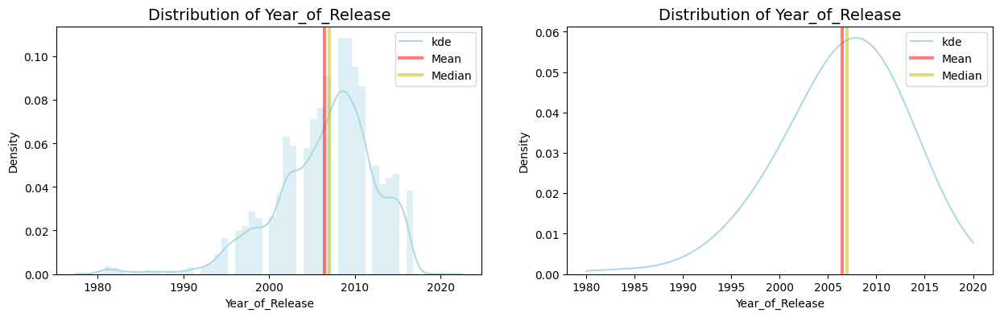

Feature: NA_Sales
Skew: 18.77
Mean: 0.26, Median: 0.08
Standard Deviation: 0.81


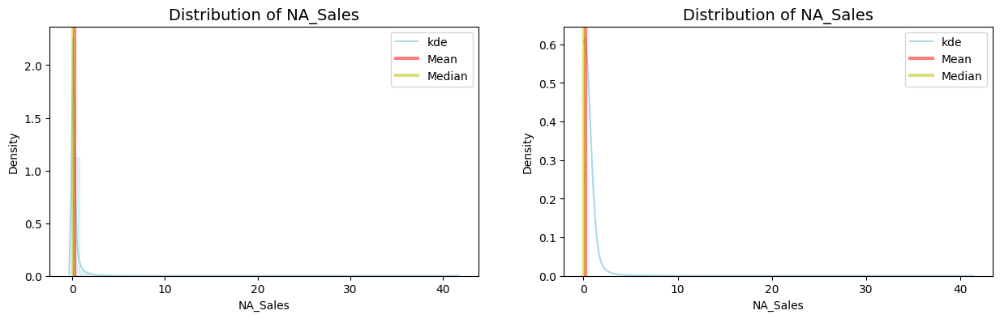

Feature: EU_Sales
Skew: 18.85
Mean: 0.15, Median: 0.02
Standard Deviation: 0.50


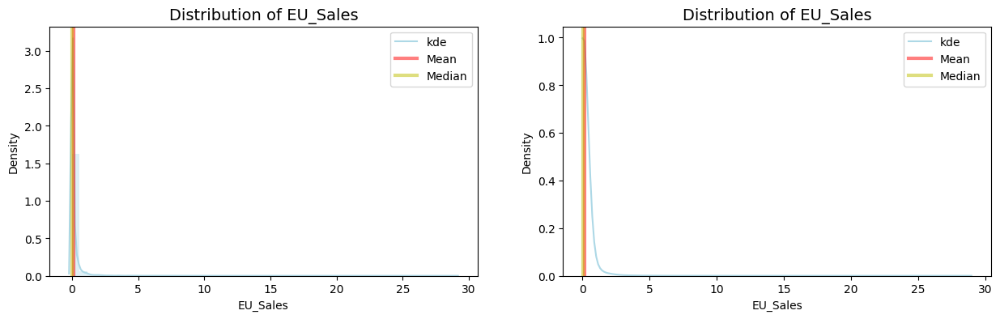

Feature: JP_Sales
Skew: 11.21
Mean: 0.08, Median: 0.00
Standard Deviation: 0.31


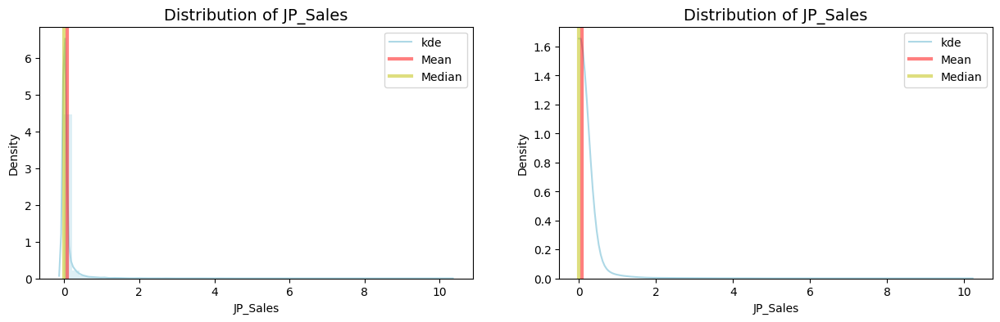

Feature: Other_Sales
Skew: 24.59
Mean: 0.05, Median: 0.01
Standard Deviation: 0.19


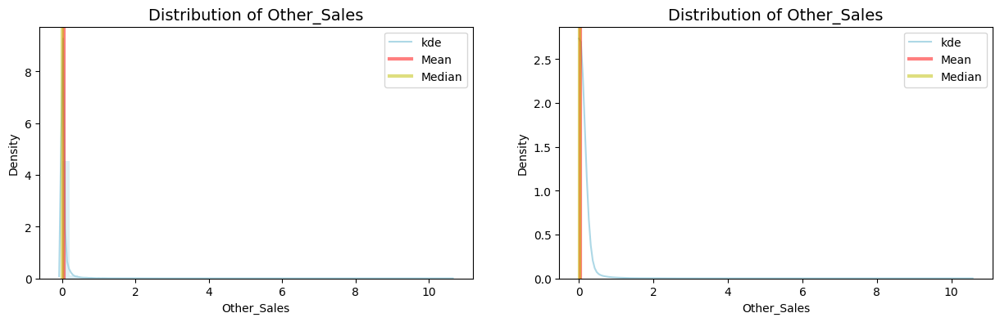

Feature: Global_Sales
Skew: 17.38
Mean: 0.53, Median: 0.17
Standard Deviation: 1.55


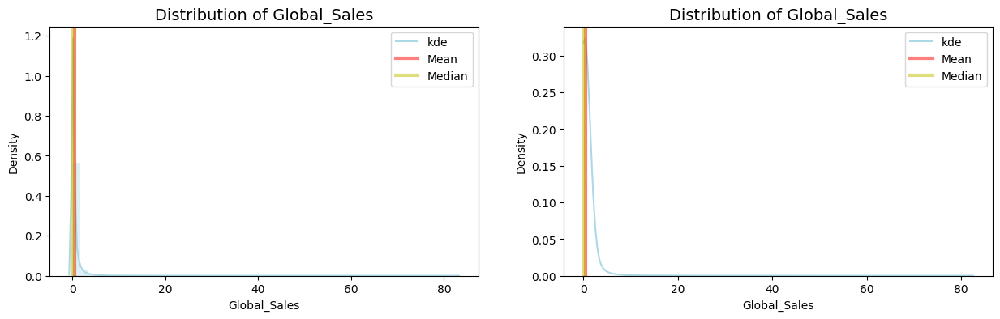

Feature: Critic_Score
Skew: -0.61
Mean: 68.97, Median: 71.00
Standard Deviation: 13.94


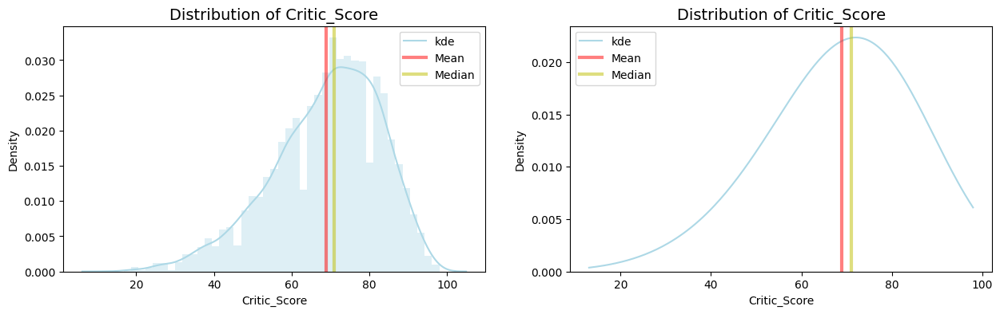

Feature: Critic_Count
Skew: 1.16
Mean: 26.36, Median: 21.00
Standard Deviation: 18.98


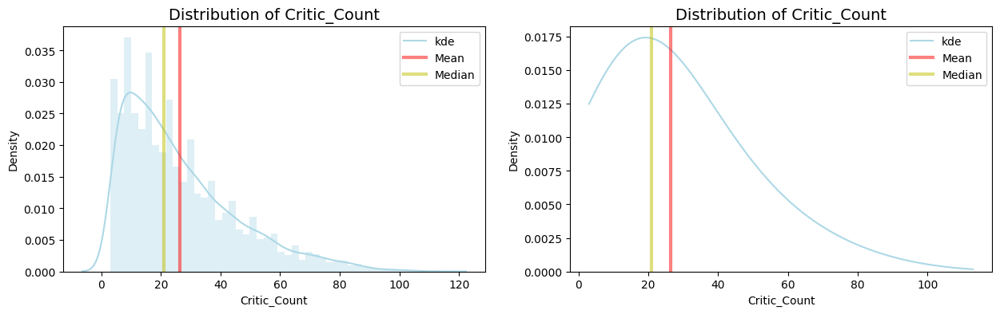

Feature: User_Count
Skew: 9.03
Mean: 162.23, Median: 24.00
Standard Deviation: 561.28


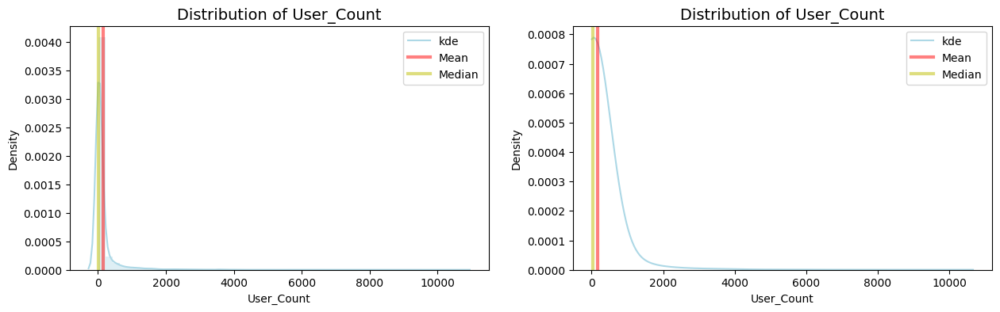

In [21]:
for col in numerical_cols:
    print('Feature:', col)
    print('Skew:', round(df[col].skew(), 2))
    print('Mean: {:.2f}, Median: {:.2f}'.format(df[col].mean(), df[col].median()))
    print('Standard Deviation: {:.2f}'.format(df[col].std()))
    
    plt.figure(figsize = (15, 4))
    plt.subplot(1, 2, 1)
    sns.distplot(df[col], axlabel = col, color = "lightblue");
    plt.axvline(df[col].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
    plt.axvline(df[col].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
    plt.title("Distribution of " + col, size = 14)
    plt.legend(["kde", "Mean", "Median"])
    
    plt.subplot(1, 2, 2)
    sns.kdeplot(data = df, x = col, bw_adjust = 5, cut = 0, color = "lightblue")
    plt.axvline(df[col].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
    plt.axvline(df[col].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
    plt.title("Distribution of " + col, size = 14)
    plt.legend(["kde", "Mean", "Median"])
    plt.show()

- **Distribution of Year_of_Release**: The distribution is “`skewed to the right side`”. Skew: -0.97 - Statistical Values: Mean: 2006.49, Median: 2007.00 and Standard Deviation: 5.88.

- **Distribution of NA_Sales**: The distribution is “`skewed to the left side`”. Skew: 18.77 - Statistical Values: Mean: 0.26, Median: 0.08 and Standard Deviation: 0.81.

- **Distribution of EU_Sales**: The distribution is “`skewed to the left side`”. Skew: 18.85 - Statistical Values: Mean: 0.15, Median: 0.02 and Standard Deviation: 0.50.

- **Distribution of JP_Sales**: The distribution is “`skewed to the left side`”. Skew: 11.21 - Statistical Values: Mean: 0.08, Median: 0.00 and Standard Deviation: 0.31.

- **Distribution of Other_Sales**: The distribution is “`skewed to the left side`”. Skew: 24.59 - Statistical Values: Mean: 0.05, Median: 0.01 and Standard Deviation: 0.19.

- **Distribution of Global_Sales**: The distribution is “`skewed to the left side`”. Skew: 17.38 - Statistical Values: Mean: 0.53, Median: 0.17 and Standard Deviation: 1.55.

- **Distribution of Critic_Score**: Considered with outliers values and missing values; The distribution is “`skewed to the right side`”. Skew: -0.61 - Statistical Values: Mean: 68.97, Median: 71.00 and Standard Deviation: 13.94.

- **Distribution of Critic_Count**: Considered with outliers values and missing values; The distribution is “`skewed to the left side`”. Skew: 1.16 - Statistical Values: Mean: 26.36, Median: 21.00 and Standard Deviation: 18.98.

- **Distribution of User_Count**: Considered with outliers values and missing values; The distribution is “`skewed to the left side`”. Skew: 9.03 - Statistical Values: Mean: 162.23, Median: 24.00 and Standard Deviation: 561.28.

Also to check from another perspective it was created a "`hist subplolt`" and a "`boxplot`" with just the numerical features. "In the below fig, a histogram and box plot is used to show the pattern of the variables, as some variables have skewness and outliers." (Mahadevan, 2022). 

Feature: Year_of_Release
Skew: -0.97


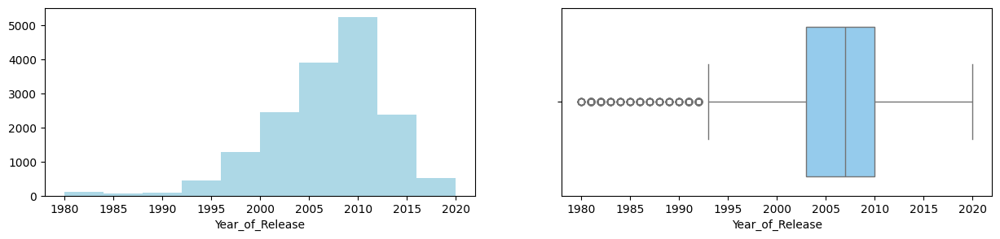

Feature: NA_Sales
Skew: 18.77


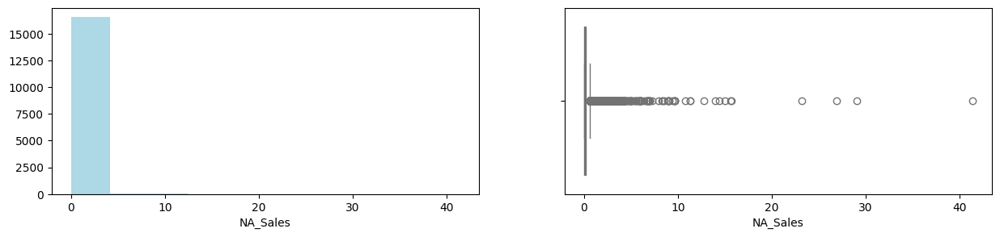

Feature: EU_Sales
Skew: 18.85


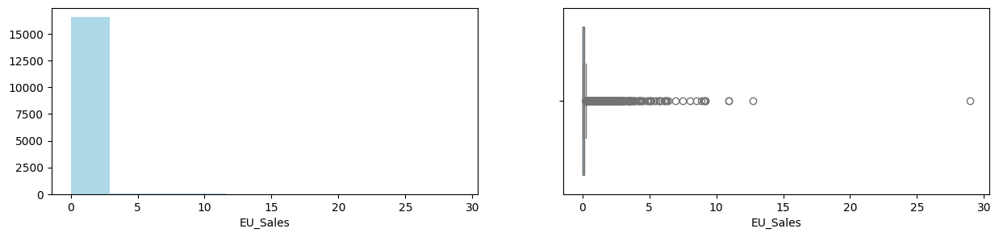

Feature: JP_Sales
Skew: 11.21


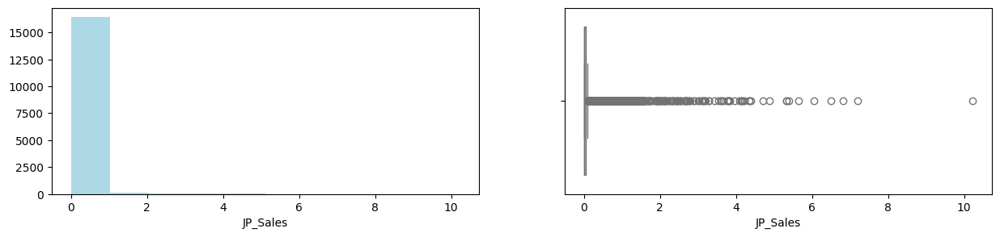

Feature: Other_Sales
Skew: 24.59


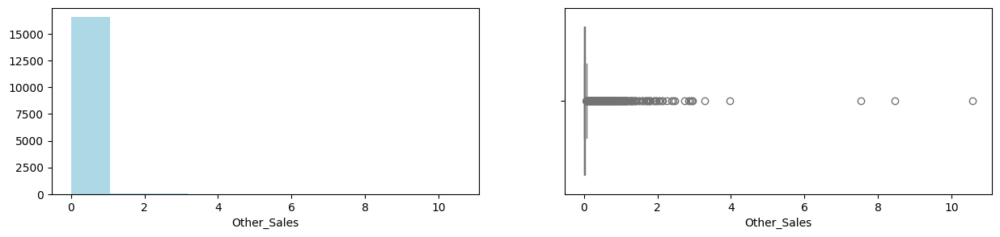

Feature: Global_Sales
Skew: 17.38


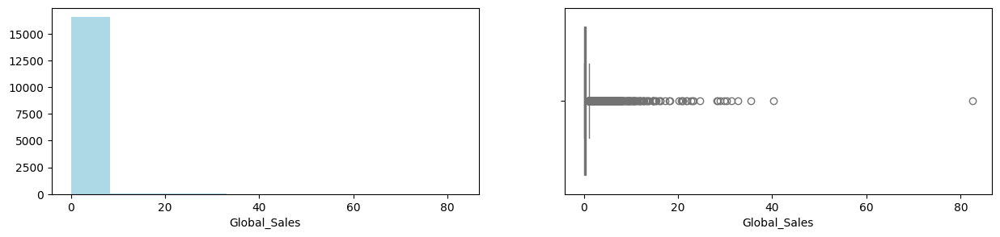

Feature: Critic_Score
Skew: -0.61


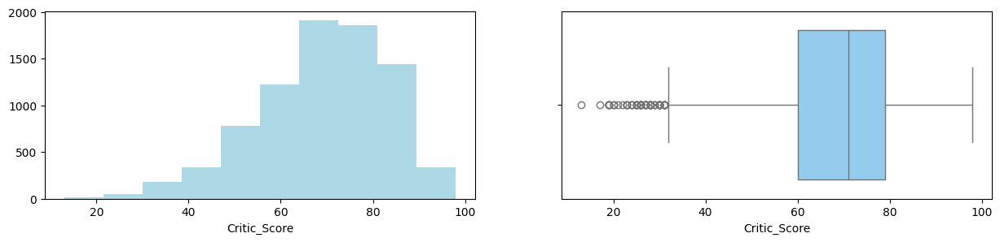

Feature: Critic_Count
Skew: 1.16


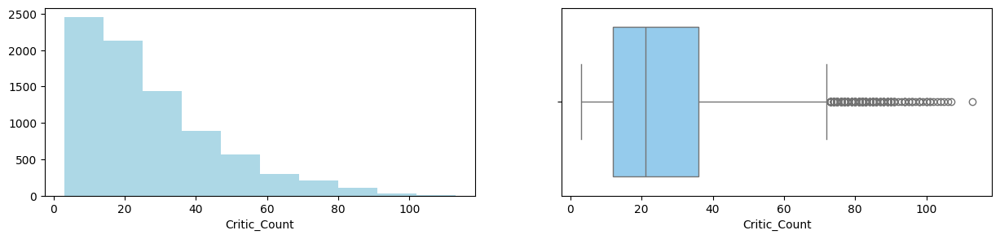

Feature: User_Count
Skew: 9.03


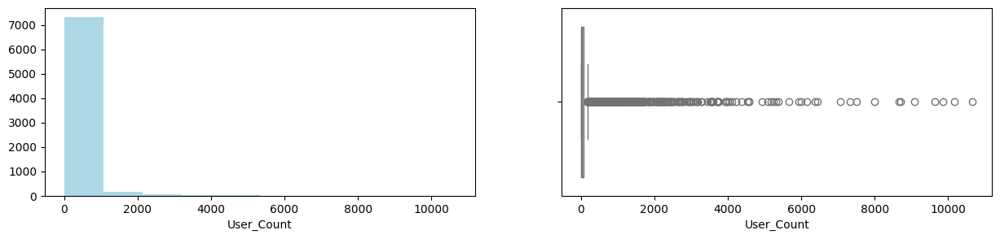

In [22]:
for col in numerical_cols:
    print("Feature: " + col)
    print('Skew:', round(df[col].skew(), 2))
    
    plt.figure(figsize = (15, 3))
    
    plt.subplot(1, 2, 1)
    df[col].hist(grid = False, color = "lightblue")
    plt.xlabel(col)
    
    plt.subplot(1, 2, 2)
    sns.boxplot(x = df[col], color = "lightskyblue")
    plt.show()

Next created a "`countplot`" to visualise all categorical features, it opted to remove the description of all features using "`plt.xticks([])`" once there were too many values to show and turned the result into a big mess, in this case, the main goal is to show how the values are in the categorical features.

Bar plot for all categorical variables in the dataset:



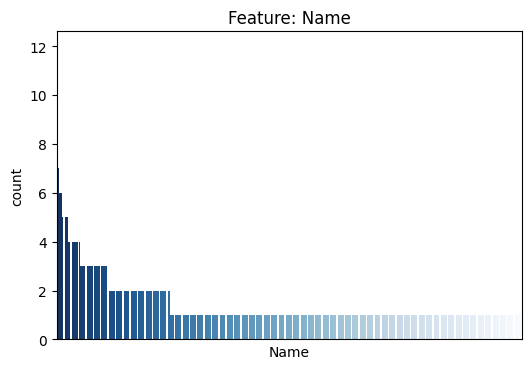

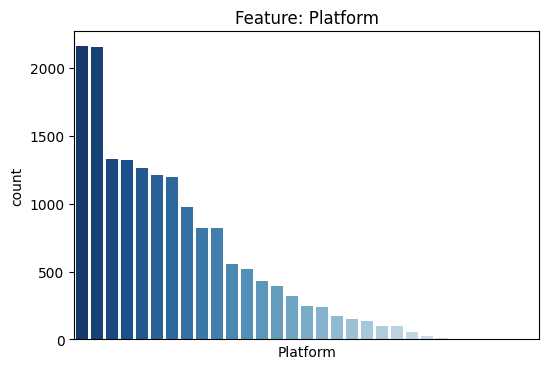

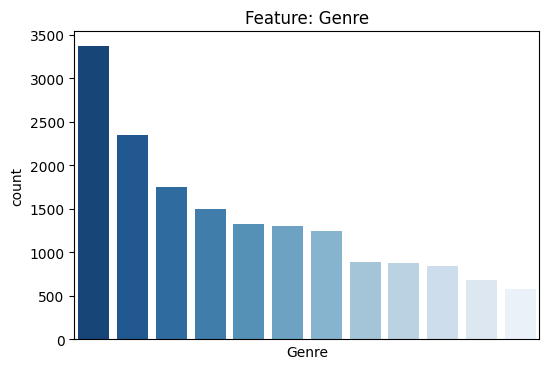

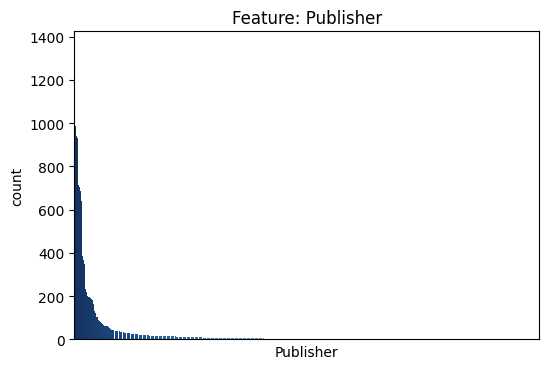

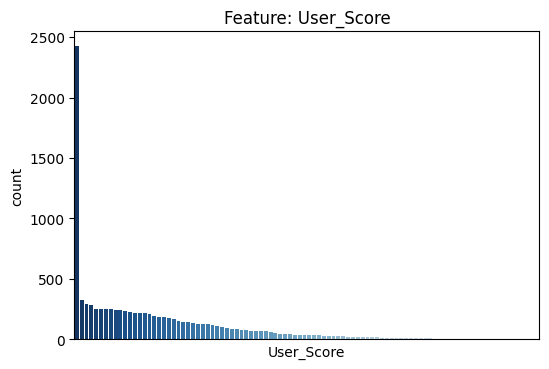

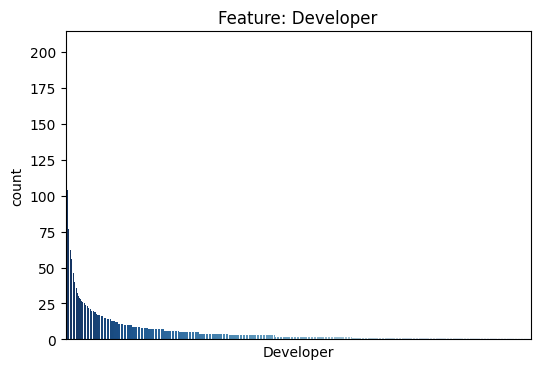

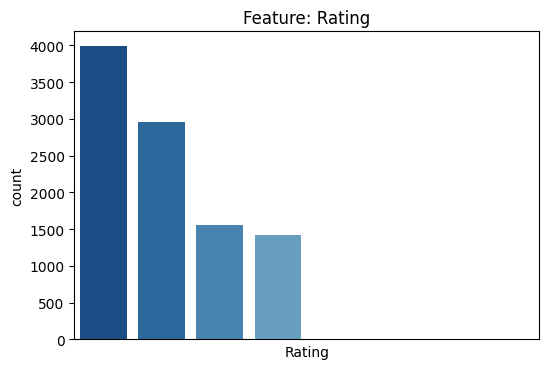

In [23]:
print("Bar plot for all categorical variables in the dataset:\n")

for col, i in zip(categorical_cols, range(len(categorical_cols))):
    plt.figure(figsize = (6, 4))
    sns.countplot(x = col, data = df, palette = "Blues_r", order = df[col].value_counts().index);
    plt.title('Feature: ' + col)
    plt.xticks([])
    plt.show()

## 3.2 Checking missing data

Visualising the missing values utilising the "`missingno`" library as a bar chart at this moment before handle with missing values, once this "visualizes both the number and percentage of the non-missing values. It’s essentially the same as what we’ve shown above, but this time delivered more visually." (Yu, 2020).

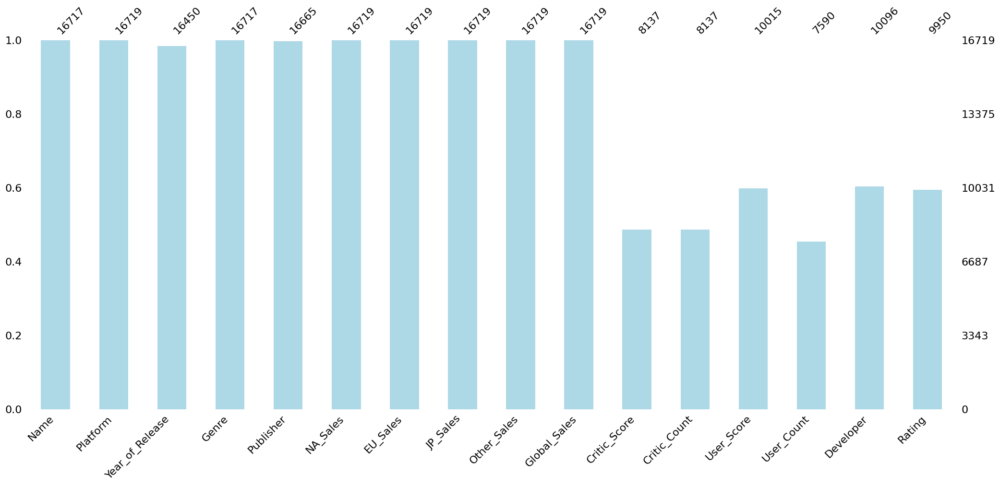

In [24]:
msno.bar(df, color = 'lightblue');

**Name** missing 2 | 0.01% values , **Year_of_Release** missing 269 | 1.61% values, **Genre** missing 2 | 0.01% values, **Publisher** missing 54 | 0.32% values, **Critic_Score** missing 8582 | 51.33% values, **Critic_Count** missing 8582 | 51.33% values, **User_Score** missing 6704 | 40.10% values, **User_Count** missing 9129 | 54.60% values, **Developer** missing 6623 | 39.61 values and **Rating** missing 6769 | 40.49% values.

Show once again the Features missing values

In [25]:
df.isnull().sum()[df.isnull().sum() > 0]

Name                  2
Year_of_Release     269
Genre                 2
Publisher            54
Critic_Score       8582
Critic_Count       8582
User_Score         6704
User_Count         9129
Developer          6623
Rating             6769
dtype: int64

In this part, testing and creating a filter to show the total of missing Values in a specific feature, in this case, testing in the "Rating" feature, and getting the correct value of **6769** missing values.

In [26]:
df["Rating"].isnull().sum()[df["Rating"].isnull().sum() > 0][0]

6769

Next, it gets the total of values in the data frame and subtracts the total of missing values in the "Rating" feature, in this case, getting the total of values not missing values, that is **9950** values.

In [27]:
len(df) - df["Rating"].isnull().sum()[df["Rating"].isnull().sum() > 0][0]

9950

Creating two variables to get the information of the math before, "total_missing" to get the total of missing values and "total_values" to get the total of existing values in the feature, next, it plotted in a bar chart graphic.

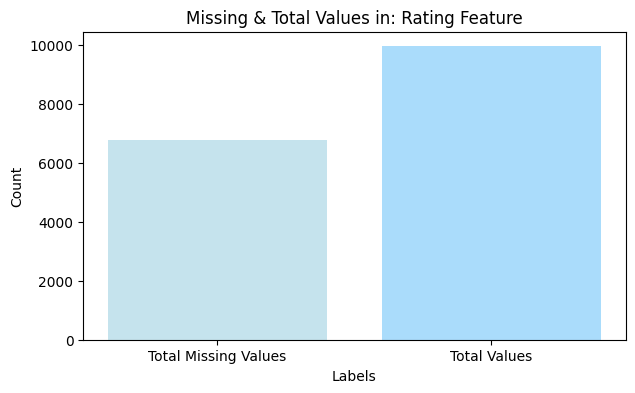

In [28]:
total_missing = df["Rating"].isnull().sum()[df["Rating"].isnull().sum() > 0][0]
total_values = len(df) - total_missing

labels = ['Total Missing Values', 'Total Values']
values = [total_missing, total_values]

plt.figure(figsize = (7, 4))
plt.bar(labels, values, color = ["lightblue", "lightskyblue"], alpha = 0.7)
plt.title("Missing & Total Values in: Rating Feature")
plt.xlabel("Labels")
plt.ylabel("Count")
plt.show()

Importing "`plotly.express`" in "`3.2 topic`", to use the graphing libraries with a high-level interface to Plotly.

In [29]:
import plotly.express as px

Creating a bar chart with the "`Plotly`" Graphing Libraries following the document of "How to make Bar Charts in Python with Plotly." (Plotly, 2016).

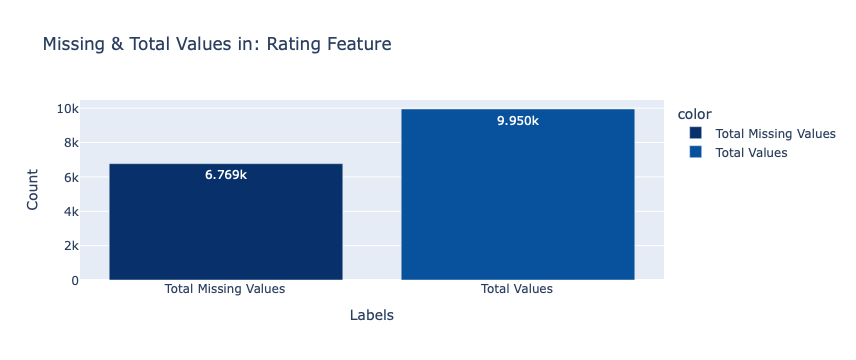

In [30]:
fig = px.bar(df, y = values, x = labels, text_auto = '.4s',
            title = "Missing & Total Values in: Rating Feature",
            labels = {'x': 'Labels', 'y': 'Count'},
            color = labels, color_discrete_sequence = px.colors.sequential.Blues_r)
fig.show()

Next, it creates a "`for loop`" to show all features and their respective total of missing values and total values.

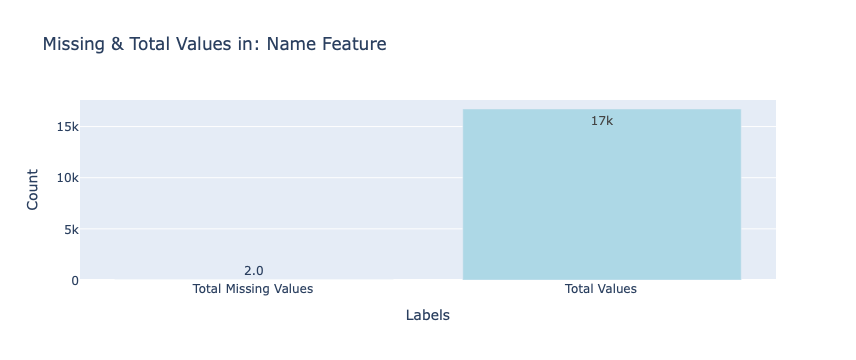

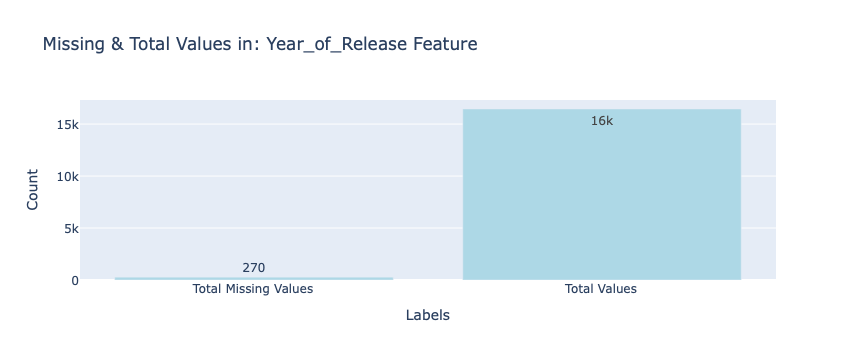

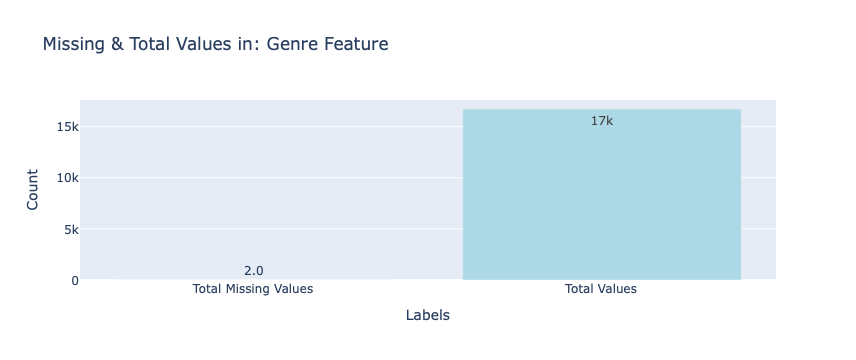

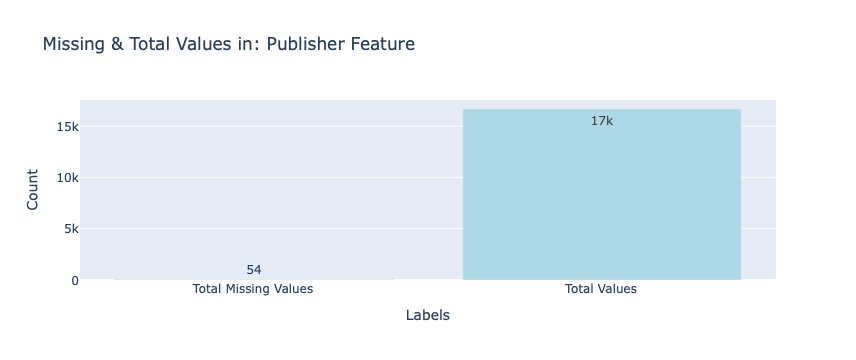

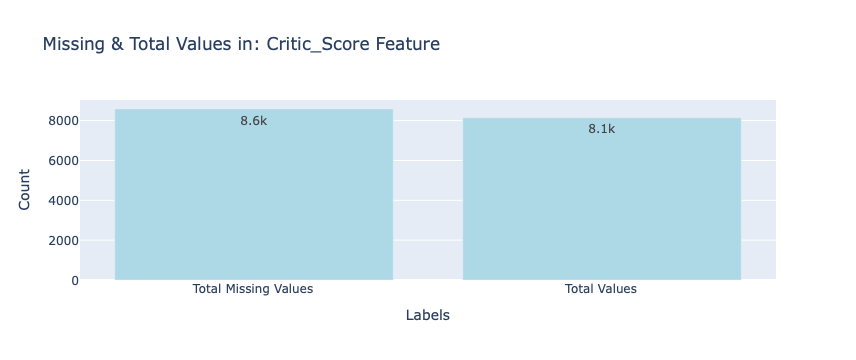

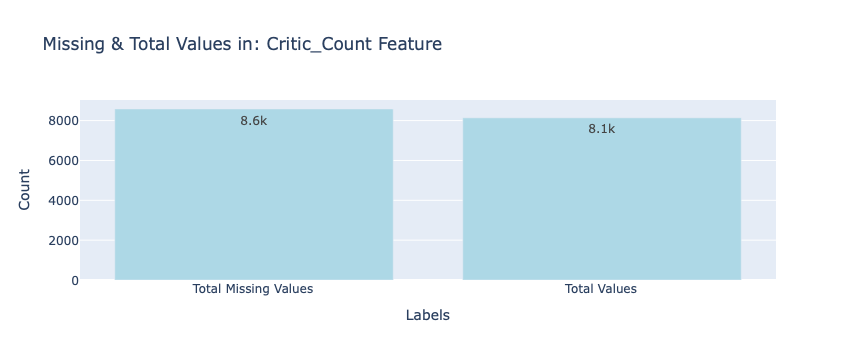

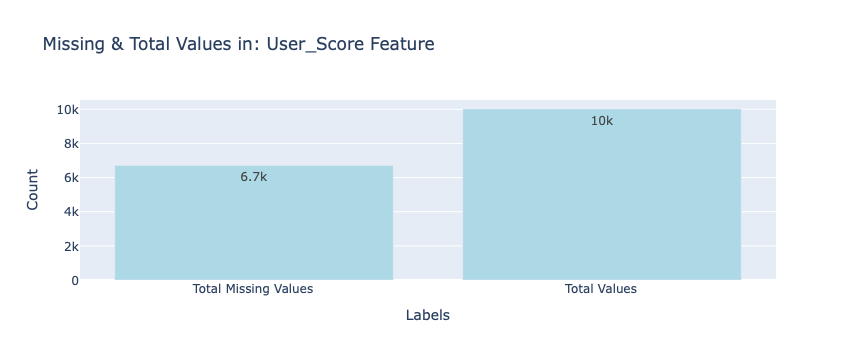

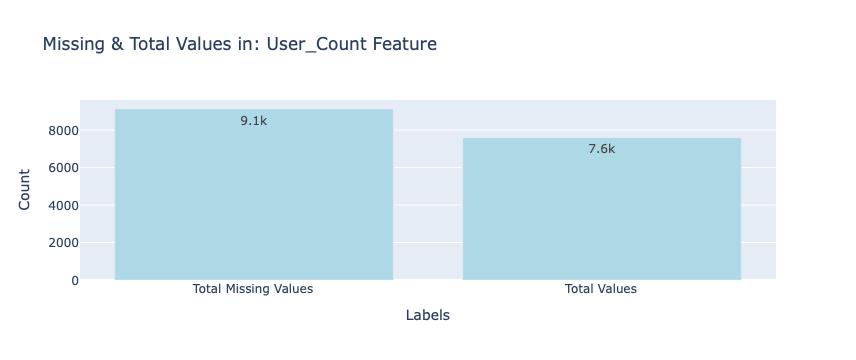

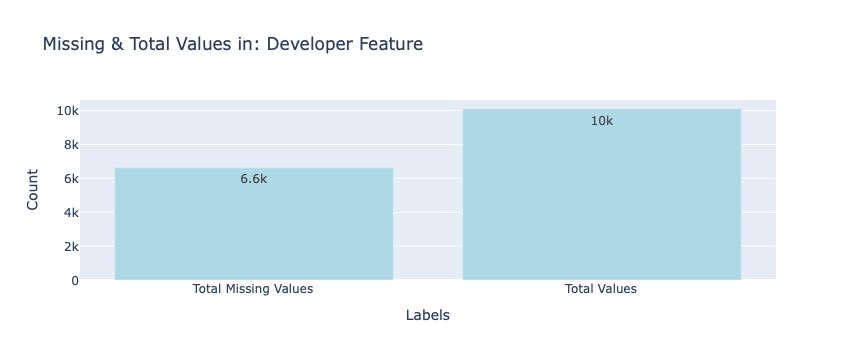

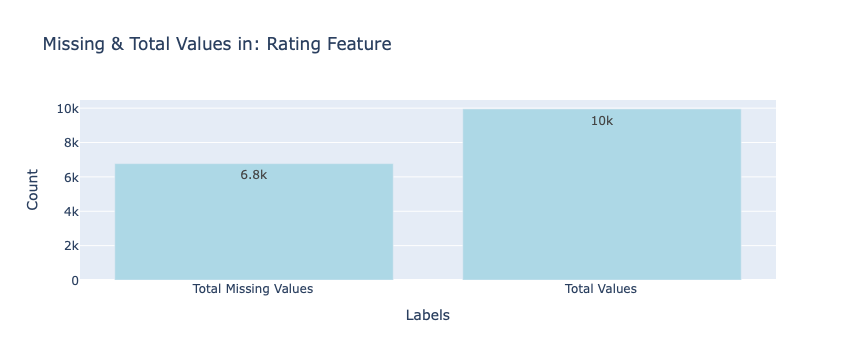

In [31]:
feature_missing_values = df[["Name", "Year_of_Release", "Genre", 
                             "Publisher", "Critic_Score", "Critic_Count", 
                             "User_Score", "User_Count", "Developer", "Rating"]]

for col in feature_missing_values:

    total_missing = df[col].isnull().sum()[df[col].isnull().sum() > 0][0]
    total_values = len(df) - total_missing
    
    labels = ['Total Missing Values', 'Total Values']
    values = [total_missing, total_values]

    fig = px.bar(df, y = values, x = labels, text_auto = '.2s',
                 title = "Missing & Total Values in: " + col + " Feature",
                 labels = {'x': 'Labels', 'y': 'Count'},
                 color_discrete_sequence = ['lightblue'])
    fig.show()

**Publisher** Situation

About the feature "`Publisher`" considering that the "`Unknown`" value, as found before, is also a null value, the math needs to change a little bit, first getting the total of Unknown values, resulting in **201** values.

In [32]:
df[df["Publisher"] == "Unknown"].shape[0]

201

The total of missing values **54**.

In [33]:
df["Publisher"].isnull().sum()[df["Publisher"].isnull().sum() > 0][0]

54

Next, it getting the sum of missing values and Unknown values, resulting in **255** values.  

In [34]:
df["Publisher"].isnull().sum()[df["Publisher"].isnull().sum() > 0][0] + df[df["Publisher"] == "Unknown"].shape[0]

255

The total of **16719** values in the feature, with **16464** being real values and **255** Missing/Unknown values

In [35]:
df.shape[0]

16719

In [36]:
len(df) - (df["Publisher"].isnull().sum()[df["Publisher"].isnull().sum() > 0][0] + df[df["Publisher"] == "Unknown"].shape[0])

16464

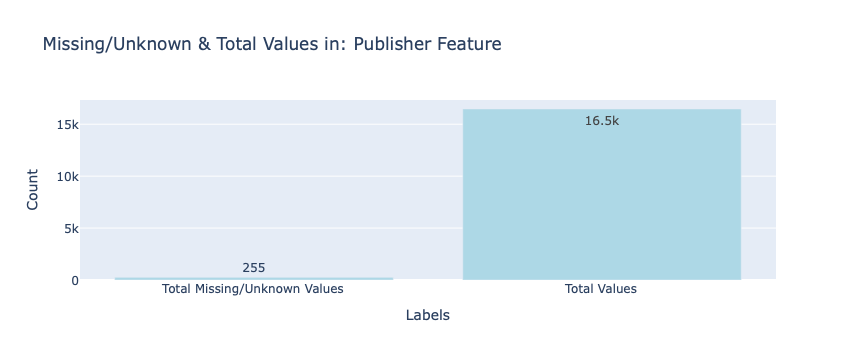

In [37]:
total_missing = df["Publisher"].isnull().sum()[df["Publisher"].isnull().sum() > 0][0] + df[df["Publisher"] == "Unknown"].shape[0]
total_values = len(df) - total_missing

labels = ['Total Missing/Unknown Values', 'Total Values']
values = [total_missing, total_values]

fig = px.bar(df, y = values, x = labels, text_auto = '.3s',
            title = "Missing/Unknown & Total Values in: Publisher Feature",
            labels = {'x': 'Labels', 'y': 'Count'},
            color_discrete_sequence = ['lightblue'])
fig.show()

**User_Score** Situation

About the feature "`User_Score`" considering that the "`tbd`" value, as found before, is also a null value or a value to be determined, the math needs to change a little bit, first getting the total of tbd values, resulting in **2425** values.

In [38]:
df[df["User_Score"] == "tbd"].shape[0]

2425

The total of missing values **6704**.

In [39]:
df["User_Score"].isnull().sum()[df["User_Score"].isnull().sum() > 0][0]

6704

Next, it getting the sum of missing values and tbd values, resulting in **9129** values.  

In [40]:
df["User_Score"].isnull().sum()[df["User_Score"].isnull().sum() > 0][0] + df[df["User_Score"] == "tbd"].shape[0]

9129

The total of **16719** values in the feature, with **7590** being real values and **6704** Missing/tbd values

In [41]:
df.shape[0]

16719

In [42]:
len(df) - (df["User_Score"].isnull().sum()[df["User_Score"].isnull().sum() > 0][0] + df[df["User_Score"] == "tbd"].shape[0])

7590

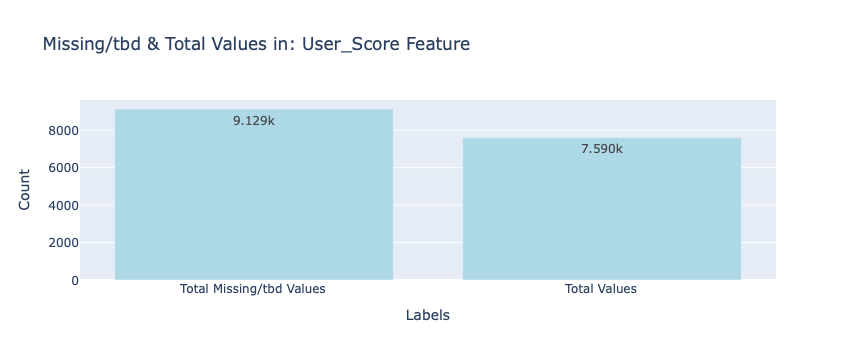

In [43]:
total_missing = df["User_Score"].isnull().sum()[df["User_Score"].isnull().sum() > 0][0] + df[df["User_Score"] == "tbd"].shape[0]
total_values = len(df) - total_missing

labels = ['Total Missing/tbd Values', 'Total Values']
values = [total_missing, total_values]

fig = px.bar(df, y = values, x = labels, text_auto = '.4s',
            title = "Missing/tbd & Total Values in: User_Score Feature",
            labels = {'x': 'Labels', 'y': 'Count'},
            color_discrete_sequence = ['lightblue'])
fig.show()

### 3.2.1 Checking/Handling Missing Data of Name Feature

Checking Unique Values of the feature, checking the observations missing values, and checking Platform observations to get a final decision about the missing values.

First, it checks the unique values of the "Name" feature.

In [44]:
df["Name"].unique()

array(['Wii Sports', 'Super Mario Bros.', 'Mario Kart Wii', ...,
       'Woody Woodpecker in Crazy Castle 5', 'LMA Manager 2007',
       'Haitaka no Psychedelica'], dtype=object)

Getting the information about the total of missing values in this feature, in this case, just **2** values. Using the method "`.isnull()`" learned on note.nkmk.me website, in "pandas: Find rows/columns with NaN (missing values)" (nkmk.me, 2023).

In [45]:
df[df["Name"].isnull()]

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
659,NaN,GEN,1993.0,NaN,Acclaim Entertainment,1.78,0.53,0.00,0.08,2.39,NaN,NaN,NaN,NaN,NaN,NaN
14246,NaN,GEN,1993.0,NaN,Acclaim Entertainment,0.00,0.00,0.03,0.00,0.03,NaN,NaN,NaN,NaN,NaN,NaN


Both names missing are from the Platform "GEN", getting the head of the Platform where is GEN as value, to analyses and get a final decision.

In [46]:
df[df["Platform"] == "GEN"].head(2)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
145,Sonic the Hedgehog 2,GEN,1992.0,Platform,Sega,4.47,1.20,0.16,0.19,6.03,NaN,NaN,NaN,NaN,NaN,NaN
257,Sonic the Hedgehog,GEN,1991.0,Platform,Sega,3.03,0.91,0.26,0.13,4.34,NaN,NaN,NaN,NaN,NaN,NaN


In this case, there is no way to figure out what is the correct name of the game, so it opted to drop these 2 observations.

Used “`.dropna`” to drop their respective observations, with the parameter “`"subset"` Labels along other axis to consider, e.g. if you are dropping rows these would be a list of columns to include.” and the parameter “`"inplace = true"` Whether to modify the DataFrame rather than creating a new one.” (The Pandas Development Team, 2024a).

In [47]:
df.dropna(subset = ["Name"], inplace = True)

Also, resolved the problem of the "Genre" feature with missing values, once there were the same observations as the "Name" feature with missing values.

In [48]:
df.isnull().sum()[df.isnull().sum() > 0]

Year_of_Release     269
Publisher            54
Critic_Score       8580
Critic_Count       8580
User_Score         6702
User_Count         9127
Developer          6621
Rating             6767
dtype: int64

### 3.2.2 Checking/Handling Missing Data of Year_of_Release Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "Year_of_Release" feature, and we can see the existence of "nan" values.

In [49]:
df["Year_of_Release"].unique()

array([2006., 1985., 2008., 2009., 1996., 1989., 1984., 2005., 1999.,
       2007., 2010., 2013., 2004., 1990., 1988., 2002., 2001., 2011.,
       1998., 2015., 2012., 2014., 1992., 1997., 1993., 1994., 1982.,
       2016., 2003., 1986., 2000.,   nan, 1995., 1991., 1981., 1987.,
       1980., 1983., 2020., 2017.])

Getting the information about the total of missing values in this feature, in this case, just **269** values.

In [50]:
df[df["Year_of_Release"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
183,Madden NFL 2004,PS2,NaN,Sports,Electronic Arts,4.26,0.26,0.01,0.71,5.23,94.0,29.0,8.5,140.0,EA Tiburon,E
377,FIFA Soccer 2004,PS2,NaN,Sports,Electronic Arts,0.59,2.36,0.04,0.51,3.49,84.0,20.0,6.4,76.0,EA Canada,E
456,LEGO Batman: The Videogame,Wii,NaN,Action,Warner Bros. Interactive Entertainment,1.80,0.97,0.00,0.29,3.06,74.0,17.0,7.9,22.0,Traveller's Tales,E10+


The feature "Year_of_Release" is missing 269 values as 1.6 % of the total.

In [51]:
df[df["Year_of_Release"].isnull()].shape[0]

269

In [52]:
print("Year_of_Release feature missing:", df["Year_of_Release"].isnull().mean().round(3) * 100, "%")

Year_of_Release feature missing: 1.6 %


In this case, there are two exits, the first is to drop the observations missing once just 1.6% of the data or try to input values.

The Ways of Handling Missing Data could be followed using these Strategies below: 

1. Deletion: One straightforward approach is to remove rows or columns with missing values. This strategy is suitable when the missingness is random and doesn’t introduce bias.
2. Imputation: Imputation involves filling in missing values with estimated or calculated values.
3. Interpolation: Interpolation methods estimate missing values based on existing data points.
4. Advanced Techniques: Multiple imputation generates multiple plausible values for each missing entry, while machine learning-based imputation leverages algorithms to predict missing values based on other features in the dataset. (Berukoff, 2023)

Left the command to drop all na values of the feature "Year_of_Release" commented below, as another way of adding data will be tested, if this does not work, it can be used to drop them all.

Inputting values could be a challenge once " Missing values can introduce bias in statistical analyses and machine learning models, impacting the accuracy and reliability of results." (Sanjushusanth, 2023)

In [53]:
# df.dropna(subset = ["Year_of_Release"], inplace = True)

Opted to use Multiple imputation once this "is a statistical technique that generates multiple plausible imputed datasets to account for the uncertainty associated with missing values. It involves creating multiple copies of the original dataset, imputing missing values in each copy using a chosen method, and then analyzing the results from all imputed datasets. The final analysis combines the results to provide more robust estimates." (Berukoff, 2023).

Importing the method "`IterativeImputer`" in "3.2.2 topic", from "fancyimpute" to input data.

In [54]:
# from fancyimpute import IterativeImputer

# imputer = IterativeImputer()

In [55]:
# df["Year_of_Release"] = pd.DataFrame(imputer.fit_transform(df[["Year_of_Release"]]))

For some reason, when applying Multiple imputations in the "Year_of_Release" there were always two missing values ​​to be imputed, so it opted to choose another method that is Simple Imputation that "is another way to impute missing values." once "the missing value can be set to whatever value you’d like and does not have to be equivalent to np.nan as it does using the fillna() function in Pandas. Additionally, the imputation strategy can easily be changed between one of the following four options simply by altering the strategy argument:

- "mean" — replaces missing values with the mean
- "median" — replaces missing values with the median
- "most_frequent" — replaces missing values with the most frequent value
- "constant" — replaces missing values with whatever value is specified in the fill_value argument. This could be useful in a scenario in which you want to replace missing values with a string saying “missing” rather than an actual value." (Kyner, 2021)

Importing the method "`SimpleImputer`" in "3.2.2 topic", from "sklearn.impute" to input data.

In [56]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy = 'median')

In [57]:
df["Year_of_Release"] = imputer.fit_transform(df[["Year_of_Release"]])

In [58]:
df.isnull().sum()[df.isnull().sum() > 0]

Publisher         54
Critic_Score    8580
Critic_Count    8580
User_Score      6702
User_Count      9127
Developer       6621
Rating          6767
dtype: int64

### 3.2.3 Checking/Handling Missing Data of Publisher Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

As checked before, this feature has "Unknown" values, where there are 201 values as Unknown.

In [59]:
df[df["Publisher"] == "Unknown"].shape[0]

201

And 54 missing values.

In [60]:
df[df["Publisher"].isnull()].shape[0]

54

In this case, it opted to change the "NaN or Null" values to Unknown, where in any case null values ​​are unknown, then it will be more acceptable to assign a text instead of deleting these observations that may be important for the analyses.

In [61]:
df["Publisher"].replace({None: "Unknown"}, inplace = True)

In [62]:
print("Number of Unknown observations:", df[df["Publisher"] == "Unknown"].shape[0])

Number of Unknown observations: 255


Plotting the graphic to check the values.

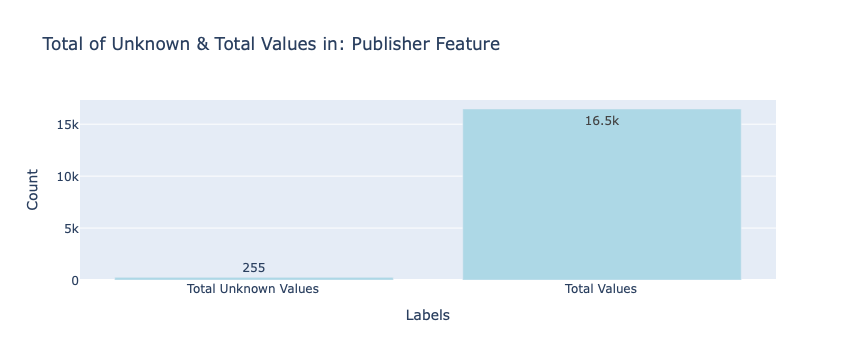

In [63]:
total_unknown = df[df["Publisher"] == "Unknown"].shape[0]
total_values = len(df) - total_unknown

labels = ['Total Unknown Values', 'Total Values']
values = [total_unknown, total_values]

fig = px.bar(df, y = values, x = labels, text_auto = '.3s',
            title = "Total of Unknown & Total Values in: Publisher Feature",
            labels = {'x': 'Labels', 'y': 'Count'},
            color_discrete_sequence = ['lightblue'])
fig.show()

In [64]:
df.isnull().sum()[df.isnull().sum() > 0]

Critic_Score    8580
Critic_Count    8580
User_Score      6702
User_Count      9127
Developer       6621
Rating          6767
dtype: int64

### 3.2.4 Checking/Handling Missing Data of Critic_Score Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "Critic_Score" feature, and we can see the existence of "nan" values.

In [65]:
df["Critic_Score"].unique()

array([76., nan, 82., 80., 89., 58., 87., 91., 61., 97., 95., 77., 88.,
       83., 94., 93., 85., 86., 98., 96., 90., 84., 73., 74., 78., 92.,
       71., 72., 68., 62., 49., 67., 81., 66., 56., 79., 70., 59., 64.,
       75., 60., 63., 69., 50., 25., 42., 44., 55., 48., 57., 29., 47.,
       65., 54., 20., 53., 37., 38., 33., 52., 30., 32., 43., 45., 51.,
       40., 46., 39., 34., 35., 41., 36., 28., 31., 27., 26., 19., 23.,
       24., 21., 17., 22., 13.])

Getting the information about the total of missing values in this feature, in this case, **8580** values.

In [66]:
df[df["Critic_Score"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,NaN,NaN,NaN,NaN,NaN,NaN
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,NaN,NaN,NaN,NaN,NaN,NaN
5,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,NaN,NaN,NaN,NaN,NaN,NaN


The feature "Critic_Score" is missing 8580 values as 51.32 % of the total.

In [67]:
df[df["Critic_Score"].isnull()].shape[0]

8580

In [68]:
print("Critic_Score feature missing:", df["Critic_Score"].isnull().mean().round(4) * 100, "%")

Critic_Score feature missing: 51.32 %


Checking the distribution of "Critic_Score" feature before dealing with it.

Skew: -0.61
Mean: 68.97, Median: 71.00
Standard Deviation: 13.94


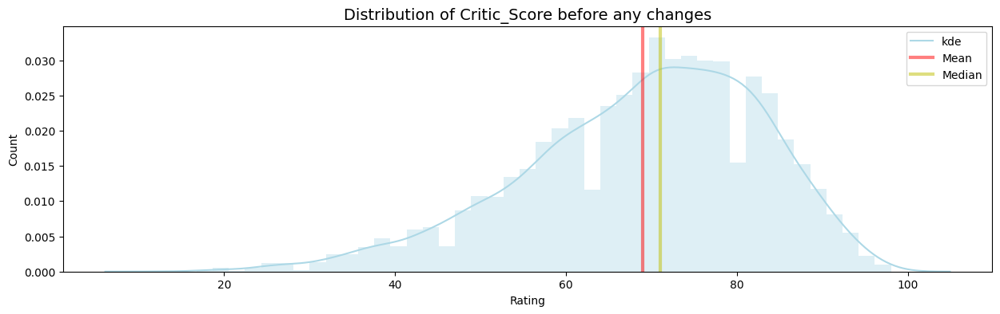

In [69]:
print('Skew:', round(df["Critic_Score"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["Critic_Score"].mean(), df["Critic_Score"].median()))
print('Standard Deviation: {:.2f}'.format(df["Critic_Score"].std()))

plt.figure(figsize = (15, 4))
sns.distplot(df["Critic_Score"], axlabel = col, color = "lightblue");
plt.axvline(df["Critic_Score"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["Critic_Score"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of Critic_Score before any changes", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')

plt.show()

Left the command to drop all na values of the feature "Critic_Score" commented below, as another way of adding data will be tested, if this does not work, it can be used to drop them all.

In [70]:
# df = df.drop(['Critic_Score'], axis = 1)

In this case, the Simple Imputation will fill them all using the median as a strategy.
"If “median”, then replace missing values using the median along each column. Can only be used with numeric data." (scikit-learn developers, 2024).

In [71]:
imputer = SimpleImputer(strategy = 'median')

df["Critic_Score"] = imputer.fit_transform(df[["Critic_Score"]])

Next, it checking the distribution of "Critic_Score" feature after dealing with missing values, but now using it as a kdeplot once the "distplot" was not presenting a good visualisation.

Skew: -1.18
Mean: 70.01, Median: 71.00
Standard Deviation: 9.78


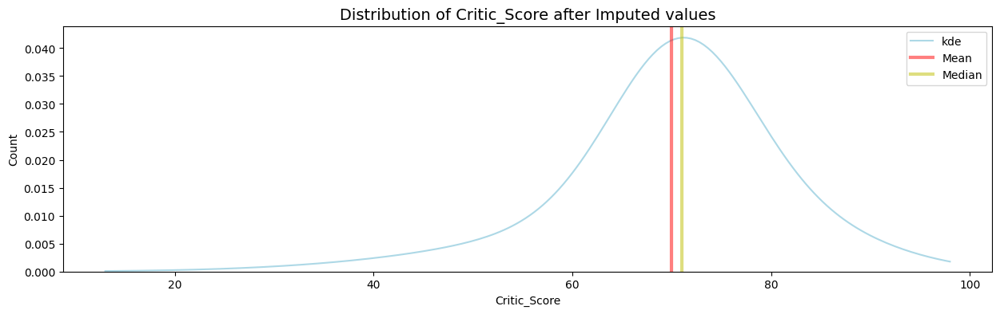

In [72]:
print('Skew:', round(df["Critic_Score"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["Critic_Score"].mean(), df["Critic_Score"].median()))
print('Standard Deviation: {:.2f}'.format(df["Critic_Score"].std()))

plt.figure(figsize = (15, 4))
sns.kdeplot(data = df, x = "Critic_Score", bw_adjust = 5, cut = 0, color = "lightblue")
plt.axvline(df["Critic_Score"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["Critic_Score"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of Critic_Score after Imputed values", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')

plt.show()

Before: Skew: -0.61, Mean: 68.97, Median: 71.00 and Standard Deviation: 13.94

After: Skew: -1.18, Mean: 70.01, Median: 71.00 and Standard Deviation: 9.78

Still "skewed to the right side", now a little worse than before.

In [73]:
df.isnull().sum()[df.isnull().sum() > 0]

Critic_Count    8580
User_Score      6702
User_Count      9127
Developer       6621
Rating          6767
dtype: int64

### 3.2.5 Checking/Handling Missing Data of Critic_Count Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "Critic_Count" feature, and we can see the existence of "nan" values.

In [74]:
df["Critic_Count"].unique()

array([ 51.,  nan,  73.,  65.,  41.,  80.,  64.,  63.,  45.,  33.,  50.,
        58.,  62.,  37.,  54.,  81.,  89.,  21., 100.,  39.,  56.,  66.,
        57.,  86.,  74.,  16.,  82.,  67.,  29.,  15.,  70.,  99.,  20.,
        87.,  23.,  24.,  10.,  27.,  42.,  91.,  53.,  75.,  46.,  84.,
        38.,  12.,  90.,  97.,  44., 105.,  77.,  68.,  28.,  94.,  96.,
        61.,  22.,  88.,  47.,  98.,  85.,  13.,   8.,  95.,  17.,  35.,
        19.,  48.,  14., 113.,  83.,  72.,  30.,  69.,  76.,  18.,  34.,
        40., 101.,   9.,  32.,  78.,  36.,  25.,  59.,  31.,  79.,  26.,
        49.,  60.,  11.,  43., 107.,   7.,  71.,  55.,  52.,  92.,   4.,
        93.,   5.,   6., 103., 102., 106.,   3., 104.])

Getting the information about the total of missing values in this feature, in this case, 8580 values.

In [75]:
df[df["Critic_Count"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71.0,NaN,NaN,NaN,NaN,NaN
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71.0,NaN,NaN,NaN,NaN,NaN
5,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,71.0,NaN,NaN,NaN,NaN,NaN


The feature "Critic_Count" is missing 8580 values as 51.30 % of the total.

In [76]:
df[df["Critic_Count"].isnull()].shape[0]

8580

In [77]:
print("Critic_Count feature missing:", df["Critic_Count"].isnull().mean().round(3) * 100, "%")

Critic_Count feature missing: 51.300000000000004 %


Checking the distribution of "Critic_Count" feature before dealing with it.

Skew: 1.16
Mean: 26.36, Median: 21.00
Standard Deviation: 18.98


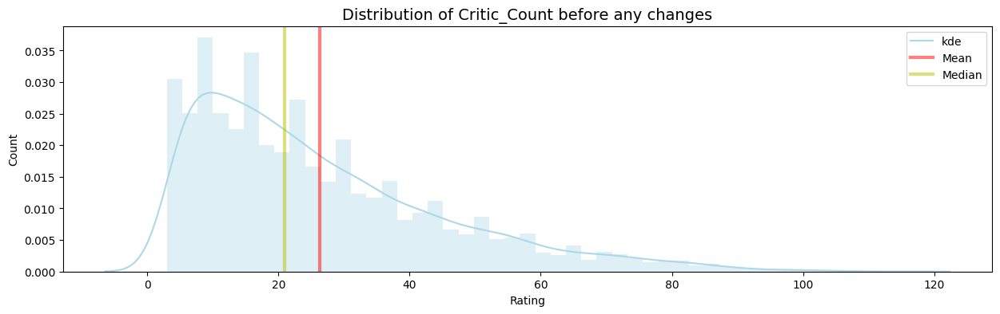

In [78]:
print('Skew:', round(df["Critic_Count"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["Critic_Count"].mean(), df["Critic_Count"].median()))
print('Standard Deviation: {:.2f}'.format(df["Critic_Count"].std()))

plt.figure(figsize = (15, 4))
sns.distplot(df["Critic_Count"], axlabel = col, color = "lightblue");
plt.axvline(df["Critic_Count"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["Critic_Count"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of Critic_Count before any changes", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')

plt.show()

Left the command to drop all na values of the feature "Critic_Count" commented below, as another way of adding data will be tested, if this does not work, it can be used to drop them all.

In [79]:
# df = df.drop(['Critic_Count'], axis = 1)

Using Simple Imputation to fill all missing values using the median as a strategy.

In [80]:
imputer = SimpleImputer(strategy = 'median')

df["Critic_Count"] = imputer.fit_transform(df[["Critic_Count"]])

Next, it checking the distribution of "Critic_Count" feature after dealing with missing values, but now using it as a kdeplot once the "distplot" was not presenting a good visualisation.

Skew: 2.15
Mean: 23.61, Median: 21.00
Standard Deviation: 13.51


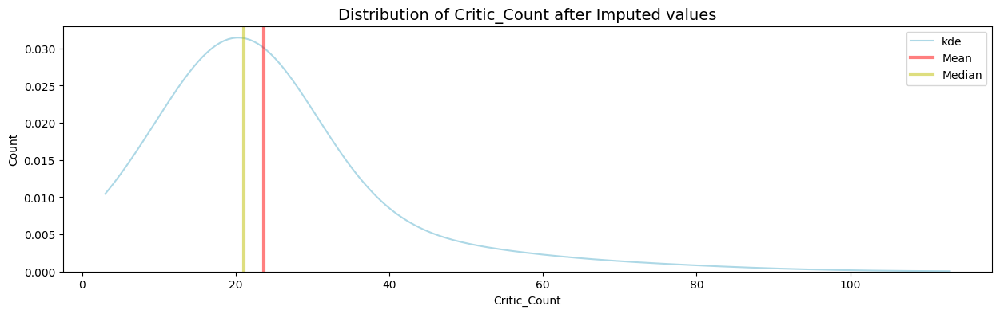

In [81]:
print('Skew:', round(df["Critic_Count"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["Critic_Count"].mean(), df["Critic_Count"].median()))
print('Standard Deviation: {:.2f}'.format(df["Critic_Count"].std()))

plt.figure(figsize = (15, 4))
sns.kdeplot(data = df, x = "Critic_Count", bw_adjust = 5, cut = 0, color = "lightblue")
plt.axvline(df["Critic_Count"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["Critic_Count"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of Critic_Count after Imputed values", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')
plt.show()

Before: Skew: 1.16, Mean: 26.36, Median: 21.00 and Standard Deviation: 18.98

After: Skew: 2.15, Mean: 23.61, Median: 21.00 and Standard Deviation: 13.51

Still "skewed to the left side", now a little worse than before.

In [82]:
df.isnull().sum()[df.isnull().sum() > 0]

User_Score    6702
User_Count    9127
Developer     6621
Rating        6767
dtype: int64

### 3.2.6 Checking/Handling Missing Data of User_Score Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "User_Score" feature, and we can see the existence of "nan and tbd" values.

In [83]:
df["User_Score"].unique()

array(['8', nan, '8.3', '8.5', '6.6', '8.4', '8.6', '7.7', '6.3', '7.4',
       '8.2', '9', '7.9', '8.1', '8.7', '7.1', '3.4', '5.3', '4.8', '3.2',
       '8.9', '6.4', '7.8', '7.5', '2.6', '7.2', '9.2', '7', '7.3', '4.3',
       '7.6', '5.7', '5', '9.1', '6.5', 'tbd', '8.8', '6.9', '9.4', '6.8',
       '6.1', '6.7', '5.4', '4', '4.9', '4.5', '9.3', '6.2', '4.2', '6',
       '3.7', '4.1', '5.8', '5.6', '5.5', '4.4', '4.6', '5.9', '3.9',
       '3.1', '2.9', '5.2', '3.3', '4.7', '5.1', '3.5', '2.5', '1.9', '3',
       '2.7', '2.2', '2', '9.5', '2.1', '3.6', '2.8', '1.8', '3.8', '0',
       '1.6', '9.6', '2.4', '1.7', '1.1', '0.3', '1.5', '0.7', '1.2',
       '2.3', '0.5', '1.3', '0.2', '0.6', '1.4', '0.9', '1', '9.7'],
      dtype=object)

Getting the information about the total of missing values in this feature, in this case, 6702 values.

In [84]:
df[df["User_Score"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71.0,21.0,NaN,NaN,NaN,NaN
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71.0,21.0,NaN,NaN,NaN,NaN
5,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,71.0,21.0,NaN,NaN,NaN,NaN


The feature "User_Score" is missing 8580 values as 40.1 % of the total.

In [85]:
df[df["User_Score"].isnull()].shape[0]

6702

In [86]:
print("User_Score feature missing:", df["User_Score"].isnull().mean().round(3) * 100, "%")

User_Score feature missing: 40.1 %


In User_Score feature there are not just NaN values in, but also a text "tbd" that could be represented as "to be determined", in this case, assuming that "tbd" were values that were not filled in, it will be considered as null values. 

Checking the data type of the feature, at this moment is represented as an object. 

In [87]:
df["User_Score"].dtype

dtype('O')

User_Score has **16717** values in total, with 7590 being real values and 6704 Missing/tbd values

In [88]:
totalvalues = df["User_Score"].shape[0]
totalRealValues = len(df) - (df["User_Score"].isnull().sum()[df["User_Score"].isnull().sum() > 0][0] + df[df["User_Score"] == "tbd"].shape[0])
totalMissingValues = df["User_Score"].isnull().sum()[df["User_Score"].isnull().sum() > 0][0]

print("Total of Values", totalvalues, "\nTotal of Real Values", totalRealValues, "\nTotal of Missing Values", totalMissingValues)

Total of Values 16717 
Total of Real Values 7590 
Total of Missing Values 6702


Next, replacing the "tbd" values as null values.

In [89]:
df["User_Score"].replace(["tbd"], np.nan, inplace = True)

Checking the unique values once again, and does not show any "tbd" value.

In [90]:
df["User_Score"].unique()

array(['8', nan, '8.3', '8.5', '6.6', '8.4', '8.6', '7.7', '6.3', '7.4',
       '8.2', '9', '7.9', '8.1', '8.7', '7.1', '3.4', '5.3', '4.8', '3.2',
       '8.9', '6.4', '7.8', '7.5', '2.6', '7.2', '9.2', '7', '7.3', '4.3',
       '7.6', '5.7', '5', '9.1', '6.5', '8.8', '6.9', '9.4', '6.8', '6.1',
       '6.7', '5.4', '4', '4.9', '4.5', '9.3', '6.2', '4.2', '6', '3.7',
       '4.1', '5.8', '5.6', '5.5', '4.4', '4.6', '5.9', '3.9', '3.1',
       '2.9', '5.2', '3.3', '4.7', '5.1', '3.5', '2.5', '1.9', '3', '2.7',
       '2.2', '2', '9.5', '2.1', '3.6', '2.8', '1.8', '3.8', '0', '1.6',
       '9.6', '2.4', '1.7', '1.1', '0.3', '1.5', '0.7', '1.2', '2.3',
       '0.5', '1.3', '0.2', '0.6', '1.4', '0.9', '1', '9.7'], dtype=object)

Next converting the feature from object to float using the command ".astype()"

In [91]:
df[["User_Score"]] = df[["User_Score"]].astype(float)

Checking the data type of the feature once again, after the changes and is represented as a float now. 

In [92]:
df["User_Score"].dtype

dtype('float64')

Checking the distribution of "User_Score" feature before dealing with it.

Skew: -1.25
Mean: 7.13, Median: 7.50
Standard Deviation: 1.50


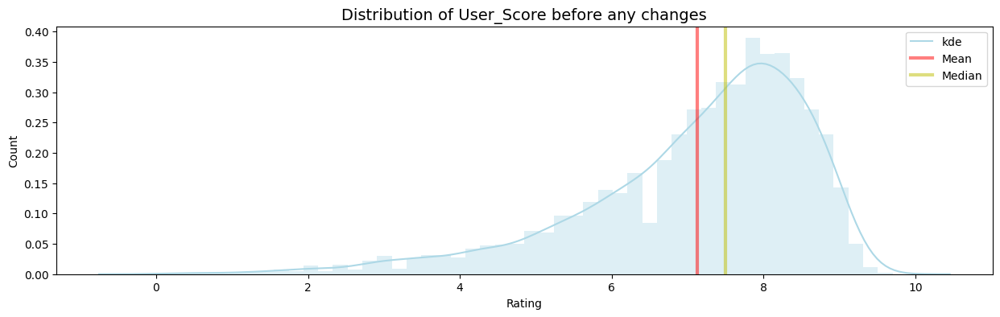

In [93]:
print('Skew:', round(df["User_Score"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["User_Score"].mean(), df["User_Score"].median()))
print('Standard Deviation: {:.2f}'.format(df["User_Score"].std()))

plt.figure(figsize = (15, 4))
sns.distplot(df["User_Score"], axlabel = col, color = "lightblue");
plt.axvline(df["User_Score"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["User_Score"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of User_Score before any changes", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')

plt.show()

Left the command to drop all na values of the feature "Critic_Score" commented below, as another way of adding data will be tested, if this does not work, it can be used to drop them all.

In [94]:
# df = df.drop(['User_Score'], axis = 1)

Using Simple Imputation to fill all missing values using the median as a strategy. 

In [95]:
imputer = SimpleImputer(strategy = 'median')

df["User_Score"] = imputer.fit_transform(df[["User_Score"]])

Next, it checking the distribution of "Critic_Score" feature after dealing with missing values, but now using it as a kdeplot once the "distplot" was not presenting a good visualisation.

Skew: -2.35
Mean: 7.33, Median: 7.50
Standard Deviation: 1.03


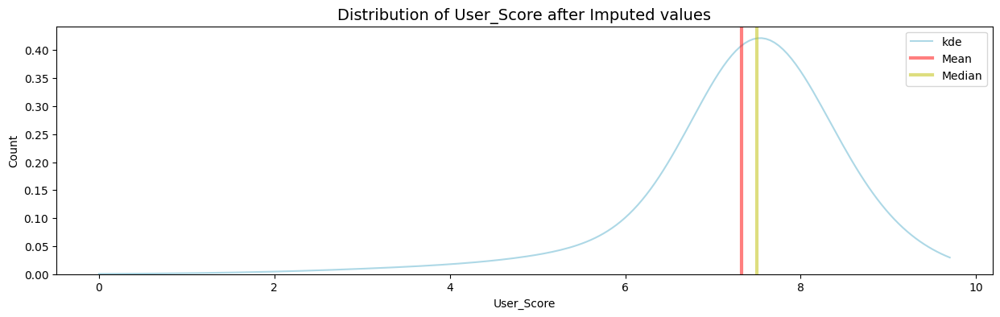

In [96]:
print('Skew:', round(df["User_Score"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["User_Score"].mean(), df["User_Score"].median()))
print('Standard Deviation: {:.2f}'.format(df["User_Score"].std()))

plt.figure(figsize = (15, 4))
sns.kdeplot(data = df, x = "User_Score", bw_adjust = 5, cut = 0, color = "lightblue")
plt.axvline(df["User_Score"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["User_Score"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of User_Score after Imputed values", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')
plt.show()

Before: Skew: -1.25, Mean: 7.13, Median: 7.50 and Standard Deviation: 1.50

After: Skew: -2.35, Mean: 7.33, Median: 7.50 and Standard Deviation: 1.03

Still "skewed to the right side", now a little worse than before.

In [97]:
df.isnull().sum()[df.isnull().sum() > 0]

User_Count    9127
Developer     6621
Rating        6767
dtype: int64

### 3.2.7 Checking/Handling Missing Data of User_Count Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "User_Count" feature, and we can see the existence of "nan" values.

The command below was left commented once returned to many values, making the visualisation complicated and large. 

In [98]:
# df["User_Count"].unique()

Getting the information about the total of missing values in this feature, in this case, 9127 values.

In [99]:
df[df["User_Count"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71.0,21.0,7.5,NaN,NaN,NaN
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71.0,21.0,7.5,NaN,NaN,NaN
5,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,71.0,21.0,7.5,NaN,NaN,NaN


The feature "Critic_Count" is missing 9127 values as 54.6 % of the total.

In [100]:
df[df["User_Count"].isnull()].shape[0]

9127

In [101]:
print("User_Count feature missing:", df["User_Count"].isnull().mean().round(3) * 100, "%")

User_Count feature missing: 54.6 %


Checking the distribution of "User_Count" feature before dealing with it.

Skew: 9.03
Mean: 162.23, Median: 24.00
Standard Deviation: 561.28


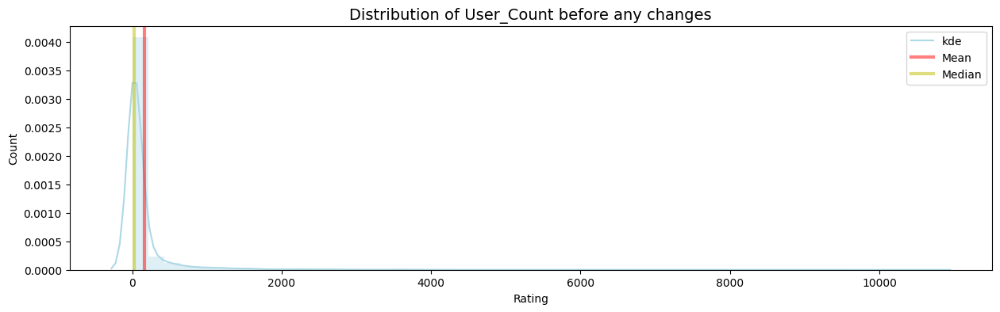

In [102]:
print('Skew:', round(df["User_Count"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["User_Count"].mean(), df["User_Count"].median()))
print('Standard Deviation: {:.2f}'.format(df["User_Count"].std()))

plt.figure(figsize = (15, 4))
sns.distplot(df["User_Count"], axlabel = col, color = "lightblue");
plt.axvline(df["User_Count"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["User_Count"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of User_Count before any changes", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')

plt.show()

Left the command to drop all na values of the feature "User_Count" commented below, as another way of adding data will be tested, if this does not work, it can be used to drop them all.

In [103]:
# df = df.drop(['User_Count'], axis = 1)

Using Simple Imputation to fill all missing values using the median as a strategy. 

In [104]:
imputer = SimpleImputer(strategy = 'median')

df["User_Count"] = imputer.fit_transform(df[["User_Count"]])

Next, it checking the distribution of "User_Count" feature after dealing with missing values, but now using it as a kdeplot once the "distplot" was not presenting a good visualisation.

Skew: 13.34
Mean: 86.76, Median: 24.00
Standard Deviation: 384.40


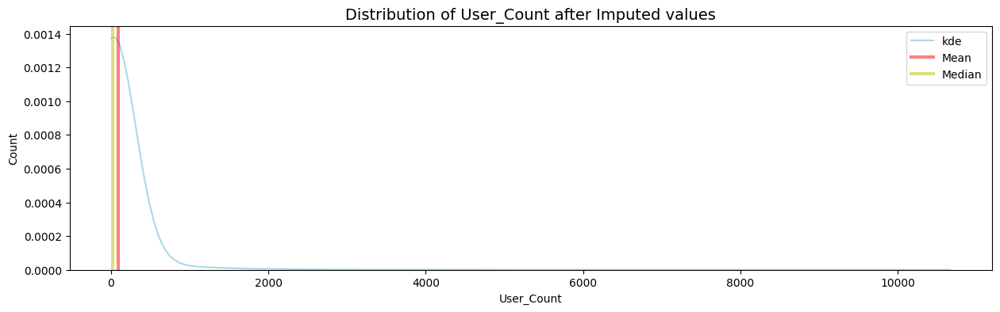

In [105]:
print('Skew:', round(df["User_Count"].skew(), 2))
print('Mean: {:.2f}, Median: {:.2f}'.format(df["User_Count"].mean(), df["User_Count"].median()))
print('Standard Deviation: {:.2f}'.format(df["User_Count"].std()))

plt.figure(figsize = (15, 4))
sns.kdeplot(data = df, x = "User_Count", bw_adjust = 5, cut = 0, color = "lightblue")
plt.axvline(df["User_Count"].mean(), linewidth = 3, color = 'r', label = "mean", alpha = 0.5)
plt.axvline(df["User_Count"].median(), linewidth = 3, color = 'y', label = "median", alpha = 0.5)
plt.title("Distribution of User_Count after Imputed values", size = 14)
plt.legend(["kde", "Mean", "Median"])
plt.ylabel('Count')
plt.show()

Before: Skew: 9.03, Mean: 162.23, Median: 24.00 and Standard Deviation: 561.28

After: Skew: 13.34, Mean: 86.76, Median: 24.00 and Standard Deviation: 384.40

Still "skewed to the left side", now a little worse than before.

In [106]:
df.isnull().sum()[df.isnull().sum() > 0]

Developer    6621
Rating       6767
dtype: int64

### 3.2.8 Checking/Handling Missing Data of Developer Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "Developer" feature, and we can see the existence of "nan" values.

In [107]:
df["Developer"].unique()

array(['Nintendo', nan, 'Good Science Studio', ..., 'Big Red Software',
       'Atomic Games', 'Interchannel-Holon'], dtype=object)

Getting the information about the total of missing values in this feature, in this case, 6621 values.

In [108]:
df[df["Developer"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71.0,21.0,7.5,24.0,NaN,NaN
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71.0,21.0,7.5,24.0,NaN,NaN
5,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,71.0,21.0,7.5,24.0,NaN,NaN


The feature "Critic_Count" is missing 6621 values as 39.6 % of the total.

In [109]:
df[df["Developer"].isnull()].shape[0]

6621

In [110]:
print("Developer feature missing:", df["Developer"].isnull().mean().round(3) * 100, "%")

Developer feature missing: 39.6 %


In this case, it opted to change the "NaN or Null" values to Unknown as did before with "Publisher" Feature, where in any case null values ​​are unknown, then it will be more acceptable to assign a text instead of deleting these observations that may be important for the analyses.

Left the command to drop all na values of the feature "Developer" commented below, in case of need.

In [111]:
# df = df.drop(['Developer'], axis = 1)

Next, replacing the null values to "Unknown".

In [112]:
df["Developer"].replace({None: "Unknown"}, inplace = True)

In [113]:
df.isnull().sum()[df.isnull().sum() > 0]

Rating    6767
dtype: int64

### 3.2.9 Checking/Handling Missing Data of Rating Feature

Checking Unique Values of the feature, checking the observations missing values, and more analyses to get a final decision about the missing values.

First, it checks the unique values of the "Rating" feature, and we can see the existence of "nan" values.

In [114]:
df["Rating"].unique()

array(['E', nan, 'M', 'T', 'E10+', 'K-A', 'AO', 'EC', 'RP'], dtype=object)

Getting the information about the total of missing values in this feature, in this case, 6767 values.

In [115]:
df[df["Rating"].isnull()].head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
1,Super Mario Bros.,NES,1985.0,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71.0,21.0,7.5,24.0,Unknown,NaN
4,Pokemon Red/Pokemon Blue,GB,1996.0,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71.0,21.0,7.5,24.0,Unknown,NaN
5,Tetris,GB,1989.0,Puzzle,Nintendo,23.20,2.26,4.22,0.58,30.26,71.0,21.0,7.5,24.0,Unknown,NaN


The feature "Critic_Count" is missing 6767 values as 40.5 % of the total.

In [116]:
df[df["Rating"].isnull()].shape[0]

6767

In [117]:
print("Rating feature missing:", df["Rating"].isnull().mean().round(3) * 100, "%")

Rating feature missing: 40.5 %


Before any changes, it created a "countplot" graphic to show how the values are in the feature.

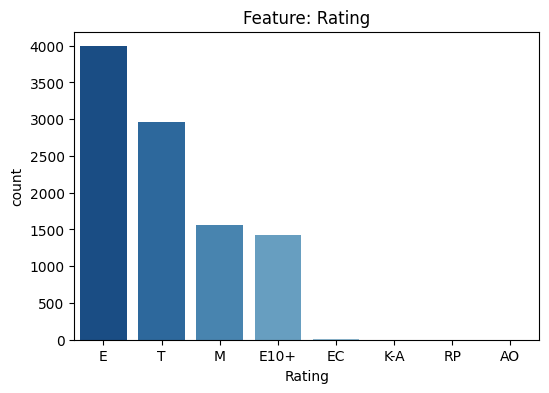

In [118]:
plt.figure(figsize = (6, 4))
sns.countplot(x = "Rating", data = df, palette = "Blues_r", order = df["Rating"].value_counts().index);
plt.title('Feature: Rating')
plt.show()

Then comparing the missing values with the actual values.

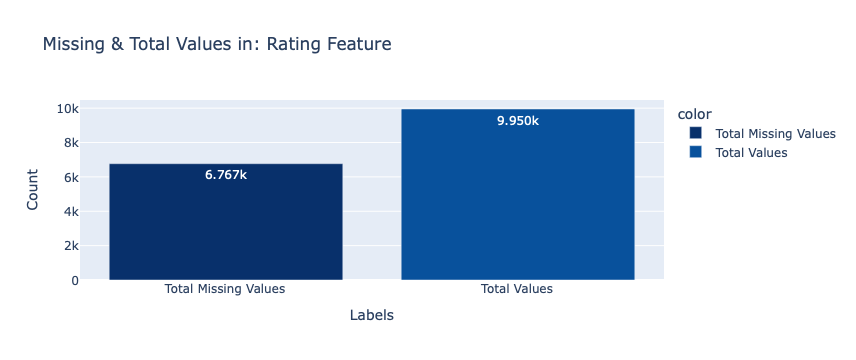

In [119]:
total_missing = df["Rating"].isnull().sum()[df["Rating"].isnull().sum() > 0][0]
total_values = len(df) - total_missing

labels = ['Total Missing Values', 'Total Values']
values = [total_missing, total_values]

fig = px.bar(df, y = values, x = labels, text_auto = '.4s',
            title = "Missing & Total Values in: Rating Feature",
            labels = {'x': 'Labels', 'y': 'Count'},
            color = labels, color_discrete_sequence = px.colors.sequential.Blues_r)
fig.show()

In this time, was not left a command to drop all na values of the feature "Rating" once it is necessary to deal with the values to answer a question in the future steps

Next, replacing the null values to "Unknown".

In [120]:
df["Rating"].replace({None: "Unknown"}, inplace = True)

Showing once again the "countplot" graphic, and is possible to see how big are the changes with missing values in this particular case.

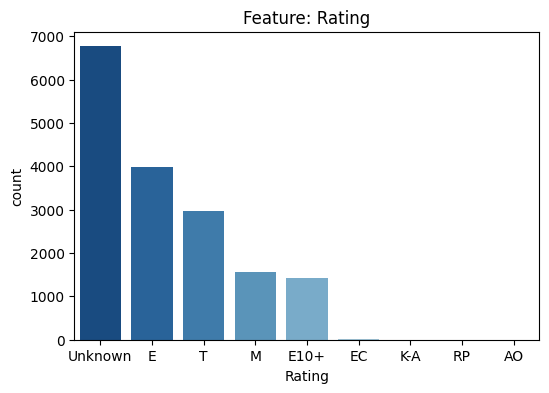

In [121]:
plt.figure(figsize = (6, 4))
sns.countplot(x = "Rating", data = df, palette = "Blues_r", order = df["Rating"].value_counts().index);
plt.title('Feature: Rating')
plt.show()

In [122]:
df.isnull().sum()[df.isnull().sum() > 0]

Series([], dtype: int64)

## 3.3 Checking missing data

Checking once again the missing values, and there were none, all of them had been dealt.

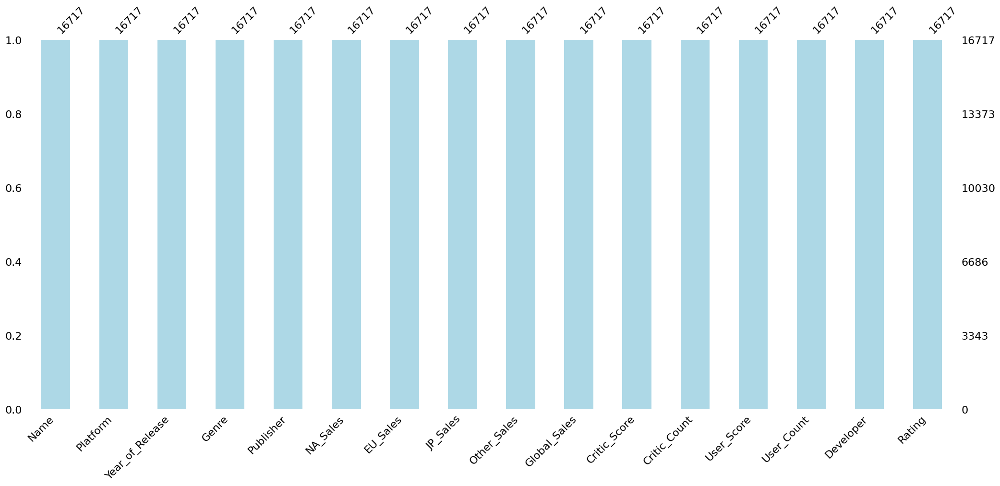

In [123]:
msno.bar(df, color = 'lightblue');

## 3.4 Data Types

Next, after changes, it analyses the data types of each feature with the data dictionary.

In [124]:
df.dtypes

Name                object
Platform            object
Year_of_Release    float64
Genre               object
Publisher           object
NA_Sales           float64
EU_Sales           float64
JP_Sales           float64
Other_Sales        float64
Global_Sales       float64
Critic_Score       float64
Critic_Count       float64
User_Score         float64
User_Count         float64
Developer           object
Rating              object
dtype: object

**Data Type**

`Object - Text`
- Name: Data Dictionary: Text | dtypes: object, ok
- Platform: Data Dictionary: Text | dtypes: object, ok

`Integer - int64` **convert** `float64 to int64`
- Year_of_Release: Data Dictionary: Integer | dtypes: float64, *

`Object - Text`
- Genre: Data Dictionary: Text | dtypes: object, ok
- Publisher: Data Dictionary: Text | dtypes: object, ok

`Float - float64`
- NA_Sales: Data Dictionary: Float | dtypes: float64, ok
- EU_Sales: Data Dictionary: Float | dtypes: float64, ok 
- JP_Sales: Data Dictionary: Float | dtypes: float64, ok
- Other_Sales: Data Dictionary: Float | dtypes: float64, ok
- Global_Sales: Data Dictionary: Float | dtypes: float64, ok

`Integer - int64` **convert** `float64 to int64`
- Critic_Score: Data Dictionary: Integer | dtypes: float64, * 
- Critic_Count: Data Dictionary: Integer | dtypes: float64, *

`Float - float64`
- User_Score: Data Dictionary: Float | dtypes: float64, ok

`Integer - int64` **convert** `float64 to int64`
- User_Count: Data Dictionary: Integer | dtypes: float64, *

`Object - Text`
- Developer: Data Dictionary: Text | dtypes: object, ok
- Rating: Data Dictionary: Text | dtypes: object, ok

Checks: Year_of_Release, Critic_Score, Critic_Count and User_Count `float64 to int64` 

Next converting the features `"Year_of_Release", "Critic_Score", "Critic_Count" and "User_Count"` to int using the command ".astype()"

In [125]:
df[["Year_of_Release", "Critic_Score", "Critic_Count", "User_Count"]] = df[["Year_of_Release", "Critic_Score", "Critic_Count", "User_Count"]].astype(int)

Checking once again the "dtypes" and "head" of the features, and now they are correctly based on the Data Dictionary.

In [126]:
df.dtypes

Name                object
Platform            object
Year_of_Release      int64
Genre               object
Publisher           object
NA_Sales           float64
EU_Sales           float64
JP_Sales           float64
Other_Sales        float64
Global_Sales       float64
Critic_Score         int64
Critic_Count         int64
User_Score         float64
User_Count           int64
Developer           object
Rating              object
dtype: object

In [127]:
df.head()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
0,Wii Sports,Wii,2006,Sports,Nintendo,41.36,28.96,3.77,8.45,82.53,76,51,8.0,322,Nintendo,E
1,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71,21,7.5,24,Unknown,Unknown
2,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.68,12.76,3.79,3.29,35.52,82,73,8.3,709,Nintendo,E
3,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.61,10.93,3.28,2.95,32.77,80,73,8.0,192,Nintendo,E
4,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71,21,7.5,24,Unknown,Unknown


## 3.5 Outliers

It is a fact that there are lots of outliers between the features, but it opted to keep them all, not removing any outliers, once these outliers could be no errors in the data, but just an unusual value in the observations with a different frequency.  

Checking the outliers of all numeric features below:

Box Plot of all numerical features


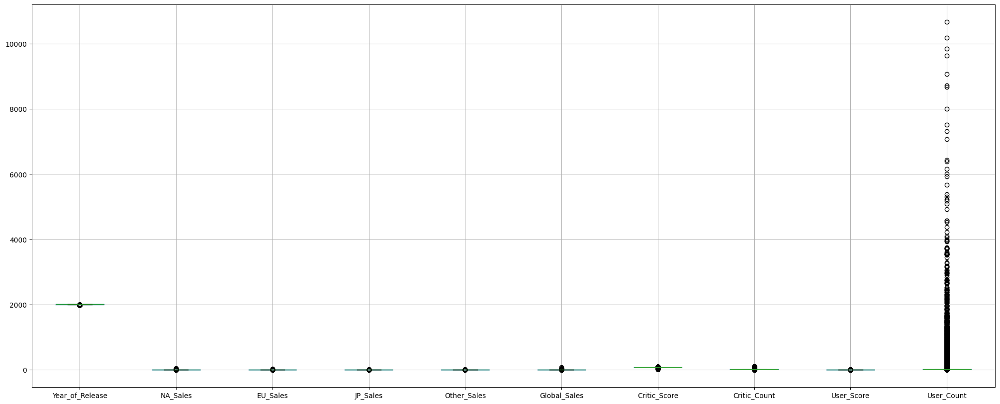

In [128]:
print("Box Plot of all numerical features")
df.boxplot(figsize = (25, 10));

Comparing outliers from sales features only.

Box Plot of all Sales features


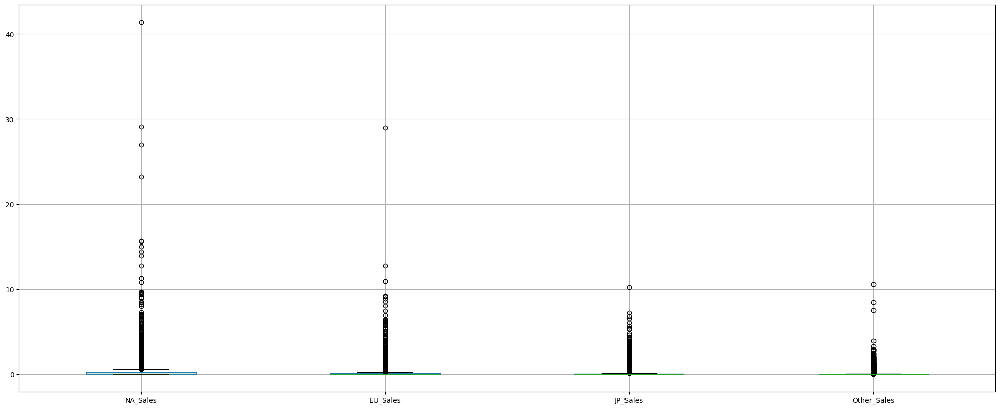

In [129]:
print("Box Plot of all Sales features")
df[["NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales"]].boxplot(figsize = (25, 10));

Comparing outliers from critic features only.

Box Plot of all Critic features


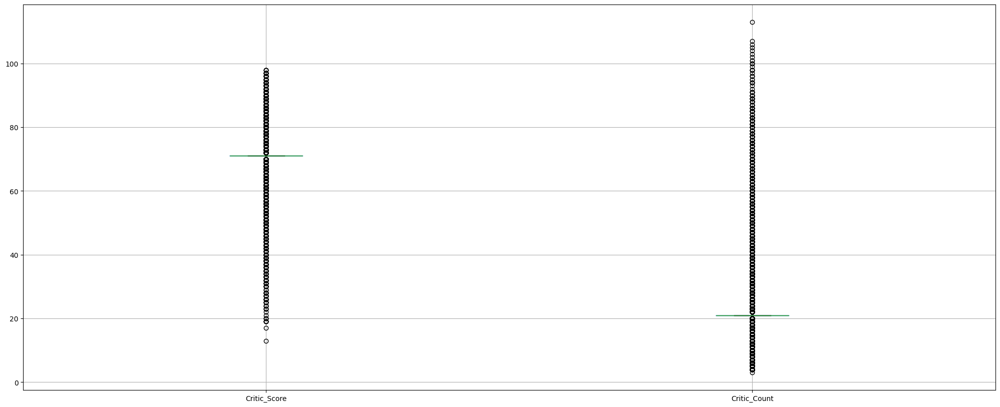

In [130]:
print("Box Plot of all Critic features")
df[["Critic_Score", "Critic_Count"]].boxplot(figsize = (25, 10));

Next, it was created some plots such as `"boxplot", "violinplot" and "stripplot"` for the features `"NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales", "Global_Sales", "Critic_Score", "Critic_Count", "User_Score"` to compare the distribution of these features in different perspective side by side.

NA_Sales
Skew: 18.78


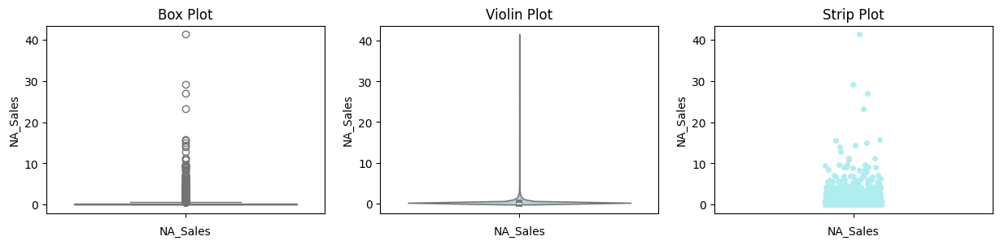

EU_Sales
Skew: 18.85


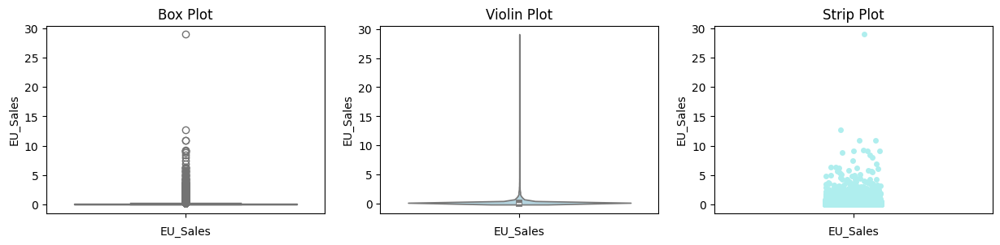

JP_Sales
Skew: 11.21


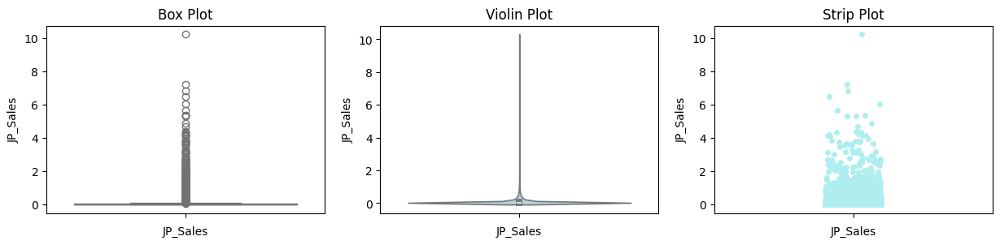

Other_Sales
Skew: 24.59


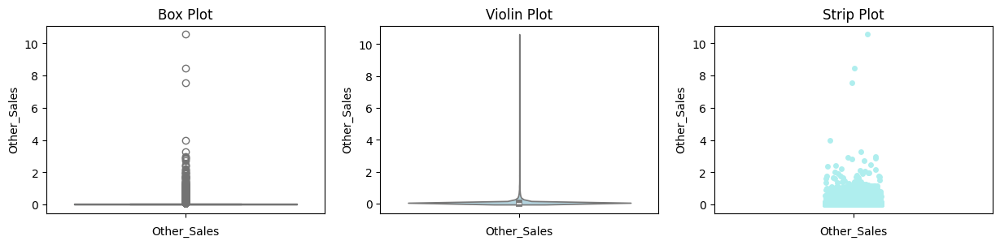

Global_Sales
Skew: 17.38


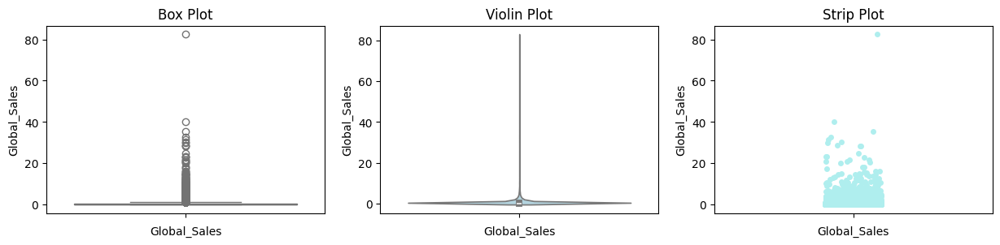

Critic_Score
Skew: -1.18


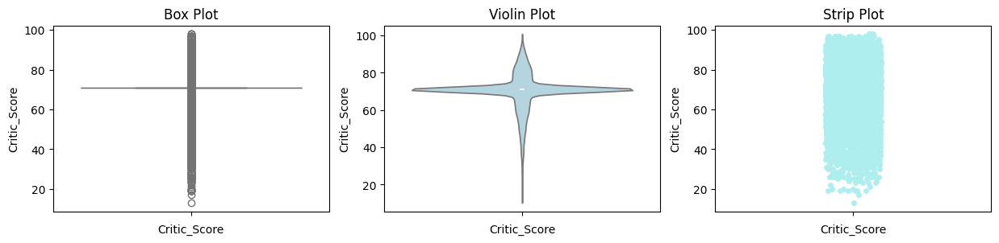

Critic_Count
Skew: 2.15


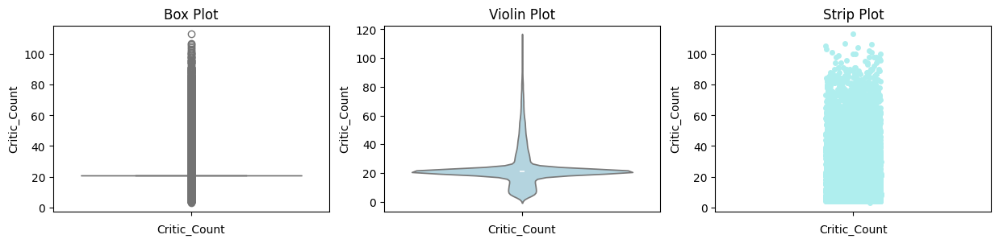

User_Score
Skew: -2.35


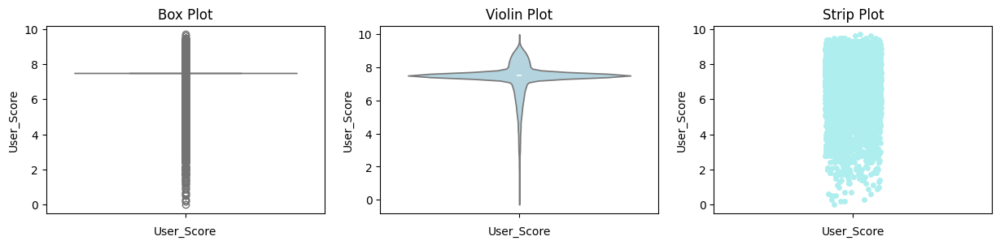

In [131]:
columns = ["NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales", "Global_Sales", "Critic_Score", "Critic_Count", "User_Score"]

for col in columns:
    print(col)
    print('Skew:', round(df[col].skew(), 2))
    
    plt.figure(figsize = (15, 3))
    plt.subplot(1, 3, 1)
    plt.title("Box Plot")
    sns.boxplot(data = df[col], color = "lightskyblue")
    plt.ylabel(col)
    plt.xlabel(col)
    
    plt.subplot(1, 3, 2)
    plt.title("Violin Plot")
    sns.violinplot(y = df[col], color = "lightblue")
    plt.xlabel(col)

    plt.subplot(1, 3, 3)
    plt.title("Strip Plot")
    sns.stripplot(y = df[col], color = "paleturquoise")
    plt.xlabel(col)

    plt.show()

## 3.6 Data Visualisation

This part is dedicated to answer the following questions: 

Part 1: (Column Names are denoted by quotation marks)
- 1 What are the top 5 games by global sales?
- 2 Is there a correlation between the “na_sales” and “jp_sales” for the years 2010-2014?
- 3 What is the distribution of the most popular 4 game genres?
- 4 Do older games (2005 and earlier) have a higher MEAN “eu_sales” than newer games (after
2005)?
- 5 What are the 3 most common “developer” in the dataset?

### 3.6.1 Part 1: Data Visualisation

#### Part 1: 1 What are the top 5 games by global sales?

To answer the question it was used the method `"nlargest"` to "Return the first n rows with the largest values in columns, in descending order. The columns that are not specified are returned as well, but not used for ordering." (The Pandas Development Team, 2024c).

In this case, it is possible to see just the largest 5 "Global_Sales" values. 

In [132]:
df["Global_Sales"].nlargest(5)

0    82.53
1    40.24
2    35.52
3    32.77
4    31.37
Name: Global_Sales, dtype: float64

Next, it was updated the code to show the features `"Name", "Platform", "Year_of_Release", "Global_Sales"` for the 5 largest values in the "Global_Sales" feature.

In [133]:
df[["Name", "Platform", "Year_of_Release", "Global_Sales"]].nlargest(5, ["Global_Sales"])

,Name,Platform,Year_of_Release,Global_Sales
0,Wii Sports,Wii,2006,82.53
1,Super Mario Bros.,NES,1985,40.24
2,Mario Kart Wii,Wii,2008,35.52
3,Wii Sports Resort,Wii,2009,32.77
4,Pokemon Red/Pokemon Blue,GB,1996,31.37


Created a filter variable to store the expression and then used the Plotly library to display the result visually in a bar chart.

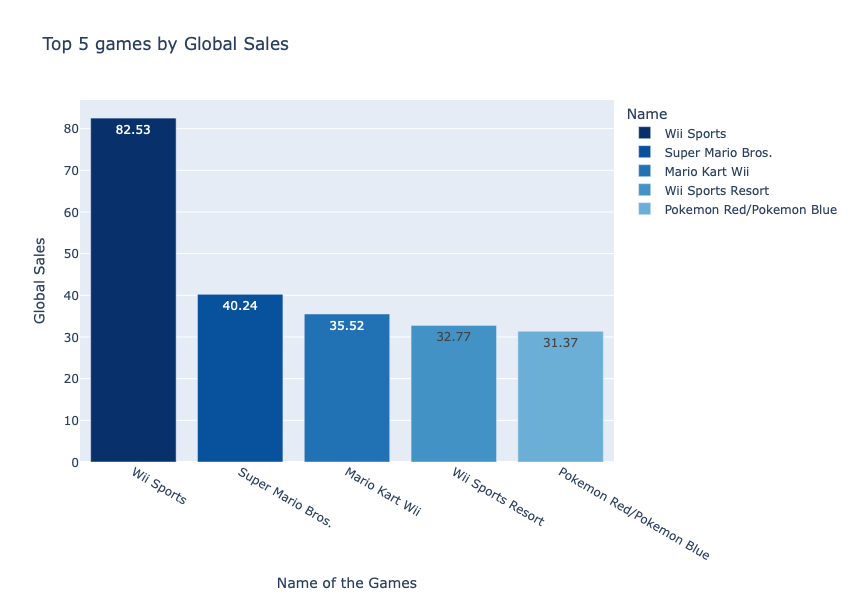

In [134]:
filter = df[["Name", "Platform", "Year_of_Release", "Global_Sales"]].nlargest(5, ['Global_Sales'])

fig = px.bar(filter, x = "Name", y = "Global_Sales", 
             text_auto ='.4s', title = "Top 5 games by Global Sales",
             color = "Name", color_discrete_sequence = px.colors.sequential.Blues_r,
             height = 600)

fig.update_layout(xaxis_title = "Name of the Games", yaxis_title = "Global Sales")
fig.show()

As a result of the Python expression returned as a table and next visualised as a graphic, the top five games by global sales are: 
- Wii Sports
- Super Mario Bros.
- Mario Kart Wii
- Wii Sports Resort
- Pokemon Red/Pokemon Blue

#### Part 1: 2 Is there a correlation between the “na_sales” and “jp_sales” for the years 2010-2014?

To answer the question it was used the method "query" to "Query the columns of a DataFrame with a boolean expression." with the "and" expression to complete to get a filter between two conditions first the year greater or equal to 2010 and years less or equal to 2014 (The Pandas Development Team, 2024d).

In [135]:
df.query("Year_of_Release >= 2010 and Year_of_Release <= 2014").head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
14,Kinect Adventures!,X360,2010,Misc,Microsoft Game Studios,15.00,4.89,0.24,1.69,21.81,61,45,6.3,106,Good Science Studio,E
16,Grand Theft Auto V,PS3,2013,Action,Take-Two Interactive,7.02,9.09,0.98,3.96,21.04,97,50,8.2,3994,Rockstar North,M
23,Grand Theft Auto V,X360,2013,Action,Take-Two Interactive,9.66,5.14,0.06,1.41,16.27,97,58,8.1,3711,Rockstar North,M


After creating the expression it was created a new data frame named "corr_na_jp_sales" to store just the information of the specific years, also used the method "unique" to check if it were returned just the correct years of the expression.

In [136]:
corr_na_jp_sales = df.query("Year_of_Release >= 2010 and Year_of_Release <= 2014")
corr_na_jp_sales["Year_of_Release"].unique()

array([2010, 2013, 2011, 2012, 2014])

Next it was used a "Heatmap" from the library "Plotly" to show the correlation between the features `"NA_Sales and JP_Sales"`, "The term "heatmap" usually refers to a Cartesian plot with data visualized as colored rectangular tiles, which is the subject of this page. It is also sometimes used to refer to actual maps with density data displayed as color intensity." (Plotly, 2019), also displayed the correlation table below it.

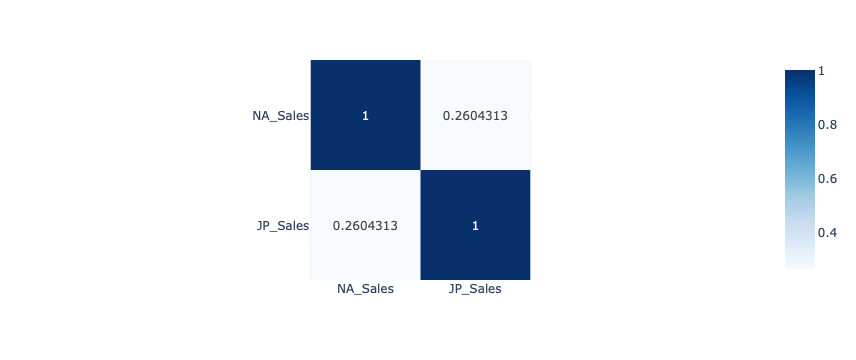

,NA_Sales,JP_Sales
NA_Sales,1.000000,0.260431
JP_Sales,0.260431,1.000000


In [137]:
fig = px.imshow(corr_na_jp_sales[["NA_Sales", "JP_Sales"]].corr(), 
                color_continuous_scale = 'Blues', text_auto = True)

fig.show()

corr_na_jp_sales[["NA_Sales", "JP_Sales"]].corr()

Getting the correlation value between both features, returned in this case **0.26**, showing that a value closer to 0 is indicative of a weak relationship and closer to 1 is indicative of a stronger relationship, in this case, both features there is a weak correlation between each other. 

In [138]:
corr_na_jp_sales["NA_Sales"].corr(corr_na_jp_sales["JP_Sales"])

0.2604313477881001

The next steps are some attempts to further verify whether or not there is a correlation between the two columns.

It will be used the "`pearsonr`" correlations method to "measures the linear relationship between two datasets. Like other correlation coefficients, this one varies between -1 and +1 with 0 implying no correlation. Correlations of -1 or +1 imply an exact linear relationship. Positive correlations imply that as x increases, so does y. Negative correlations imply that as x increases, y decreases." (Scipy, 2019).

Importing "`stats`" from "scipy" in "3.6.1 topic" to use "Pearson correlation coefficient".

In [139]:
from scipy import stats

Assumption Check

- H₀: There is a correlation between the “na_sales” and “jp_sales”.
- H₁: There is NO correlation between the “na_sales” and “jp_sales”.

Assume that α = 0.05. If the p-value is > 0.05, it can be said that there is a correlation between the “na_sales” and “jp_sales” for the years 2010-2014.

In [140]:
statistic, pvalue = stats.pearsonr(corr_na_jp_sales["NA_Sales"], corr_na_jp_sales["JP_Sales"])
print("PearsonRResult(statistic =", statistic, "and pvalue =", pvalue)

PearsonRResult(statistic = 0.260431347788098 and pvalue = 1.3283940672951648e-65


In [141]:
pearsonr_result = stats.pearsonr(corr_na_jp_sales["NA_Sales"], corr_na_jp_sales["JP_Sales"])

p, x = pearsonr_result[1], "reject" if pearsonr_result[1] < 0.05 else "accept"
 
print(f"The p-value is {pearsonr_result[1]} and hence we {x} the null Hypothesis with {pearsonr_result[0]} personr statistic")

The p-value is 1.3283940672951648e-65 and hence we reject the null Hypothesis with 0.260431347788098 personr statistic


Hypothesis testing it was tested after read the "Hypothesis Testing with Python: Step by step hands-on tutorial with practical examples" (Polat, 2022), also "How To Calculate Correlation Among Categorical Variables?" (mlexplained, 2023), "Using Contingency Tables to Find Associations Between Categorical Variables in Python" (Ibezim, 2023) and checked about the correlation in datacamp website "Python Details on Correlation Tutorial" (DataCamp, 2022).

Importing "`statsmodels.api`" as "sm" in "3.6.1 topic" to use "OLS" Model.

In [142]:
import statsmodels.api as sm

Next, testing the "One-Way ANOVA Test using OLS Model" with "NA_Sales" and "JP_Sales"

In [143]:
model = sm.OLS(corr_na_jp_sales["NA_Sales"], corr_na_jp_sales["JP_Sales"]).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:               NA_Sales   R-squared (uncentered):                   0.102
Model:                            OLS   Adj. R-squared (uncentered):              0.102
Method:                 Least Squares   F-statistic:                              475.0
Date:                Sun, 20 Oct 2024   Prob (F-statistic):                   8.03e-100
Time:                        22:14:59   Log-Likelihood:                         -4185.9
No. Observations:                4169   AIC:                                      8374.
Df Residuals:                    4168   BIC:                                      8380.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
JP_Sales       0.8992      0.041     21.795      0.000       0.818       0.980
==============================================================================
Omnibus:                     6019.533   Durbin-Watson:                   0.672
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2793799.673
Skew:                           8.456   Prob(JB):                         0.00
Kurtosis:                     128.687   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Next," seeing if the overall model is significant" (guest_blog, 2020).

In [144]:
print(f"Overall model F({model.df_model: .0f},{model.df_resid: .0f}) = {model.fvalue: .3f}, p = {model.f_pvalue: .4f}")

Overall model F( 1, 4168) =  475.011, p =  0.0000


Next, testing the "One-Way ANOVA Test using OLS Model" with "JP_Sales" and "NA_Sales"

In [145]:
model = sm.OLS(corr_na_jp_sales["JP_Sales"], corr_na_jp_sales["NA_Sales"]).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:               JP_Sales   R-squared (uncentered):                   0.102
Model:                            OLS   Adj. R-squared (uncentered):              0.102
Method:                 Least Squares   F-statistic:                              475.0
Date:                Sun, 20 Oct 2024   Prob (F-statistic):                   8.03e-100
Time:                        22:14:59   Log-Likelihood:                          123.47
No. Observations:                4169   AIC:                                     -244.9
Df Residuals:                    4168   BIC:                                     -238.6
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
NA_Sales       0.1138      0.005     21.795      0.000       0.104       0.124
==============================================================================
Omnibus:                     6888.771   Durbin-Watson:                   2.069
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          5646447.358
Skew:                          10.951   Prob(JB):                         0.00
Kurtosis:                     181.957   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Next," seeing if the overall model is significant" (guest_blog, 2020).

In [146]:
print(f"Overall model F({model.df_model: .0f},{model.df_resid: .0f}) = {model.fvalue: .3f}, p = {model.f_pvalue: .4f}")

Overall model F( 1, 4168) =  475.011, p =  0.0000


Next, it using Shapiro-Wilk test as "shapiro" and plotting a "qqplot" Quantile-Quantile Plot to check if the data points lie to the line for hence that it follows or not a normal distribution, and also shows a possible "Positive Correlation: Two variables are said to be positively correlated when their values move in the same direction." (DataCamp, 2022).

The distribution seems to be "Heavy tails", "the points fall along a line in the middle of the graph, but curve off in the extremities. Normal QQ plots that exhibit this behaviour usually mean your data have more extreme values than would be expected if they truly came from a normal distribution." (Ford, 2015), also read about "qqplot (Quantile-Quantile Plot) in Python" in GeeksforGeeks (GeeksforGeeks, 2019).

ShapiroResult(statistic= 0.3272066668489161 , pvalue 3.691417710908333e-82


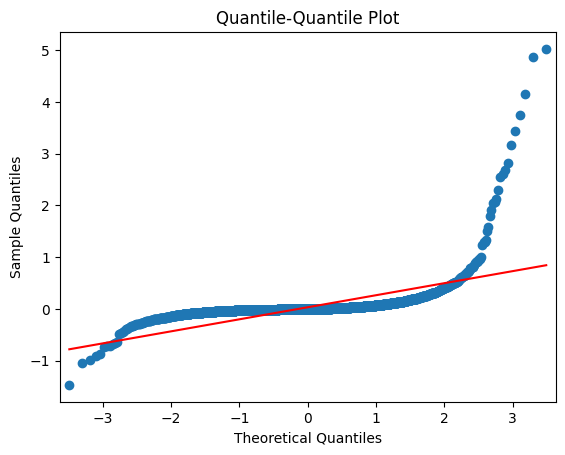

In [147]:
statistic, pvalue = stats.shapiro(model.resid)
print("ShapiroResult(statistic=", statistic, ", pvalue", pvalue)

res = model.resid
fig = sm.qqplot(res, line = 's')

plt.title("Quantile-Quantile Plot")
plt.show()

Next plotting a scatter plot from the library "Plotly" to check how "each data point is represented as a marker point, whose location is given by the x and y columns." (Plotly, 2024b).

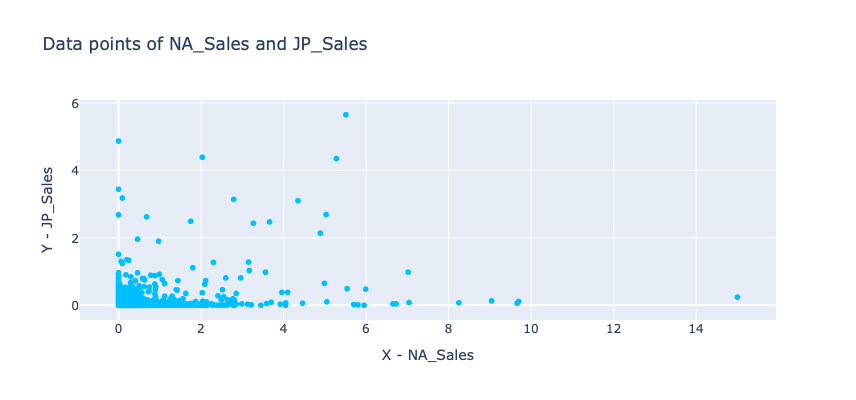

In [148]:
fig = px.scatter(corr_na_jp_sales, x = "NA_Sales", y = "JP_Sales", 
                title = "Data points of NA_Sales and JP_Sales",
                color_discrete_sequence = ['deepskyblue'],
                height = 400)
fig.update_layout(xaxis_title = "X - NA_Sales", yaxis_title = "Y - JP_Sales")
fig.show()

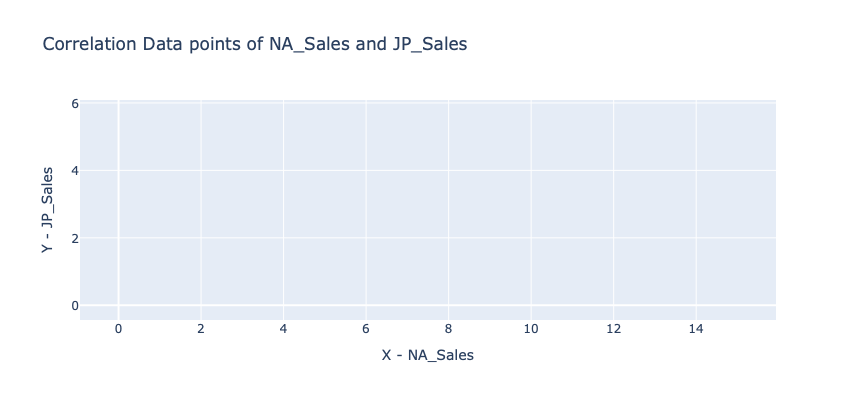

In [149]:
fig = px.scatter(corr_na_jp_sales, x = "NA_Sales", y = "JP_Sales", 
                 title = "Correlation Data points of NA_Sales and JP_Sales",
                 trendline = "ols", color_discrete_sequence = ['deepskyblue'],
                 height = 400)
fig.update_layout(xaxis_title = "X - NA_Sales", yaxis_title = "Y - JP_Sales")
fig.show()

Next, it plotting a "pairplot" from both features.

Pairplot of NA and JP Sales


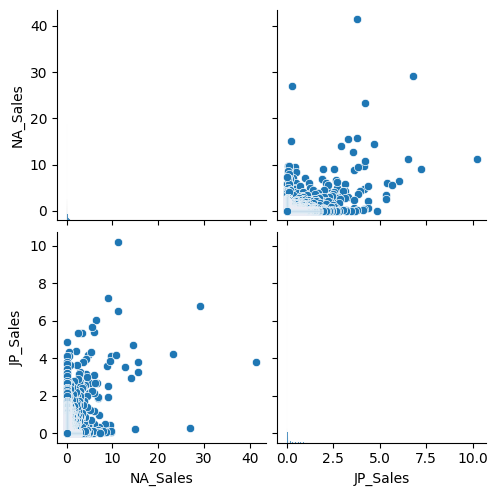

In [150]:
print("Pairplot of NA and JP Sales")
sns.pairplot(data = df, vars = ["NA_Sales", "JP_Sales"]);

After analyses, looks like the relationship exists, but is it weak, not too strong, therefore the answer it will be yes, there is a correlation between the “NA_Sales” and “JP_Sales” for the years 2010-2014.

#### Part 1: 3 What is the distribution of the most popular 4 game genres?

Checking the head of the data frame to see which feature could be used to answer this question.

In [151]:
df.head()

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
0,Wii Sports,Wii,2006,Sports,Nintendo,41.36,28.96,3.77,8.45,82.53,76,51,8.0,322,Nintendo,E
1,Super Mario Bros.,NES,1985,Platform,Nintendo,29.08,3.58,6.81,0.77,40.24,71,21,7.5,24,Unknown,Unknown
2,Mario Kart Wii,Wii,2008,Racing,Nintendo,15.68,12.76,3.79,3.29,35.52,82,73,8.3,709,Nintendo,E
3,Wii Sports Resort,Wii,2009,Sports,Nintendo,15.61,10.93,3.28,2.95,32.77,80,73,8.0,192,Nintendo,E
4,Pokemon Red/Pokemon Blue,GB,1996,Role-Playing,Nintendo,11.27,8.89,10.22,1.00,31.37,71,21,7.5,24,Unknown,Unknown


In this case, it will consider the feature "Global_Sales" to check the most popular games, once the number of sales can be also the answer for popularity.

Used the method "groupby" to group the genres by Global_Sales, a practice learned by "Pandas Count The Frequency of a Value in Column" (Naveen Nelamali, 2021) and "Pandas GroupBy Multiple Columns Explained" (Naveen Nelamali, 2022).

In [152]:
df.groupby("Genre")["Global_Sales"].sum().nlargest(4)

Genre
Action          1745.27
Sports          1332.00
Shooter         1052.94
Role-Playing     934.40
Name: Global_Sales, dtype: float64

Next, it used a simple plot, to represent the results on a graphic with a bar plot.

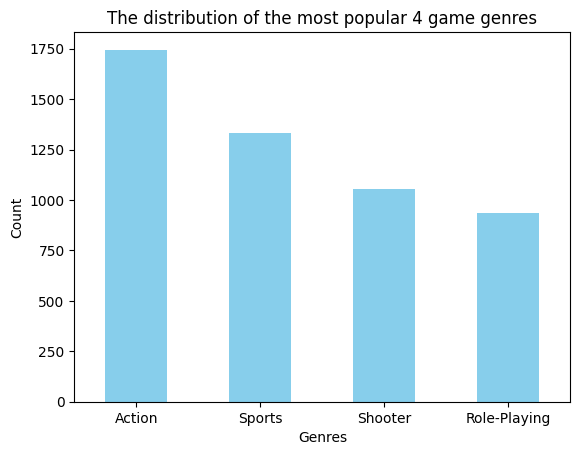

In [153]:
filter = df.groupby("Genre")["Global_Sales"].sum().nlargest(4)

plt.title("The distribution of the most popular 4 game genres")
filter.plot(kind = 'bar', color = 'skyblue')
plt.xlabel("Genres")
plt.ylabel("Count")
plt.xticks(rotation = 0)
plt.show()

Next, it plotted a bar chat using the "Plotly" library, paramethers of colours learned on "plotly.express.colors package" documentation. (Plotly, 2024a)

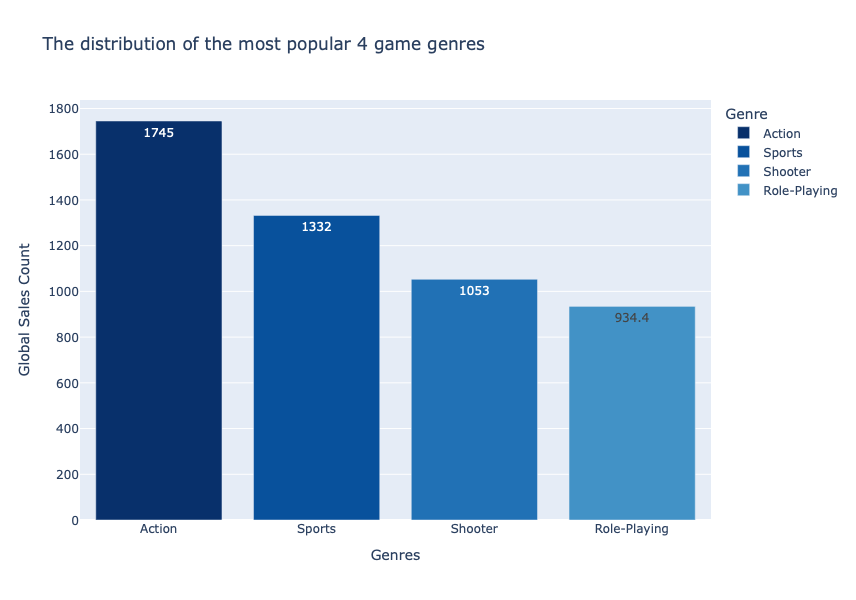

In [154]:
filter = df.groupby("Genre")["Global_Sales"].sum().nlargest(4).reset_index()

fig = px.bar(filter, x = "Genre", y = "Global_Sales", 
             text_auto ='.4', title = "The distribution of the most popular 4 game genres",
             color = "Genre", color_discrete_sequence = px.colors.sequential.Blues_r,
             height = 600)

fig.update_layout(xaxis_title = "Genres", yaxis_title = "Global Sales Count")
fig.show()

In this case, we got the distribution of the most popular 4 game genres, first, gender Action with 1745.27 total in Global Sales, followed by Sports with 1332.00 Sales, Shooter with 1052.94 Sales and Role-Playing with 934.40 Sales.

#### Part 1: 4 Do older games (2005 and earlier) have a higher MEAN “eu_sales” than newer games (after 2005)?

To answer the question it was used the method "query" to save in the new data frame variable called "older_games" just the years less or equal to 2005 and in the data frame variable called "newer_games" just the years greater than 2005.

In [155]:
older_games = df.query("Year_of_Release <= 2005")
newer_games = df.query("Year_of_Release > 2005")

Next, it getting the mean of the "EU_Sales" in older_games, returned "0.14787759777450502"

In [156]:
older_games["EU_Sales"].mean()

0.14787759777450502

Next, it getting the mean of the "EU_Sales" in newer_games, returned "0.14335847633415047"

In [157]:
newer_games["EU_Sales"].mean()

0.14335847633415047

Next, it created an if condition to check whether the older games have a higher mean than newer games.

In [158]:
if older_games["EU_Sales"].mean() > newer_games["EU_Sales"].mean():
    print("Yes: older games (2005 and earlier) have a higher MEAN “eu_sales” than newer games (after 2005)")
else:
    print("No: older games (2005 and earlier) does not have a higher MEAN “eu_sales” than newer games (after 2005)")

Yes: older games (2005 and earlier) have a higher MEAN “eu_sales” than newer games (after 2005)


Then, it compares the mean of the total of older games with the total number of newer games.

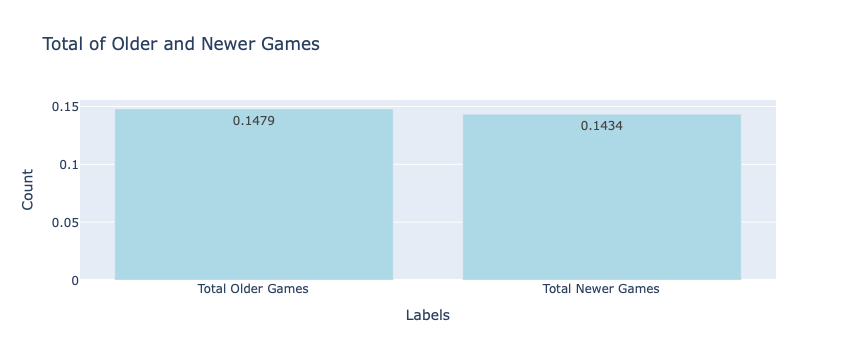

In [159]:
total_older_games = older_games["EU_Sales"].mean()
total_newer_games = newer_games["EU_Sales"].mean()

labels = ['Total Older Games', 'Total Newer Games']
values = [total_older_games, total_newer_games]

fig = px.bar(df, y = values, x = labels, text_auto = '.4',
            title = "Total of Older and Newer Games",
            labels = {'x': 'Labels', 'y': 'Count'},
            color_discrete_sequence = ['lightblue'])

fig.show()

Also, created a pie chart to check the percentage of the Total Older Games and Newer Games

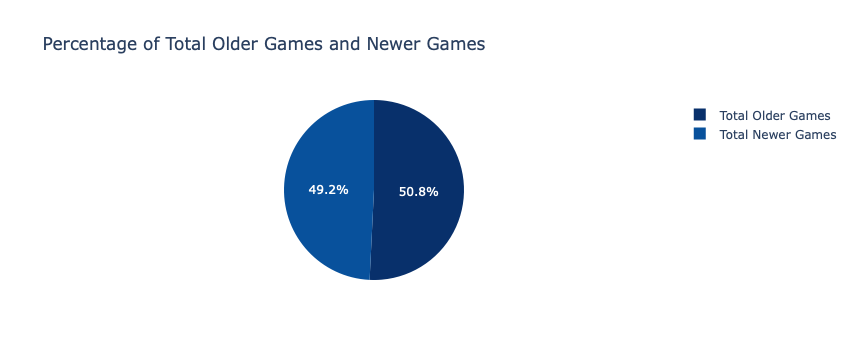

In [160]:
fig = px.pie(df, values = values, names = labels, 
             color_discrete_sequence = px.colors.sequential.Blues_r,
             title = "Percentage of Total Older Games and Newer Games")
fig.show()

As analysed before, the answer is: Yes, the older games (2005 and earlier) have a higher MEAN “eu_sales” than newer games (after 2005).

#### Part 1: 5 What are the 3 most common “developer” in the dataset?

To answer the question, first, it creating a new data frame called "df_Developer" to ignore every value in the feature "Developer" as Unknown.

In [161]:
df_Developer = df[df["Developer"] != "Unknown"]

Next, it uses the method "value_counts()" to count the values and get just the three most common or greatest

In [162]:
df_Developer["Developer"].value_counts()[:3]

Developer
Ubisoft      204
EA Sports    172
EA Canada    167
Name: count, dtype: int64

Next, plotting it in a graphic to visualise it better.

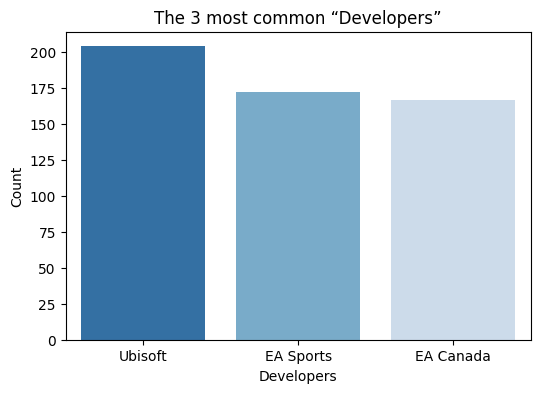

In [163]:
plt.figure(figsize = (6, 4))
sns.countplot(x = "Developer", data = df_Developer, palette = "Blues_r", order = df_Developer["Developer"].value_counts().index[:3]);
plt.title('The 3 most common “Developers”')
plt.xlabel("Developers")
plt.ylabel("Count")
plt.show()

In this case, the three most common developers are Ubisoft, EA Sports and EA Canada.

### 3.6.2 Part 2: Data Visualisation

Part 2 
- You must answer a “Statistically Relevant” question, OF YOUR OWN CHOOSING, using the dataset,
that has not been asked in Part 1. This must have a logical basis that enhances the information and
insight gained in the scenario.

- 1 What is the Distribution of the 5 common Genders
- 2 What are the Top 5 Games by EU Sales
- 3 What is the distribution of Sales by Region
- 4 What is the Sales by platform from 2010
- 5 What are the 5 Games with the most Critic Scores of all times
- 6 Correlation between Critic Scores/Critic Count and User Score/User Count
- 7 What is the Global Sales total per Publisher 
- 8 Total of Global Sales per Publisher by Name
- 9 Total of EU Sales per Publisher by Genre and Name
- 10 Total of EU Sales per Publisher by Platform, Genre and Name
- 11 Total of Critic Score per Publisher by Platform, Genre and Name
- 12 What are the Eu Sales total per Genre 
- 13 What is the distribution of the most popular 4 game genres, by Critic Score, Critic Count, User Score and User Count
- 14 What is the distribution of the most popular "NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales", by Genre, Platform and Publisher

#### Part 2: 1 What is the Distribution of the 5 common Genders

Checked using "value_counts" in the feature "Genre" to check the 5 common genders, in this case represented as Action, Sports, Misc, Role-Playing and Shooter.

In [164]:
df['Genre'].value_counts()[:5]

Genre
Action          3370
Sports          2348
Misc            1750
Role-Playing    1500
Shooter         1323
Name: count, dtype: int64

Next, it plotted in a vertical and horizontal bar chart, it was essential to use the method ".index" in this part; otherwise, it would not return the results as expected, "The index of a DataFrame is a series of labels that identify each row. The labels can be integers, strings, or any other hashable type. The index is used for label-based access and alignment and can be accessed or modified using this attribute." (The Pandas Development Team, 2024b).

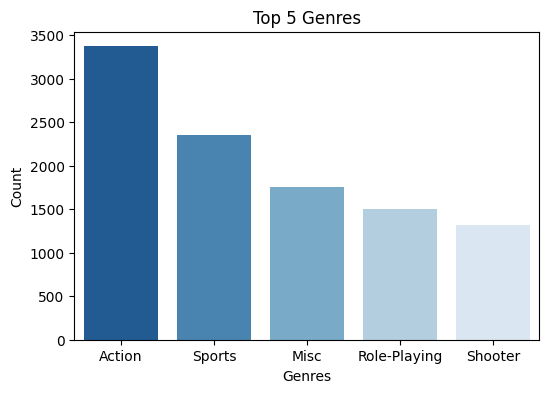

In [165]:
plt.figure(figsize = (6, 4))
sns.countplot(x = "Genre", data = df, palette = "Blues_r", order = df["Genre"].value_counts().index[:5]);
plt.title('Top 5 Genres')
plt.ylabel('Count')
plt.xlabel('Genres')
plt.show()

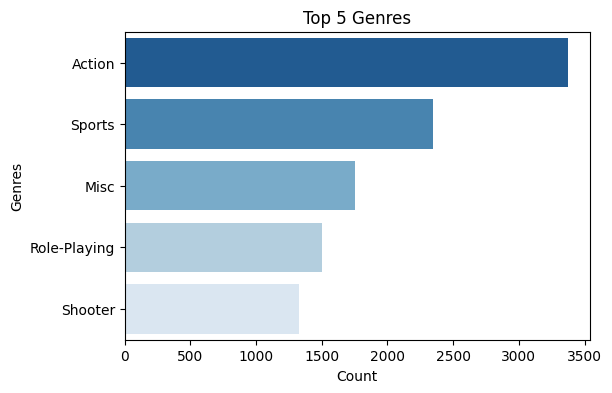

In [166]:
plt.figure(figsize = (6, 4))
sns.countplot(y = "Genre", data = df, palette = "Blues_r", order = df["Genre"].value_counts().index[:5]);
plt.title('Top 5 Genres')
plt.ylabel('Genres')
plt.xlabel('Count')
plt.show()

#### Part 2: 2 What are the Top 5 Games by EU Sales

In this case, used the method "nlargest" to get the top 5 games by EU Sales, represented as Wii Sports, Mario Kart Wii, Nintendogs, Wii Sports Resort and Brain Age: Train Your Brain in Minutes a Day, and plotted it next in a graphic using "Plotly".

In [167]:
df[["Name", "Platform", "Year_of_Release", "Genre", "EU_Sales"]].nlargest(5, ['EU_Sales']) 

,Name,Platform,Year_of_Release,Genre,EU_Sales
0,Wii Sports,Wii,2006,Sports,28.96
2,Mario Kart Wii,Wii,2008,Racing,12.76
10,Nintendogs,DS,2005,Simulation,10.95
3,Wii Sports Resort,Wii,2009,Sports,10.93
19,Brain Age: Train Your Brain in Minutes a Day,DS,2005,Misc,9.20


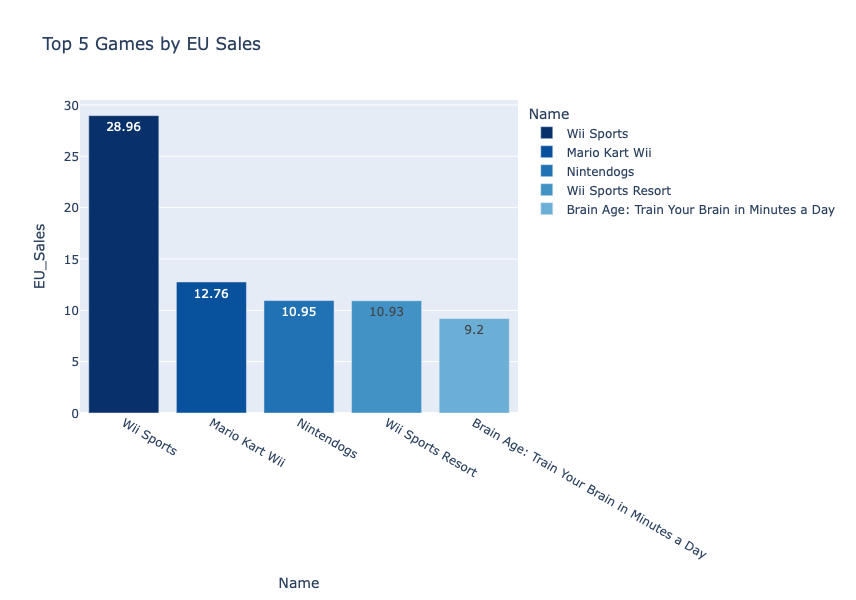

In [168]:
filter = df[["Name", "Platform", "Year_of_Release", "Genre", "EU_Sales"]].nlargest(5, ['EU_Sales'])  

fig = px.bar(filter, x = "Name", y = "EU_Sales", 
             text_auto ='.4', title = "Top 5 Games by EU Sales",
             color = 'Name', color_discrete_sequence = px.colors.sequential.Blues_r,
             height = 600)

fig.show()

#### Part 2: 3 What is the distribution of Sales by Region

Created a variable called "filter" to save the sum of the values of each Sales Feature.

In [169]:
filter = df[["NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales"]].sum()
filter

NA_Sales       4400.84
EU_Sales       2424.14
JP_Sales       1297.40
Other_Sales     791.26
dtype: float64

In [170]:
type(filter)

pandas.core.series.Series

After thinking about how the results came after the filter, it was trying to put them in the graphic, but it was not finding an acceptable way to use it and access the key value and value of the result to plot it, so after some research, it were remembered a basic tool and powerful to manipulate data in Python, dictionary, instead of tuples, list, series or arrays, so it was found the documentation of "to_dict", to convert the variable "filter" recognized as "Series" with the result to "dict" dictionary and be able to access keys and values. "Convert the DataFrame to a dictionary." (The Pandas Development Team, 2024e), next plotted in a graphic using "Plotly" in a bar chart and pie chart to check the proportion.

In [171]:
filter = filter.to_dict()
type(filter)

dict

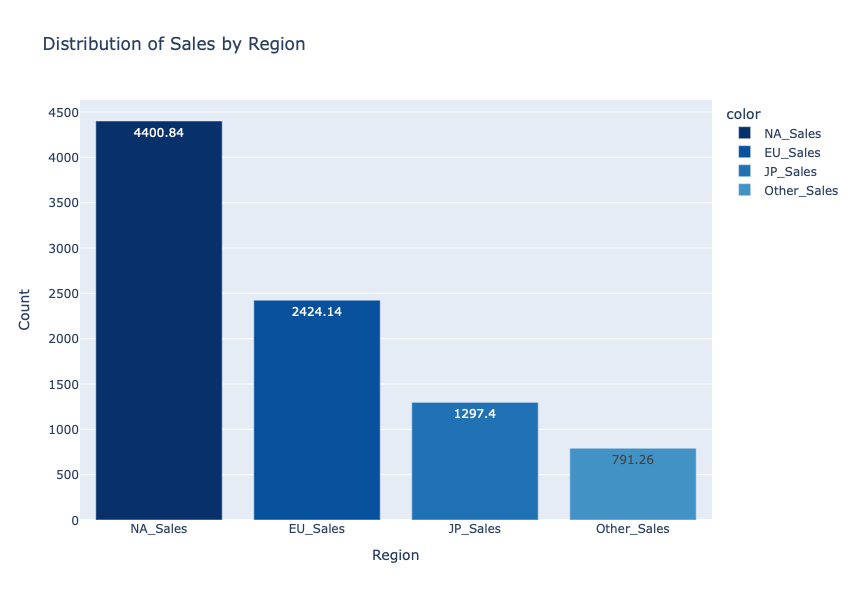

In [172]:
fig = px.bar(x = filter.keys(), y = filter.values(),
             text_auto ='.6', title = "Distribution of Sales by Region",
             labels = {'x': 'Region', 'y': 'Count'},
             color = filter.keys(), color_discrete_sequence = px.colors.sequential.Blues_r,
             height = 600)

fig.show()

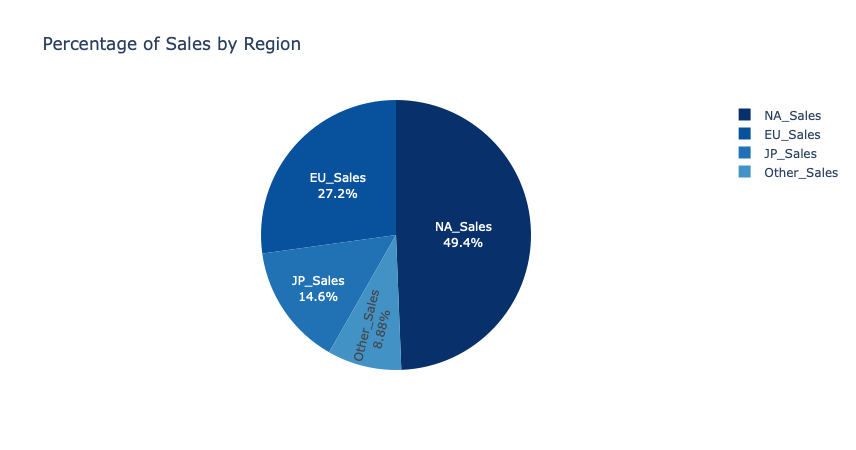

In [173]:
fig = px.pie(values = filter.values(), names = filter.keys(), 
             color_discrete_sequence = px.colors.sequential.Blues_r,
             title = "Percentage of Sales by Region", 
             height = 450)
fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.show()

After checking the results of sales from all times in the data set, it was noticed that North America is the most popular place in this niche, with 49.4% of the sales and the best profit in comparison to the other locations, followed by European 27.2%, Japanese 14.6% and Other Countries Not including N-America, Europe and Japan with 8.88%.

#### Part 2: 4 What is the Sales by platform from 2010

Creating a filter and saving in a new data frame called "df_up_2010" and show the head of it.

In [174]:
df_up_2010 = df[df["Year_of_Release"] > 2010]
df_up_2010.head(3)

,Name,Platform,Year_of_Release,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Critic_Score,Critic_Count,User_Score,User_Count,Developer,Rating
16,Grand Theft Auto V,PS3,2013,Action,Take-Two Interactive,7.02,9.09,0.98,3.96,21.04,97,50,8.2,3994,Rockstar North,M
23,Grand Theft Auto V,X360,2013,Action,Take-Two Interactive,9.66,5.14,0.06,1.41,16.27,97,58,8.1,3711,Rockstar North,M
29,Call of Duty: Modern Warfare 3,X360,2011,Shooter,Activision,9.04,4.24,0.13,1.32,14.73,88,81,3.4,8713,"Infinity Ward, Sledgehammer Games",M


Next plotting Stacked Bars to show the results using "Plotly".

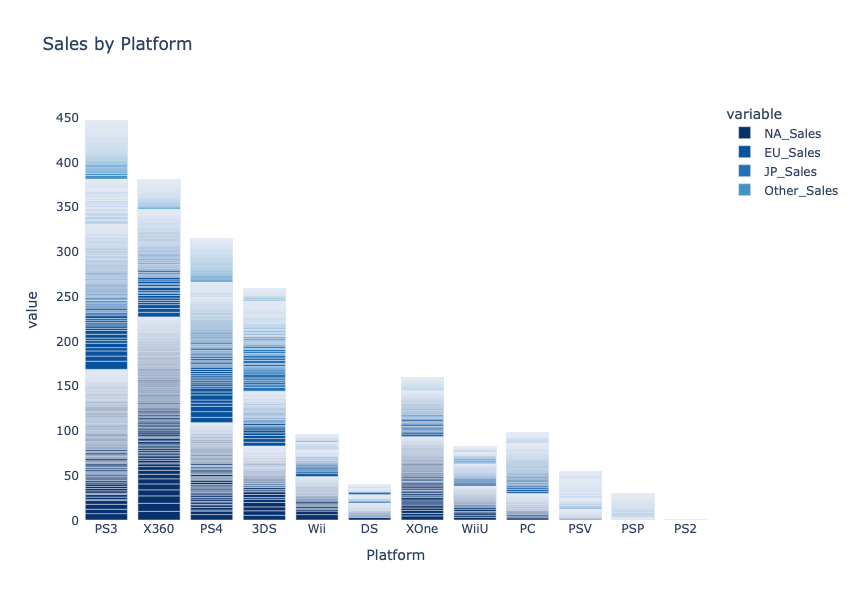

In [175]:
fig = px.bar(df_up_2010, x = "Platform", y = ["NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales"], 
             title = "Sales by Platform", height = 600,
             color_discrete_sequence = px.colors.sequential.Blues_r)
fig.update_layout(plot_bgcolor = "white")
fig.show()

#### Part 2: 5 What are the 5 Games with the most Critic Scores of all times

In this case, used the method "nlargest" to get the top 5 games by Critic Scores, represented as Need for Speed: Most Wanted, FIFA 14, Madden NFL 07, LEGO Marvel Super Heroes and Terraria, and plotted it next in a graphic using "Plotly".

In [176]:
df.groupby("Name")["Critic_Score"].sum().nlargest(5)

Name
Need for Speed: Most Wanted    904
FIFA 14                        716
Madden NFL 07                  702
LEGO Marvel Super Heroes       679
Terraria                       639
Name: Critic_Score, dtype: int64

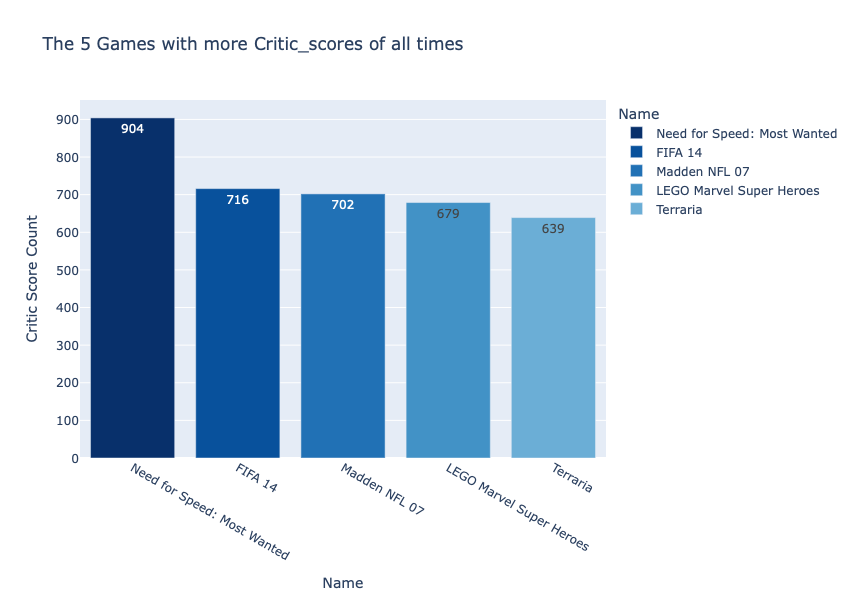

In [177]:
filter = df.groupby("Name")["Critic_Score"].sum().nlargest(5).reset_index()

fig = px.bar(filter, x = "Name", y = "Critic_Score", 
             text_auto ='.4', title = "The 5 Games with more Critic_scores of all times",
             color = 'Name', color_discrete_sequence = px.colors.sequential.Blues_r,
             height = 600)

fig.update_layout(xaxis_title = "Name", yaxis_title = "Critic Score Count")
fig.show()

#### Part 2: 6 Correlation between Critic Scores/Critic Count and User Score/User Count

Getting the correlation value between "Critic_Score and Critic_Count" features, returned 0.39, showing a value closer to 0 indicating a weak relationship. In this case, both features have a weak correlation with each other.

Next, it plotted a scatter plot from the library "Plotly" to visualise the data points on it.

Next, a "Heatmap" from the library "Plotly" was used to show the correlation between the features, and also displayed the correlation table below it.

In [178]:
df["Critic_Score"].corr(df["Critic_Count"])

0.3941863808910174

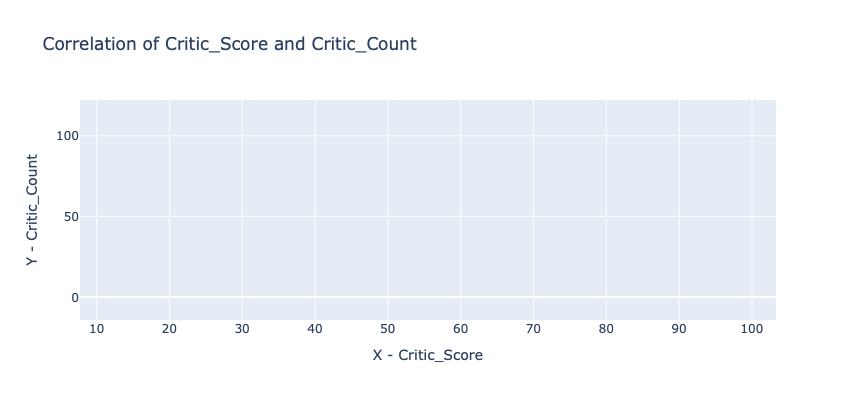

In [179]:
fig = px.scatter(df, x = "Critic_Score", y = "Critic_Count", 
                title = "Correlation of Critic_Score and Critic_Count",
                trendline = "ols", color_discrete_sequence = ['deepskyblue'],
                height = 400)
fig.update_layout(xaxis_title = "X - Critic_Score", yaxis_title = "Y - Critic_Count")
fig.show()

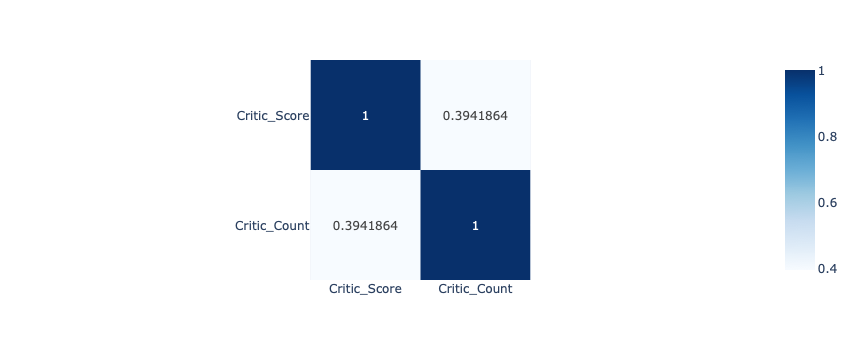

,Critic_Score,Critic_Count
Critic_Score,1.000000,0.394186
Critic_Count,0.394186,1.000000


In [180]:
fig = px.imshow(df[["Critic_Score", "Critic_Count"]].corr(), 
                color_continuous_scale = 'Blues', text_auto = True)

fig.show()

df[["Critic_Score", "Critic_Count"]].corr()

Next, getting the correlation value between "User_Score and User_Count" features returned -0.006, showing a value closer below 0, indicating no relationship.

Next, it plotted a scatter plot from the library "Plotly" to visualise the data points on it.

Next, a "Heatmap" from the library "Plotly" was used to show the correlation between the features, and also displayed the correlation table below it.

In [181]:
df["User_Score"].corr(df["User_Count"])

-0.006357299233494958

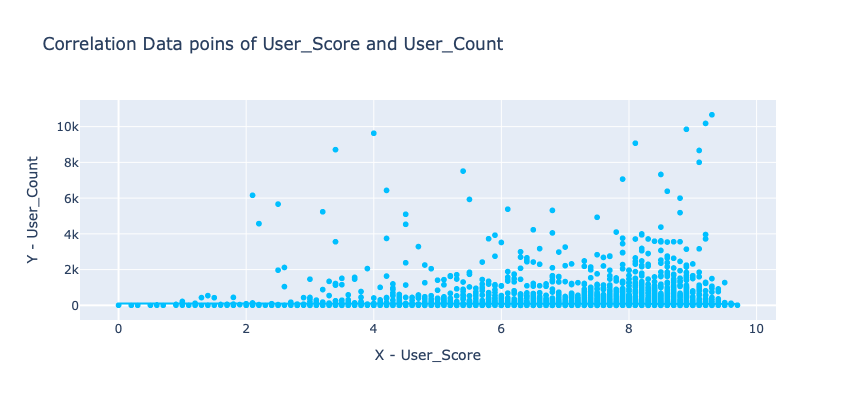

In [182]:
fig = px.scatter(df, x = "User_Score", y = "User_Count", 
                 title = "Correlation Data poins of User_Score and User_Count",
                 trendline = "ols", color_discrete_sequence = ['deepskyblue'],
                 height = 400)
fig.update_layout(xaxis_title = "X - User_Score", yaxis_title = "Y - User_Count")
fig.show()

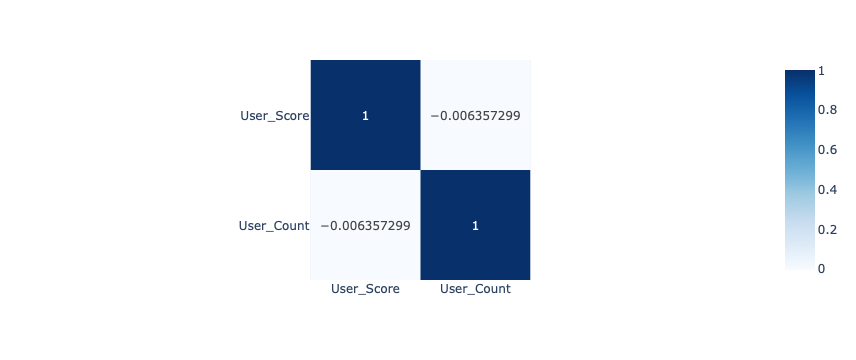

,User_Score,User_Count
User_Score,1.000000,-0.006357
User_Count,-0.006357,1.000000


In [183]:
fig = px.imshow(df[["User_Score", "User_Count"]].corr(), 
                color_continuous_scale = 'Blues', text_auto = True)

fig.show()

df[["User_Score", "User_Count"]].corr()

#### Part 2: 7 What is the Global Sales total per Publisher 

In this case, the method "groupby" was used to group the Publishers by Global_Sales and check the first 5 popular publishers.

In [184]:
df.groupby("Publisher")["Global_Sales"].sum().nlargest()

Publisher
Nintendo                       1788.81
Electronic Arts                1116.96
Activision                      731.16
Sony Computer Entertainment     606.48
Ubisoft                         471.61
Name: Global_Sales, dtype: float64

Next used a "treemap" from "Plotly" to better visualise the results, "Treemap charts visualize hierarchical data using nested rectangles" (Plotly, 2024c).

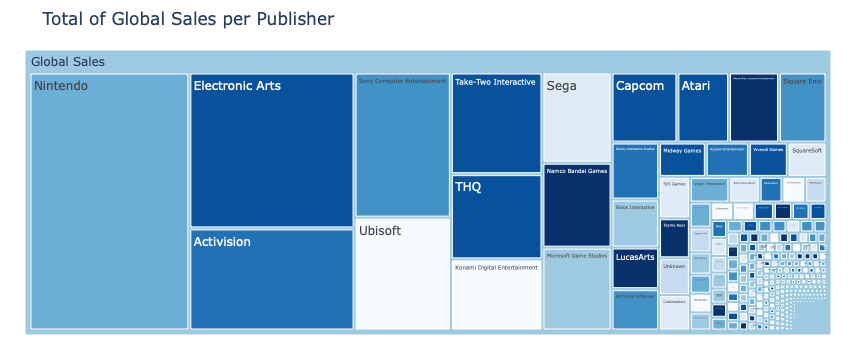

In [185]:
fig = px.treemap(df, path = [px.Constant("Global Sales"), 'Publisher'], values = 'Global_Sales',
                title = "Total of Global Sales per Publisher",
                color = 'Publisher', color_discrete_sequence = px.colors.sequential.Blues_r)
fig.update_traces(root_color = "blue")
fig.update_layout(margin = dict(t = 50, l = 25, r = 25, b = 25))
fig.show()

#### Part 2: 8 Total of Global Sales per Publisher by Name

Next, as before, the method "groupby" was used to group the Publishers and Name by Global_Sales and check the first 5 popular publishers and Game Names.

In [186]:
df.groupby(["Publisher", "Name"])["Global_Sales"].sum().nlargest()

Publisher             Name              
Nintendo              Wii Sports            82.53
Take-Two Interactive  Grand Theft Auto V    56.57
Nintendo              Super Mario Bros.     45.31
                      Tetris                35.84
                      Mario Kart Wii        35.52
Name: Global_Sales, dtype: float64

Next used a "treemap" to plot the results, but the commands below were left commented out because the document was getting heavier with the amount of views used from the "Ploply" library, although a screenshot was taken and left it below for viewing.

In [187]:
# fig = px.treemap(df, path = [px.Constant("Global Sales"), 'Publisher', 'Name'], values = 'Global_Sales',
#                 title = "Total of Global Sales per Publisher by Name")
# fig.update_traces(root_color = "lightblue")
# fig.update_layout(margin = dict(t = 50, l = 25, r = 25, b = 25))
# fig.show()

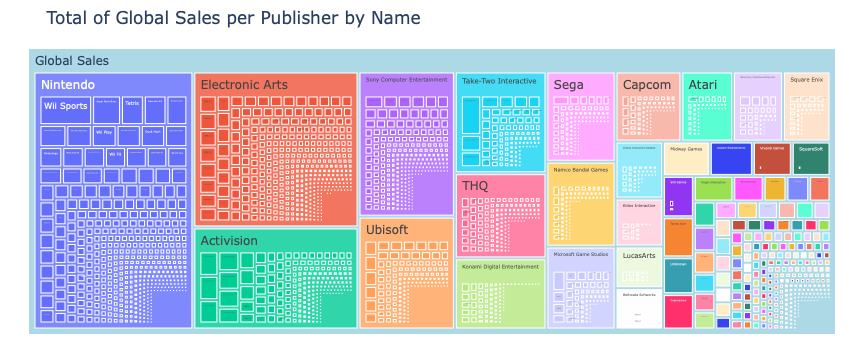
Screenshot of Total of Global Sales per Publisher by Name

#### Part 2: 9 Total of EU Sales per Publisher by Genre and Name

Next, as before, the method "groupby" was used to group the Publishers and Name by EU_Sales and check the first 5 popular publishers, genres and Game Names.

In [188]:
df.groupby(["Publisher", "Genre", "Name"])["EU_Sales"].sum().nlargest()

Publisher             Genre    Name                          
Nintendo              Sports   Wii Sports                        28.96
Take-Two Interactive  Action   Grand Theft Auto V                23.42
Nintendo              Racing   Mario Kart Wii                    12.76
Electronic Arts       Sports   FIFA 15                           12.02
Activision            Shooter  Call of Duty: Modern Warfare 3    11.15
Name: EU_Sales, dtype: float64

Next used a "treemap" to plot the results

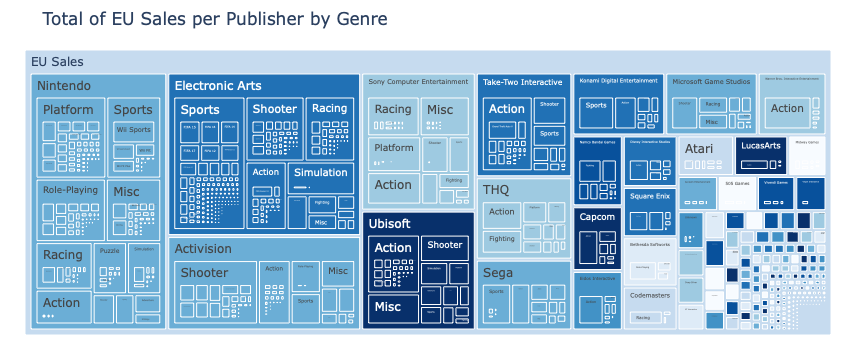

In [189]:
fig = px.treemap(df, path = [px.Constant("EU Sales"), 'Publisher', 'Genre', 'Name'], values = 'EU_Sales',
                title = "Total of EU Sales per Publisher by Genre",
                color = 'Publisher', color_discrete_sequence = px.colors.sequential.Blues)
fig.update_traces(root_color = "lightblue")
fig.update_layout(margin = dict(t = 50, l = 25, r = 25, b = 25))
fig.show()

#### Part 2: 10 Total of EU Sales per Publisher by Platform, Genre and Name

Next, as before, the method "groupby" was used to group the Publishers and Name by EU_Sales and check the first 5 popular publishers, platforms, genres and Game Names.

In [190]:
df.groupby(["Publisher", "Platform", "Genre", "Name"])["EU_Sales"].sum().nlargest()

Publisher  Platform  Genre       Name                                        
Nintendo   Wii       Sports      Wii Sports                                      28.96
                     Racing      Mario Kart Wii                                  12.76
           DS        Simulation  Nintendogs                                      10.95
           Wii       Sports      Wii Sports Resort                               10.93
           DS        Misc        Brain Age: Train Your Brain in Minutes a Day     9.20
Name: EU_Sales, dtype: float64

Next used a "treemap" to plot the results, but the commands below were left commented out because the document was getting heavier with the amount of views used from the "Ploply" library, although a screenshot was taken and left it below for viewing.

In [191]:
# fig = px.treemap(df, path = [px.Constant("EU Sales"), 'Publisher', 'Platform', 'Genre', 'Name'], values = 'EU_Sales',
#                 title = "Total of EU Sales per Publisher by Platform, Genre and Name")
# fig.update_traces(root_color = "lightblue")
# fig.update_layout(margin = dict(t = 50, l = 25, r = 25, b = 25))
# fig.show()

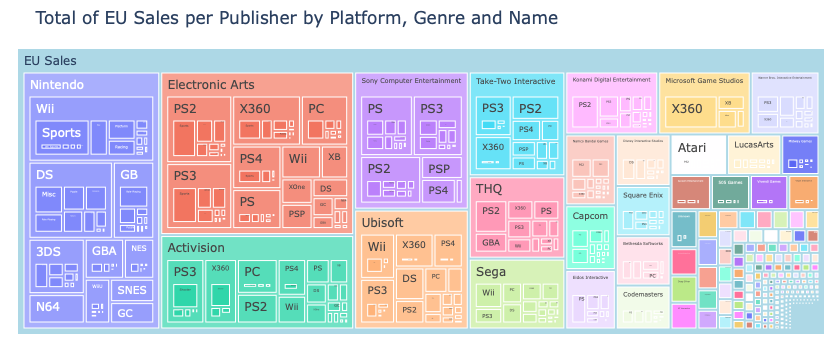
Screenshot of Total of EU Sales per Publisher by Platform, Genre and Name

#### Part 2: 11 Total of Critic Score per Publisher by Platform, Genre and Name

Next, as before, the method "groupby" was used to group the Publishers and Name by Critic_Score and check the first 5 popular publishers, platforms, genres and Game Names.

In [192]:
df.groupby(["Publisher", "Platform", "Genre", "Name"])["Critic_Score"].sum().nlargest()

Publisher           Platform  Genre     Name                       
Electronic Arts     PS3       Sports    Madden NFL 13                  166
                    X360      Racing    Need for Speed: Most Wanted    166
                    PC        Racing    Need for Speed: Most Wanted    164
Activision          PS        Sports    Tony Hawk's Pro Skater 2        98
Namco Bandai Games  DC        Fighting  SoulCalibur                     98
Name: Critic_Score, dtype: int64

Next used a "treemap" to plot the results, but the commands below were left commented out because the document was getting heavier with the amount of views used from the "Ploply" library, although a screenshot was taken and left it below for viewing.

In [193]:
# fig = px.treemap(df, path = [px.Constant("Critic Score"), 'Publisher', 'Platform', 'Genre', 'Name'], values = 'Critic_Score',
#                 title = "Total of Critic Score per Publisher by Platform, Genre and Name")
# fig.update_traces(root_color = "lightblue")
# fig.update_layout(margin = dict(t = 50, l = 25, r = 25, b = 25))
# fig.show()

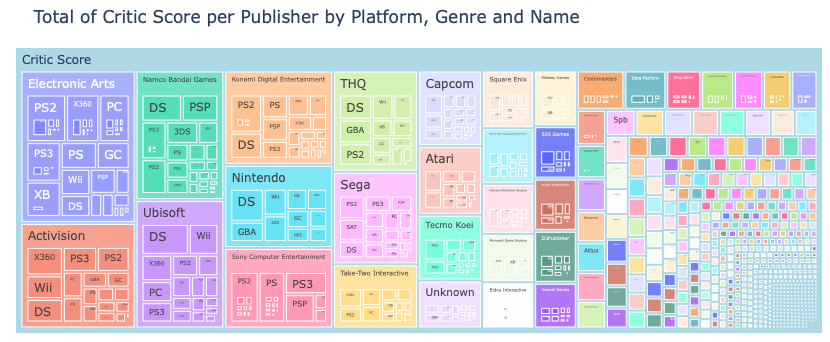
Screenshot of Total of EU Sales per Publisher by Platform, Genre and Name

#### Part 2: 12 What are the Eu Sales total per Genre 

Next, as before, the method "groupby" was used to group the Publishers and Name by Critic_Score and check the first 5 popular publishers, platforms, genres and Game Names, and plotted it next in a graphic using "Plotly".

In [194]:
df.groupby("Genre")["EU_Sales"].sum().nlargest()

Genre
Action     519.13
Sports     376.79
Shooter    317.34
Racing     236.51
Misc       212.74
Name: EU_Sales, dtype: float64

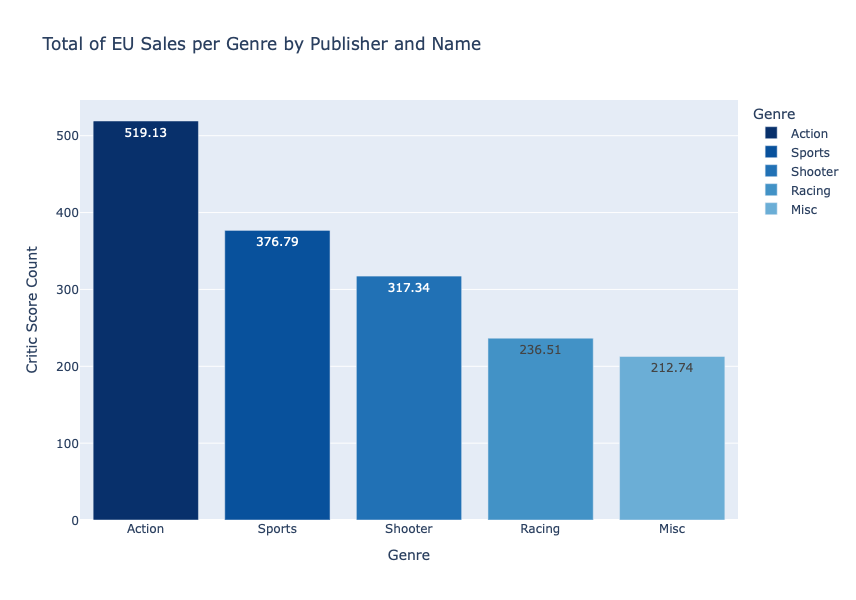

In [195]:
filter = df.groupby("Genre")["EU_Sales"].sum().nlargest().reset_index()

fig = px.bar(filter, x = "Genre", y = "EU_Sales", 
             text_auto ='.5', title = "Total of EU Sales per Genre by Publisher and Name",
             color = 'Genre', color_discrete_sequence = px.colors.sequential.Blues_r,
             height = 600)

fig.update_layout(xaxis_title = "Genre", yaxis_title = "Critic Score Count")
fig.show()

Next used a "treemap" to plot the results, but the commands below were left commented out because the document was getting heavier with the amount of views used from the "Ploply" library, although a screenshot was taken and left it below for viewing.

In [196]:
# fig = px.treemap(df, path = [px.Constant("EU Sales"), 'Genre'], values = 'EU_Sales',
#                 title = "Total of EU Sales per Genre by Publisher and Name",
#                 color = 'Genre', color_discrete_sequence = px.colors.sequential.Blues_r)
# fig.update_traces(root_color = "lightblue")
# fig.update_layout(margin = dict(t = 50, l = 25, r = 25, b = 25))
# fig.show()

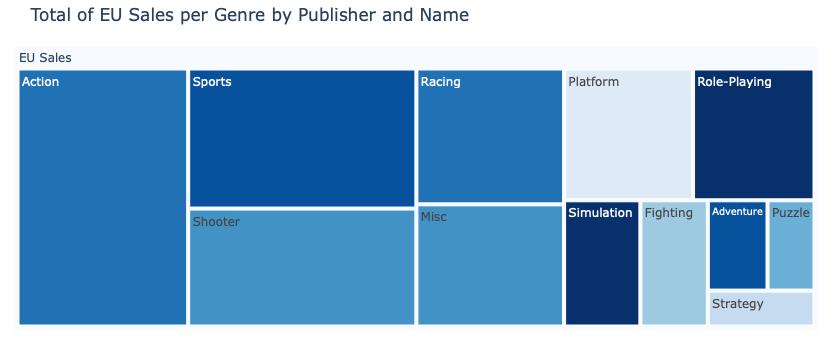
Screenshot of the Eu Sales total per Genre

#### Part 2: 13 What is the distribution of the most popular genres, by Critic Score, Critic Count, User Score and User Count 

To get this answer it was used a "pie chart". The critics' Rating of the Game by Gender using the "Critic_Score" feature, results are Action, Sports, Misc, Role-Playing, Shooter and so on.

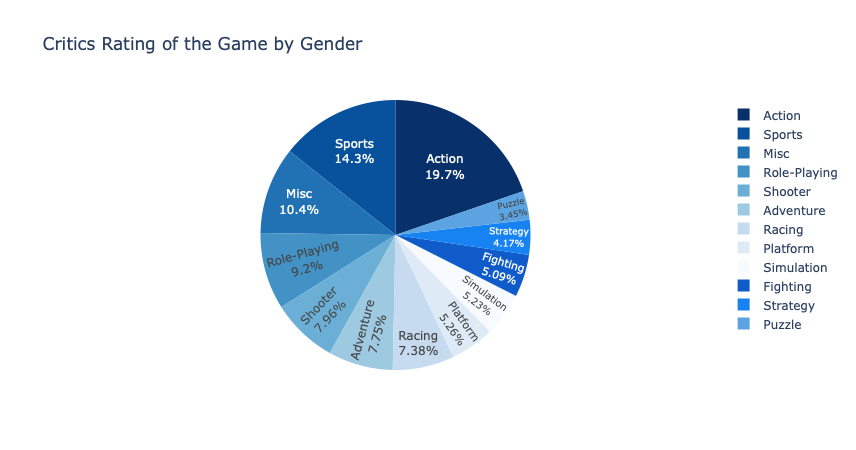

In [197]:
filter = df.groupby("Genre")["Critic_Score"].sum().to_dict()

fig = px.pie(values = filter.values(), names = filter.keys(), 
             color_discrete_sequence = px.colors.sequential.Blues_r,
             title = "Critics Rating of the Game by Gender", 
             height = 450)
fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.show()

To get this answer it was used a "pie chart". The Number of Critics who rated the game by Gender using the "Critic_Count" feature, results are Action, Sports, Shooter, Role-Playing, Misc and so on.

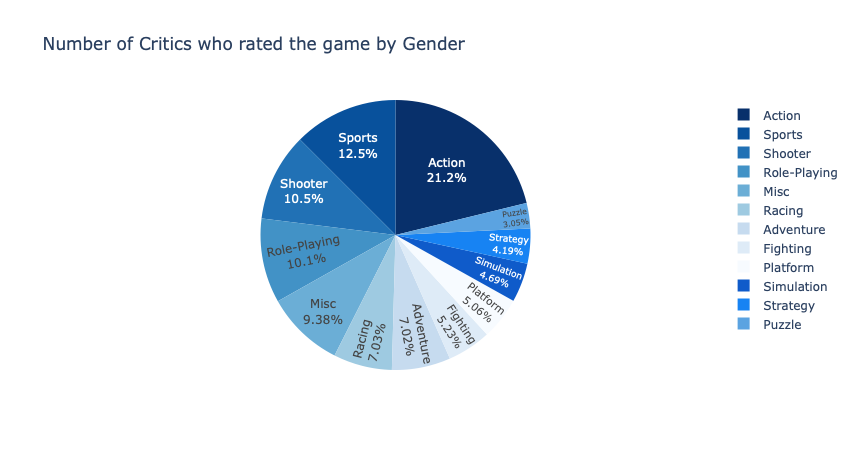

In [198]:
filter = df.groupby("Genre")["Critic_Count"].sum().to_dict()

fig = px.pie(values = filter.values(), names = filter.keys(), 
             color_discrete_sequence = px.colors.sequential.Blues_r,
             title = "Number of Critics who rated the game by Gender", 
             height = 450)
fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.show()

To get this answer it was used a "pie chart". Users Rating of the Game by Gender using the "User_Score" feature, results are Action, Sports, Misc, Role-Playing, Adventure and so on.

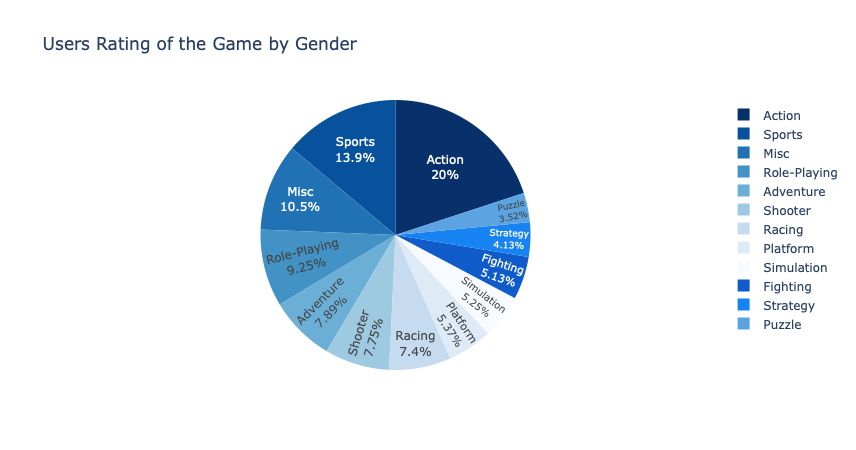

In [199]:
filter = df.groupby("Genre")["User_Score"].sum().to_dict()

fig = px.pie(values = filter.values(), names = filter.keys(), 
             color_discrete_sequence = px.colors.sequential.Blues_r,
             title = "Users Rating of the Game by Gender", 
             height = 450)
fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.show()

To get this answer it was used a "pie chart". Number of Users who rated the game by Gender using the "User_Count" feature, results are Action, Shooter, Role-Playing, Sports, Strategy and so on.

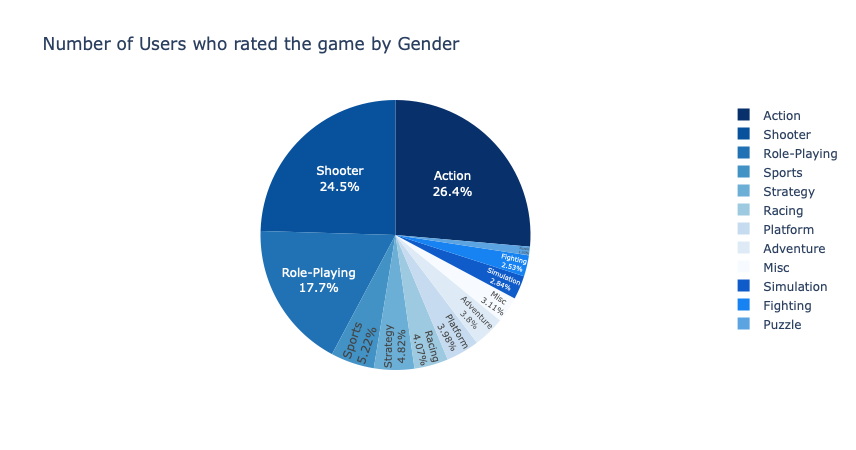

In [200]:
filter = df.groupby("Genre")["User_Count"].sum().to_dict()

fig = px.pie(values = filter.values(), names = filter.keys(), 
             color_discrete_sequence = px.colors.sequential.Blues_r,
             title = "Number of Users who rated the game by Gender", 
             height = 450)
fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
fig.show()

#### Part 2: 14 What is the distribution of the most popular "NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales", by Genre, Platform and Publisher

Create a for loop to show the distribution of the most popular "NA_Sales", "EU_Sales", "JP_Sales" and "Other_Sales", by Genre, Platform and Publisher, tried to create it side by side using "Subplots and Plotly Express" (plotlygraphs, 2019) with the method "go.Pie" but unfortunately without success.  

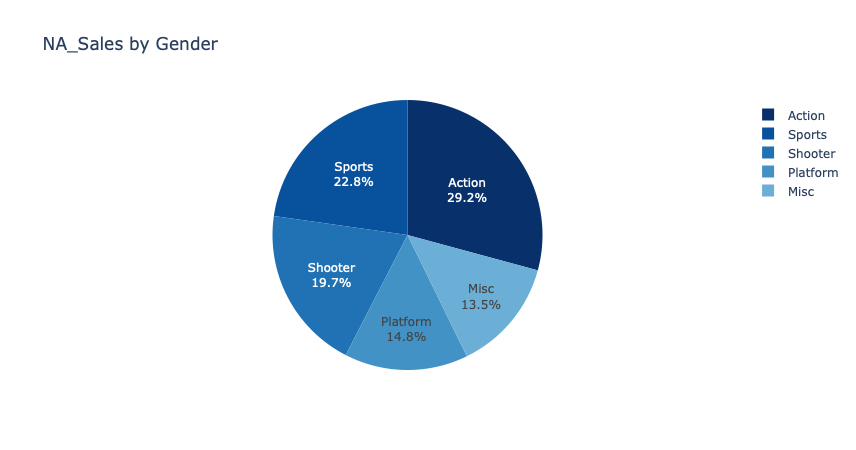

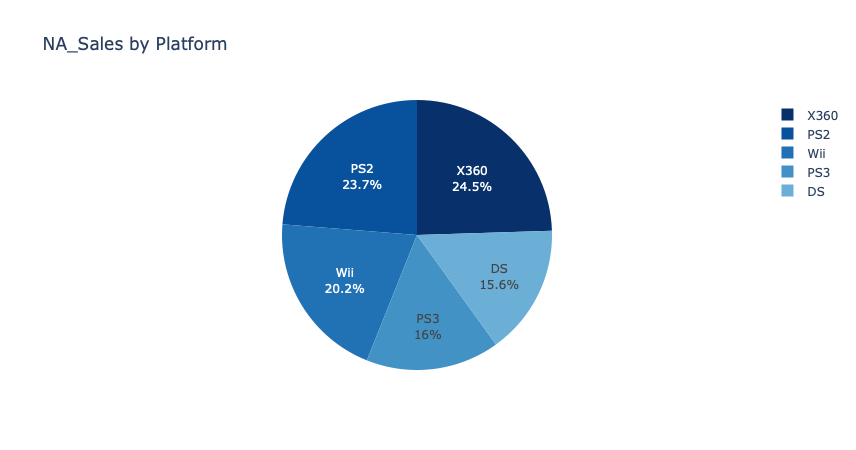

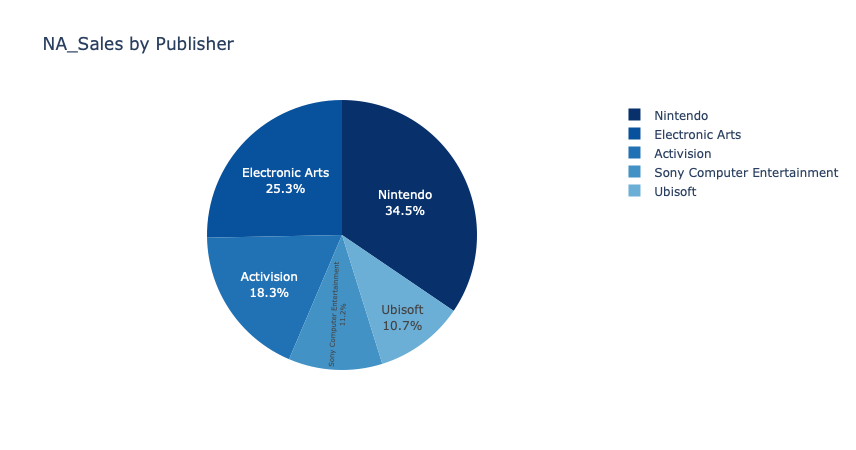

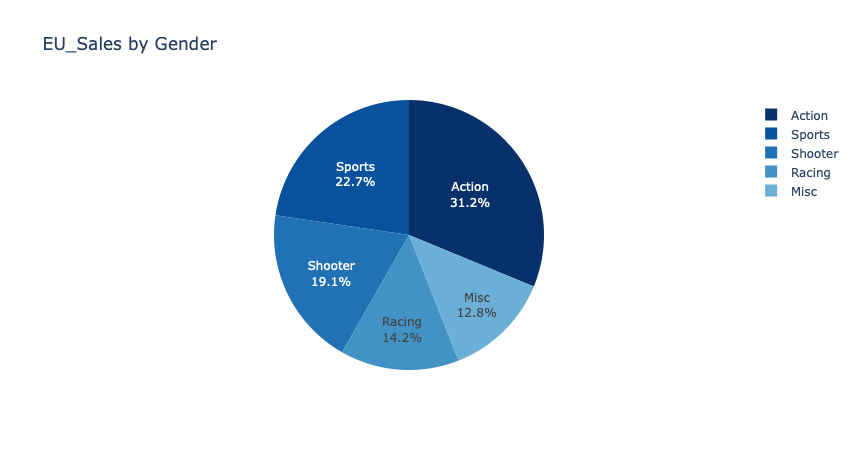

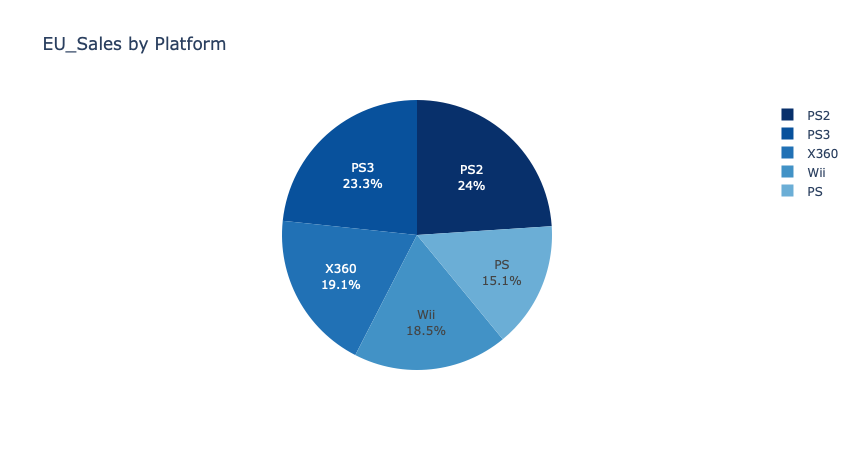

...

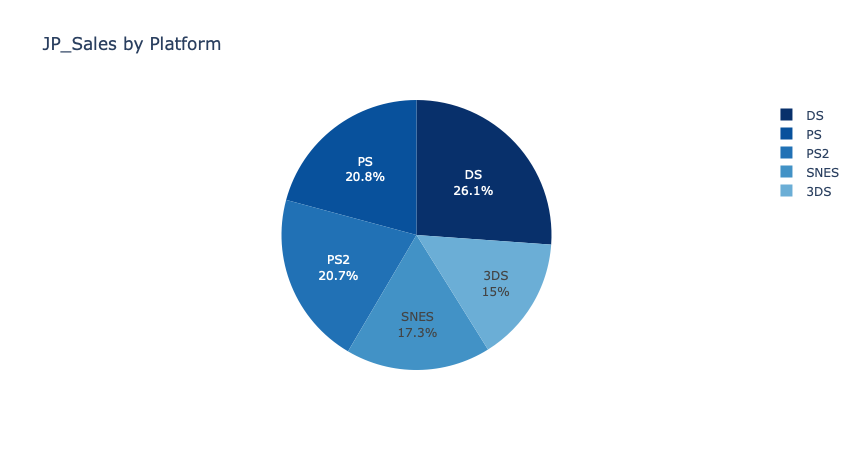

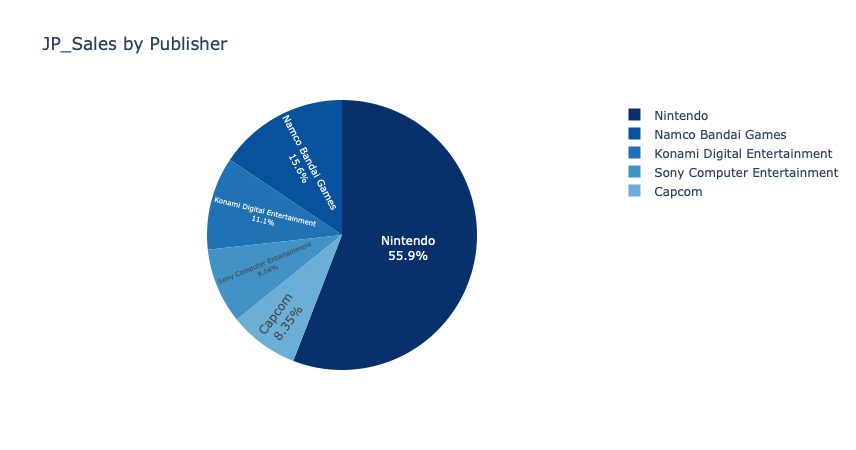

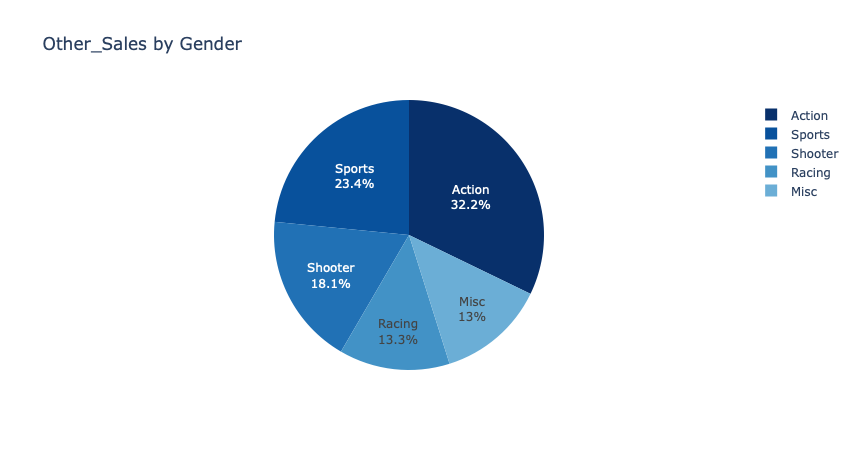

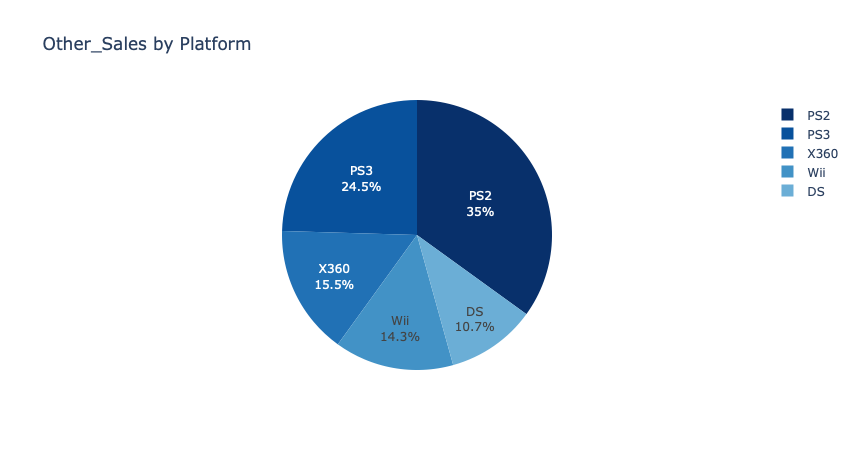

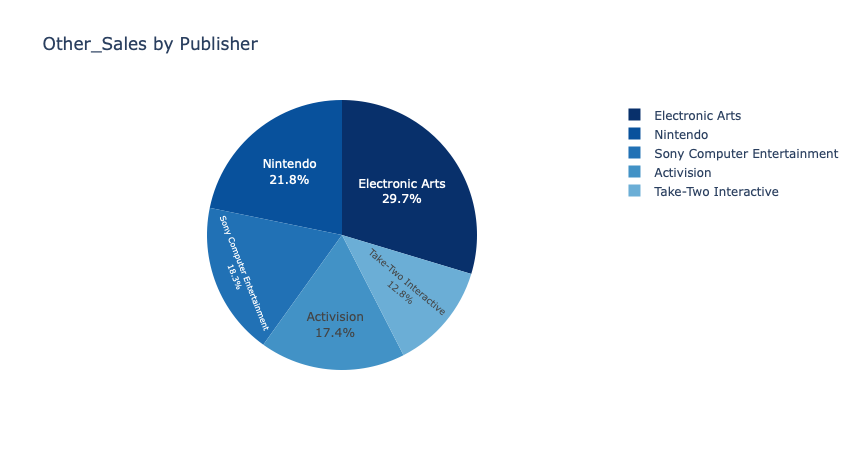

In [201]:
columns = ["NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales"]

for col in columns:
    # First plot
    filter = df.groupby("Genre")[col].sum().nlargest(5).to_dict()
    fig = px.pie(values = filter.values(), names = filter.keys(), 
                 color_discrete_sequence = px.colors.sequential.Blues_r,
                 title = col + " by Gender", 
                 height = 450)
    fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
    fig.show()

    # Second plot
    filter = df.groupby("Platform")[col].sum().nlargest(5).to_dict()
    fig = px.pie(values = filter.values(), names = filter.keys(), 
                 color_discrete_sequence = px.colors.sequential.Blues_r,
                 title = col + " by Platform", 
                 height = 450)
    fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
    fig.show()

    # Third plot
    filter = df.groupby("Publisher")[col].sum().nlargest(5).to_dict()
    fig = px.pie(values = filter.values(), names = filter.keys(), 
                 color_discrete_sequence = px.colors.sequential.Blues_r,
                 title = col + " by Publisher", 
                 height = 450)
    fig.update_traces(textposition = 'inside', textinfo = 'percent+label')
    fig.show()

### 3.6.3 Part 3: Data Visualisation

You must explain, in detail,
- why you chose the specific methods to engineer the data and how you achieved this in python (Part
1/Part 2)
- why you chose your specific visualizations to illustrate each answer (Part 1/Part 2)
- what design decisions you made for each visualization (for example, but not only: colour, font, titles,
size, text position, font size etc) (Part 1/Part 2)
- what your rationale is for the visualization created in Part 2 and how your question enhances the
information and insight gained in the scenario (Part 2)

#### Part 3: Why you chose the specific methods to engineer the data and how you achieved this in python (Part 1/Part 2)

The methods to engineer the data were chosen once it was necessary to answer questions from part 2. 

The first stage, it was loaded the data set in this document, inspected the data set analysing its shape, info, description, missing values, duplication, data type, checked unique values for each feature and an overview using "ProfileReport" from "ydata_profiling", after it, noticed that the data set has a large number of observations, there are missing values, no duplication between the observations, there are a few different values in the features not corresponded with the correct ones, outliers, also some data types it was no corresponding with the data dictionary due the missing values and floating point in numerical features.

In the second stage, it was created some data distribution visualisation using "distplot", "kdeplot", "hist plots", and "box plots" of the numerical features getting the skewed, mean, median and standard deviation values also created a visualisation for the categorical features using a "countplot" in bars, next it was checked the missing values of the features comparing the total of missing values and the total of real values, after that, analysed and dealt one by one of the features missing values or with some peculiarity, replacing values and inputting values, for some feature checked the distribution before and after imputation, after, dealt with data type of the features and converted to the correct ones, checked the outliers plotting a "boxplot" of specifics features and next a comparison with a "Box Plot", "Violin Plot" and "Strip Plot" but not dealt with them, left outliers values, once can be just a different, unusual value. 

Until here, all steps and analyses were essential to understand the data and prepare it to answer Part 2 and 3 of the Assessment task and keep it going, all new stuff when it was out of my knowledge was searched in Google search engine and sought for articles that could be useful to learn and answer the questions with explanations and examples, also checking all the time in the libraries documentation how to use the methods properly with their respective parameters.

New stuff like "nlargest", "query", "pearsonr", "shapiro", "groupby", "reset_index", "to_dict", etc., were the essential keys to answering the questions, a few previous CAs that had similarity about these parameters, but now they have been tested, learned and remembered a little more deeply, also a break, stopped to think, deep breath, drink water and analytical thinking were essential. 

The "nlargest" one of the most important of them to get the largest number of the features, "query" to create a condition easier than complicated command unions using pandas, "pearsonr" to check the correlation of two variables, "shapiro" to do the test and get the statistics values to plot in a Quantile-Quantile Plot, "groupby" to group categories, "reset_index" to reset the row index after creating a filter and not keep the previous index, otherwise it will be not possible to plot a graphical, "to_dict" essential to get the returned values after a filter and converted to a dictionary using Python to be able to plot a graphic, probably for each question there are n ways to answer them, but these were the forms achieved to obtain it.

#### Part 3: Why you chose your specific visualizations to illustrate each answer (Part 1/Part 2)

Normally, Bar Chart/Histogram are most commonly used to visualise amounts, distributions, proportions and so on, so in questions 1, 3, 4 and 5, the "Bar Charts" were essentially useful for this type of situation, in question 2 a "heatmap" to show the amounts by colour, "qqplot" to show points of the cumulative densities and the distribution, "scatter" to show a quantitative variable relative to another and "pairplot" showing a "scatter plot" and "bar chart" side by side, these combined were essential to understanding and answer the question, also a "Pie Chart" to show the proportions in the question 4 it was useful to answer the questions of part 1.

Part 2, basically was the same as Part 1, where normally the questions were about distributions, proportions, relationships and so on, for questions 1, 2, 3, 5 and 12 used a "Bar Chart/Histogram" to visualise amounts, questions 3, 13, 14 were used "Pie Chart" to show the proportions, question 4 was used a "Stacked Bars" to make a comparison, question 6 a "Scatter Plot" to check the points and relationships also a "Heatmap" was used to complete the answer and finally the questions 7, 8, 9, 10, 11 and 12 it was used a "Treemap" to visualise more complex distributions with hierarchy.

#### Part 3: What design decisions you made for each visualization (for example, but not only: colour, font, titles, size, text position, font size etc) (Part 1/Part 2)

About **Colours**, a Blue range was chosen to keep a pattern in the document normally, a standard graphic shows it in blue colour as well, so probably the team before creating them had analysed it and had chosen blue as the standard colour, also after some readings and analyses on the internet, it was set the blue as main one and instead to alternate between different colours in the same range of pallet like "green light", "blue little", "Pastel" and so on, it was decided to keep just one colour and alternate inside of this palette of range, also "A survey spanning 10 countries found that blue is the most popular "favorite color" for people globally, with men preferring blue more often than women (40% versus 24%, respectively, among subjects from the United States)." (Cherry, 2024).

The Blue colour, means "conservative and traditional", " feelings of calmness and relaxation", "sign of stability and reliability", "sadness or aloofness", "people are more productive and creative when working in blue rooms" (Cherry, 2024).

Cultural Meanings
- India: Blue represents truth, mercy, and love
- Latin America: Blue is associated with mourning, but also trust and tranquillity
- North America: Blue is soothing and signifies a trustworthy person or official business
- United Kingdom: Blue symbolizes tranquillity, dignity, and decorum
- Western European countries: Blue is truth, serenity, reliability, responsibility, and fidelity

Blue is acceptable in most of the world as a good colour to express feelings, meanings, cultural, spiritual, symbolic, psychological and so on, so in this case opted to keep a Blue range as a choice and when needed a red and yellow colour to create an emphasis to the graphic.

The blue colour for complexes Treemap was not very well displayed, so for some treemaps the default colouring was left.

About **Fonts**, opted to keep the standard font from the library and document, once it is already acceptable to read and understand, some fonts are different and need to be considered with a serif or not, sans serif typefaces, decorative typefaces and so on, fonts have a geometric and organic different standard, sometimes with 2-3 variations or more, but normally a classic family collection for the font to use in documents are: 
- Times New Roman
- Arial
- Calibri
- Verdana 

About **Titles**, it opted to keep the title text similar to the question to represent it when answered and also created a title for the graphics when possible.

About **Text Position**, the position of the text is standard normally at the top of the graphic as a title, below as an X reference and vertically as a Y reference.

About **Font size**, the font size used is also standard letting the user zoom in and zoom out if necessary.

About **Proportion** of the graphics: it was tried to keep them all in the same proportion, normally a height of 600px for Bar Charts, 400px for Scatter Plots and 450px for Pie Charts to keep them balanced. 

#### Part 3: What your rationale is for the visualization created in Part 2 and how your question enhances the information and insight gained in the scenario (Part 2)

After a long time of working on the data frame, enough knowledge about the data has been obtained to ask analytical questions, so a few questions were made, normally the questions are about distributions that were possible to understand important business issues that are not easily visualised just by looking at a table, for example: 
- What are the most popular genres that the company could focus more to create games in this style or create promotions to try to sell them, and so on; 
- What are the most games sold in the European market, also could focus on selling these games for this niche creating some promotions and consider to create new versions of these games; 
- The distribution of sales by regions showing which market buys more games;
- What is the main market of it to increase profit,
- What could be done to change for the other locations to be a good seller as well,
- How is the genres of the critic, how game genres are being viewed by users, the market and critics, as they are being accepted, it is worth continuing to update these managers, these games or unfortunately they will have to discontinue support for the games and stop selling them or create drastic changes for the better in the public's view;
- What platform is most used, which genders are most popular, with is the most popular publisher in North America, Japan, Europe and so on?

Then all used visualisations, "Bar Charts/Histograms”, “Pie Charts", ”Stacked Bars”, ”Scatter Plots", "Heatmap", and “Treemap" were fundamental to understanding and answering those doubts.

---

In addition to the assessment task, a free AI Writing Assistance Grammarly (Grammarly, 2009) is being used to help with English grammar while typing to check spelling. The project is available on this [link](https://github.com/CCT-Dublin/data-visualisation-techniques-ca1-CristhianMacedo2024104) and the complete URL is available on References (Macedo, 2024).

---

# Data Dictionary 

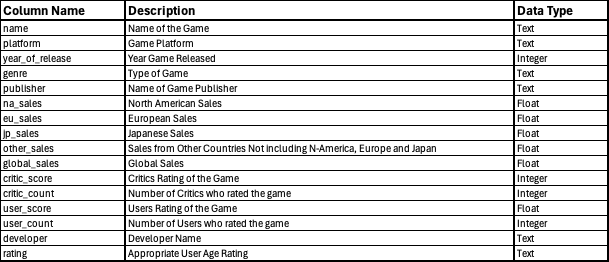

# References

Berukoff, T. (2023). Conquer Missing Data: Harnessing Pandas’ Techniques for Enhanced Analysis. [online] Medium. Available at: https://medium.com/@taylorberukoff/conquer-missing-data-harnessing-pandas-techniques-for-enhanced-analysis-5df017327ea5 [Accessed 11 Oct. 2024].

Cereniyim (2019). Distribution plot with mean and median. [online] GitHub Gist. Available at: https://gist.github.com/cereniyim/df1c8646411cc34eb9720a79400a200f [Accessed 10 Oct. 2024].

Cherry, K. (2024). The Color Blue: Meaning and Color Psychology. [online] Verywell Mind. Available at: https://www.verywellmind.com/the-color-psychology-of-blue-2795815 [Accessed 19 Oct. 2024].

DataCamp (2022). Python Details on Correlation Tutorial. [online] www.datacamp.com. Available at: https://www.datacamp.com/tutorial/tutorial-datails-on-correlation [Accessed 17 Oct. 2024].

Ford, C. (2015). Understanding QQ Plots | UVA Library. [online] library.virginia.edu. Available at: https://library.virginia.edu/data/articles/understanding-q-q-plots [Accessed 18 Oct. 2024].

GeeksforGeeks (2019). qqplot (Quantile-Quantile Plot) in Python. [online] GeeksforGeeks. Available at: https://www.geeksforgeeks.org/qqplot-quantile-quantile-plot-in-python/ [Accessed 18 Oct. 2024].

Grammarly (2009). Grammarly. [online] Grammarly.com. Available at: https://app.grammarly.com/ [Accessed 2024].

guest_blog (2020). Introduction to ANOVA for Statistics and Data Science. [online] Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2020/06/introduction-anova-statistics-data-science-covid-python/ [Accessed 17 Oct. 2024].

Ibezim, C. (2023). Using Contingency Tables to Find Associations Between Categorical Variables in Python. [online] Medium. Available at: https://medium.com/@ibezimchike/using-contingency-tables-to-find-associations-between-categorical-variables-in-python-2a2a4f14082d [Accessed 17 Oct. 2024].

Koehrsen, W. (2018). Histograms and Density Plots in Python. [online] Medium. Available at: https://towardsdatascience.com/histograms-and-density-plots-in-python-f6bda88f5ac0 [Accessed 11 Oct. 2024].

Kyner, T.J. (2021). Iterative Imputation with Scikit-learn. [online] Medium. Available at: https://towardsdatascience.com/iterative-imputation-with-scikit-learn-8f3eb22b1a38 [Accessed 11 Oct. 2024].

Macedo, C. (2024). Data Visualisation Techniques-ca1 Ft CristhianMacedo2024104. [online] GitHub. Available at: https://github.com/CCT-Dublin/data-visualisation-techniques-ca1-CristhianMacedo2024104 [Accessed 2024].

Mahadevan, M. (2022). Step-by-Step Exploratory Data Analysis (EDA) using Python -. [online] Analytics Vidhya. Available at: https://www.analyticsvidhya.com/blog/2022/07/step-by-step-exploratory-data-analysis-eda-using-python/ [Accessed 8 Oct. 2024].

mlexplained (2023). How To Calculate Correlation Among Categorical Variables? [online] ML EXPLAINED. Available at: https://mlexplained.blog/2023/01/23/how-to-calculate-correlation-among-categorical-variables/ [Accessed 17 Oct. 2024].

Naveen Nelamali (2021). Pandas Count The Frequency of a Value in Column. [online] Spark By {Examples}. Available at: https://sparkbyexamples.com/pandas/pandas-count-frequency-value-occurs-in-dataframe-column/ [Accessed Oct. 2024].

Naveen Nelamali (2022). Pandas GroupBy Multiple Columns Explained. [online] Spark By {Examples}. Available at: https://sparkbyexamples.com/pandas/pandas-groupby-multiple-columns/ [Accessed Oct. 2024].

nkmk.me (2023). pandas: Find rows/columns with NaN (missing values) | note.nkmk.me. [online] note.nkmk.me. Available at: https://note.nkmk.me/en/python-pandas-nan-extract/.

Plotly (2016). Bar. [online] Plotly.com. Available at: https://plotly.com/python/bar-charts/#bar-chart-with-plotly-express [Accessed 15 Oct. 2024].

Plotly (2019). Heatmaps. [online] plotly.com. Available at: https://plotly.com/python/heatmaps/ [Accessed 17 Oct. 2024].

Plotly (2024a). plotly.express.colors package — 5.24.1 documentation. [online] Plotly.com. Available at: https://plotly.com/python-api-reference/generated/plotly.express.colors.html [Accessed 19 Oct. 2024].

Plotly (2024b). Scatter Plots. [online] plotly.com. Available at: https://plotly.com/python/line-and-scatter/ [Accessed 17 Oct. 2024].

Plotly (2024c). Treemap. [online] plotly.com. Available at: https://plotly.com/python/treemaps/ [Accessed 18 Oct. 2024].

plotlygraphs (2019). Subplots. [online] plotly.com. Available at: https://plotly.com/python/subplots/ [Accessed 20 Oct. 2024].

Polat, E.I. (2022). Hypothesis Testing with Python: Step by step hands-on tutorial with practical examples. [online] Medium. Available at: https://towardsdatascience.com/hypothesis-testing-with-python-step-by-step-hands-on-tutorial-with-practical-examples-e805975ea96e [Accessed 17 Oct. 2024].

Sanjushusanth (2023). Missing Value Imputation Techniques in Python :) - Sanjushusanth - Medium. [online] Medium. Available at: https://medium.com/@sanjushusanth/missing-value-imputation-techniques-in-python-62aeab65a6a6 [Accessed 11 Oct. 2024].

scikit-learn developers (2024). SimpleImputer. [online] scikit-learn. Available at: https://scikit-learn.org/1.5/modules/generated/sklearn.impute.SimpleImputer.html [Accessed 17 Oct. 2024].

Scipy (2019). scipy.stats.pearsonr — SciPy v1.3.2 Reference Guide. [online] Scipy.org. Available at: https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.pearsonr.html [Accessed 17 Oct. 2024].

The Matplotlib Development Team (2024). matplotlib.pyplot.axvline — Matplotlib 3.8.4 documentation. [online] matplotlib.org. Available at: https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.axvline.html#matplotlib.pyplot.axvline [Accessed 10 Oct. 2024].

The Pandas Development Team (2024a). pandas.DataFrame.dropna — pandas 1.3.1 documentation. [online] pandas.pydata.org. Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.dropna.html [Accessed 12 Oct. 2024].

The Pandas Development Team (2024b). pandas.DataFrame.index — pandas 1.5.3 documentation. [online] pandas.pydata.org. Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.index.html [Accessed Oct. 2024].

The Pandas Development Team (2024c). pandas.DataFrame.nlargest — pandas 1.2.4 documentation. [online] pandas.pydata.org. Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.nlargest.html.

The Pandas Development Team (2024d). pandas.DataFrame.query — pandas 1.4.3 documentation. [online] pandas.pydata.org. Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.query.html.

The Pandas Development Team (2024e). pandas.DataFrame.to_dict — pandas 1.4.3 documentation. [online] pandas.pydata.org. Available at: https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.to_dict.html [Accessed Oct. 2024].

Yu, V.A. (2020). 5 Ways to Visualize Missing Data - Van Arloe Yu - Medium. [online] Medium. Available at: https://vanarloeyu.medium.com/5-ways-to-visualize-missing-data-4d5dc1cd081b [Accessed 12 Oct. 2024].